## 04 - Evaluate Hopx-MACD and Hopx-derived traced cells
Combine data from IGO16318, IGO17402, and IGO17543 (traced and non-traced cohorts) to evaluate Hopx-derived cells

In [75]:
import numpy as np
import pandas as pd
import scanpy as sc
from joblib import dump, load

import math
import matplotlib
from matplotlib import pyplot as plt

from pathlib import Path
import anndata

In [76]:
plt.rcParams['svg.fonttype'] = 'none'
plt.rcParams["font.family"] = "Arial"
#plt.rcParams['figure.figsize'] = (3,4)

In [77]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white')
np.random.seed(1573)   #fix so we can reproduce later

In [78]:
Path("./figures").mkdir(parents=True, exist_ok=True) # generate figures here
Path("./write").mkdir(parents=True, exist_ok=True) # write h5ad here

## Define scoring Functions

In [79]:
# Score Cluster 5 cells
import csv
clusters = {}
clusterkeys = []
HPCS = False

def resetClusters(hpcs = 'cell2020'):
    clusters = {}
    clusterkeys = []
    HPCS = False
    try:
        if hpcs == 'cell2020':         
            with open('../common_files/clusters_cell2020.csv',encoding='utf-8-sig') as csvfile:
                csvreader = csv.reader(csvfile, delimiter=",")
                for row in csvreader:
                    clusters[row[0]] = [x for x in row[1:] if x != '']
            for i in range(1,13):
                #if i == 9: continue
                clusterkeys.append('Cluster %i' % i)
            HPCS = 'Cluster 5'
        else:
            raise ValueError
    except ValueError:
        print("%s is an invalid choice" % hpcs)
        raise
    return (clusters, clusterkeys, HPCS)

(clusters, clusterkeys, HPCS) = resetClusters('cell2020')

In [80]:
(clusters, clusterkeys, HPCS) = resetClusters('cell2020')

In [81]:
def scoreAndPlot(ad, excludeList = None, groupby="Classification",rotation=90,numgenes=25,ctlgenes=25):
    #cmap = 'Reds' #colormap
    cmap = 'jet' #colormap
    if excludeList == None:
        for i in clusterkeys:
            if (numgenes > ctlgenes):
                ctlgenes = numgenes
            sc.tl.score_genes(ad, clusters[i][0:numgenes],score_name="%s" % i, ctrl_size=ctlgenes)
  
        sc.pl.umap(ad, color=clusterkeys, color_map=cmap)
        sc.pl.dotplot(ad, clusterkeys, groupby=groupby, swap_axes=True)

In [82]:
from scipy.stats import ranksums

def HPCSViolinPlot(ad, cluster='0', groupby='leiden', score='Cluster5', save=None, singleGene=False):
    ad.obs['Cl5'] = 'not HPCS'
    ad.obs.loc[ad.obs[groupby].isin([cluster]), 'Cl5'] = 'HPCS'

    if singleGene:
        pvalue = ranksums(ad[ad.obs['Cl5'].isin(['HPCS'])][:,score].X.toarray(),ad[~ad.obs['Cl5'].isin(['HPCS'])][:,score].X.toarray())[1]
    else:
        pvalue = ranksums(ad[ad.obs['Cl5'].isin(['HPCS'])].obs[score],ad[ad.obs['Cl5'].isin(['not HPCS'])].obs[score])[1]
    sc.pl.violin(ad, score, groupby='Cl5', xlabel = 'p = ' + str(pvalue), save=save)

## Load only traced cells

In [83]:
adata = anndata.read_h5ad('write/combined_data.h5ad')

In [84]:
adata.obs[['batch','Group']].value_counts(sort=False)

batch             Group             
traced            6wk_3d                  575
                  8wk                     742
                  12wk_3d                 877
                  14wk                    991
depletion         Saline                10763
untraced_14wk     KPT                    1865
Hopx-MACD         Hopx_GFP+mScarlet+     5661
                  Hopx_GFP+mScarlet-     4847
Hopx-MACD_traced  Hopx_12wk3d            1097
                  Hopx_12wk14d            911
Name: count, dtype: int64

In [85]:
alladata = adata
#adata2 = alladata[alladata.obs.batch.isin(['traced','untraced_14wk']),:].copy()
adata = adata[adata.obs.batch.isin(['Hopx-MACD','Hopx-MACD_traced']),:].copy()

## Explore Data

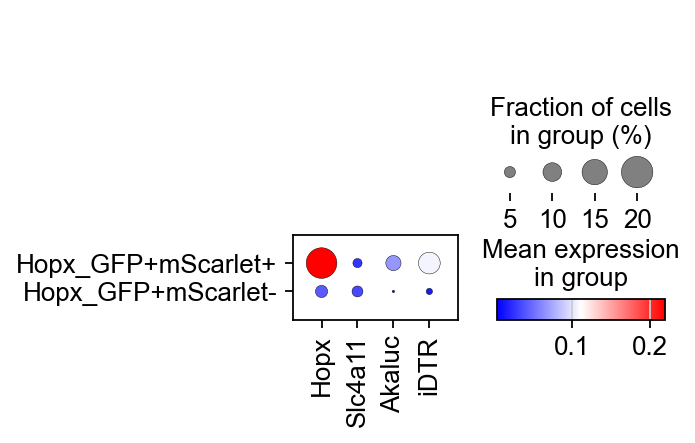

In [33]:
sc.pl.dotplot(adata[~adata.obs.Group.isin(['Hopx_12wk3d','Hopx_12wk14d']),:],['Hopx','Slc4a11','Akaluc','iDTR'],'Group',cmap='bwr')

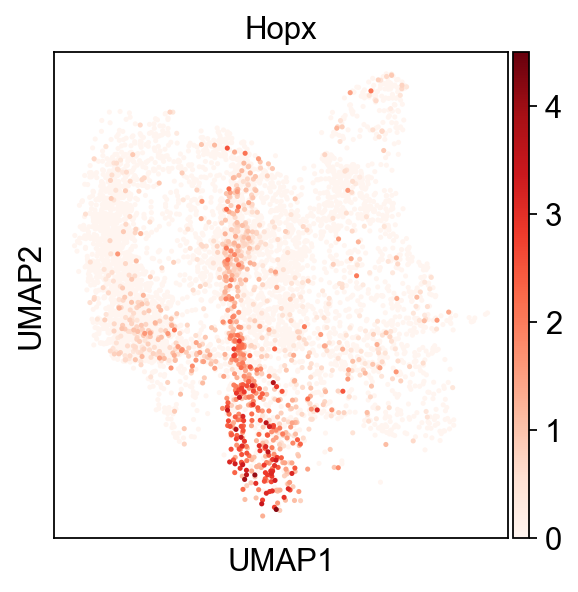

In [87]:
sc.pl.umap(adata[adata.obs.Group.isin(['Hopx_GFP+mScarlet+']),:], color=['Hopx'],cmap='Reds',vmax=4.5)

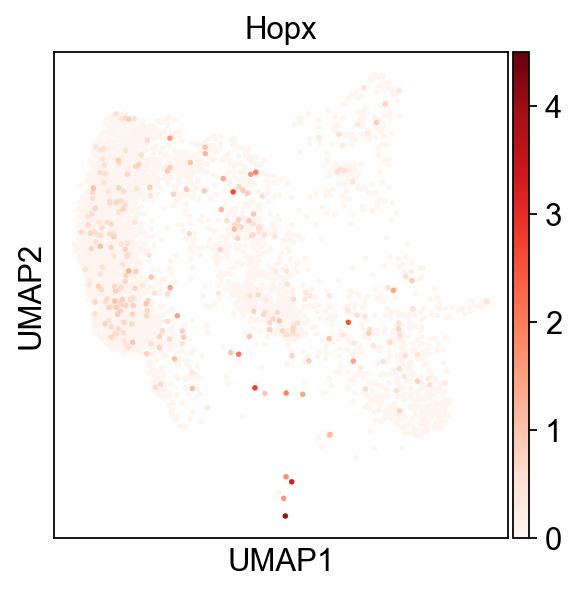

In [88]:
sc.pl.umap(adata[adata.obs.Group.isin(['Hopx_GFP+mScarlet-']),:], color=['Hopx'],cmap='Reds',vmax=4.5)

## Examine Groupings

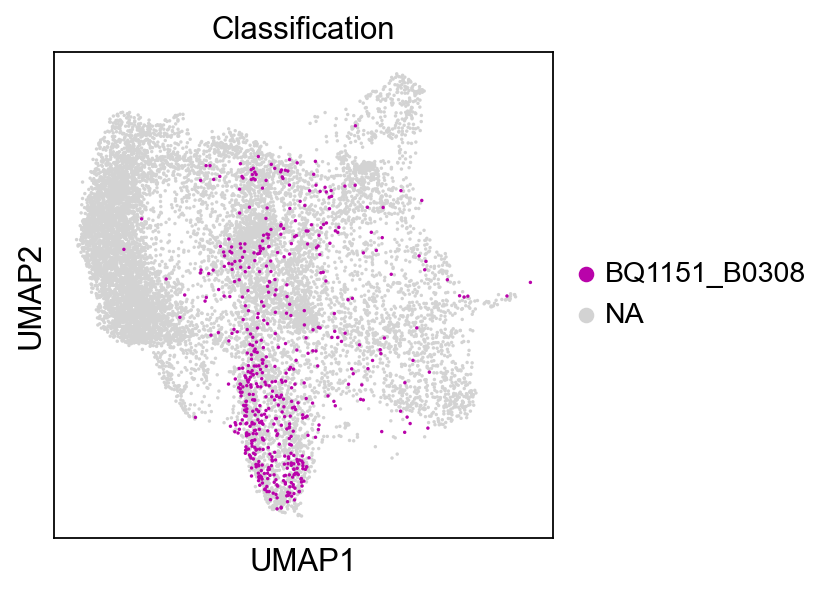

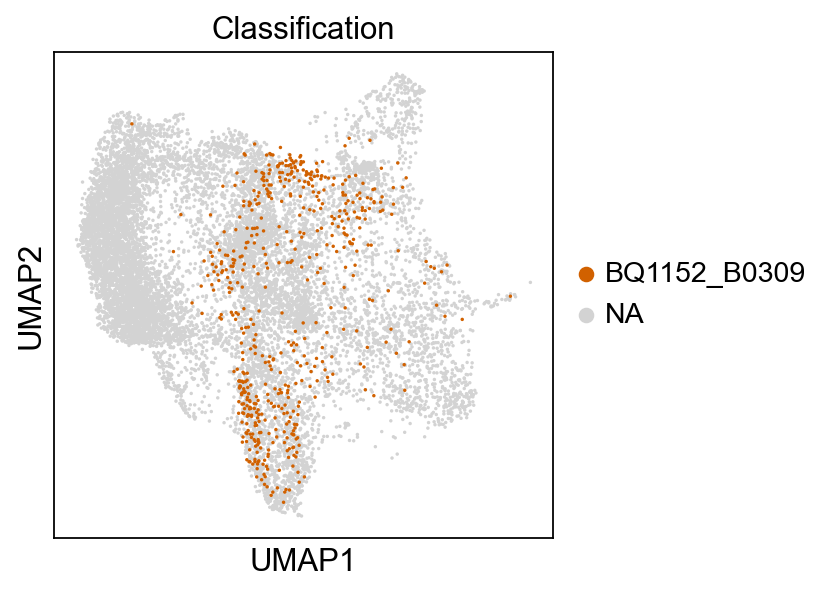

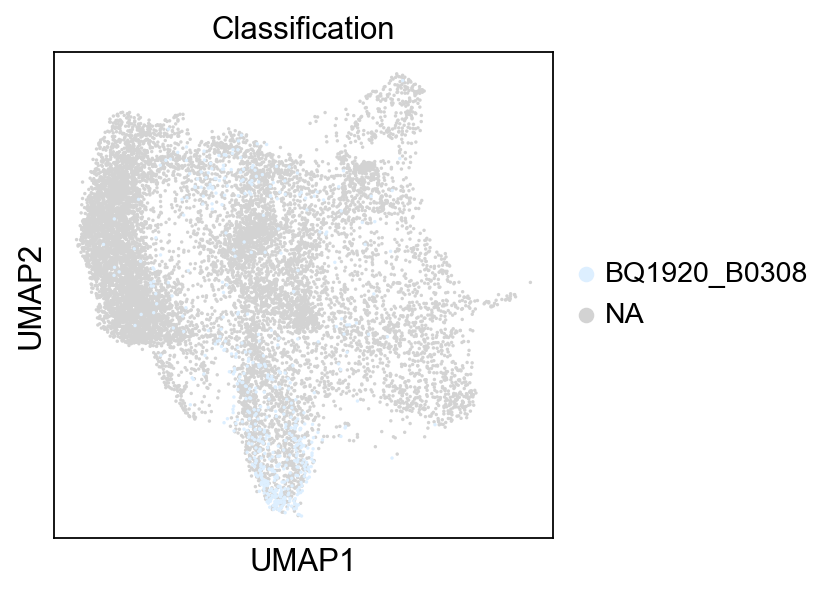

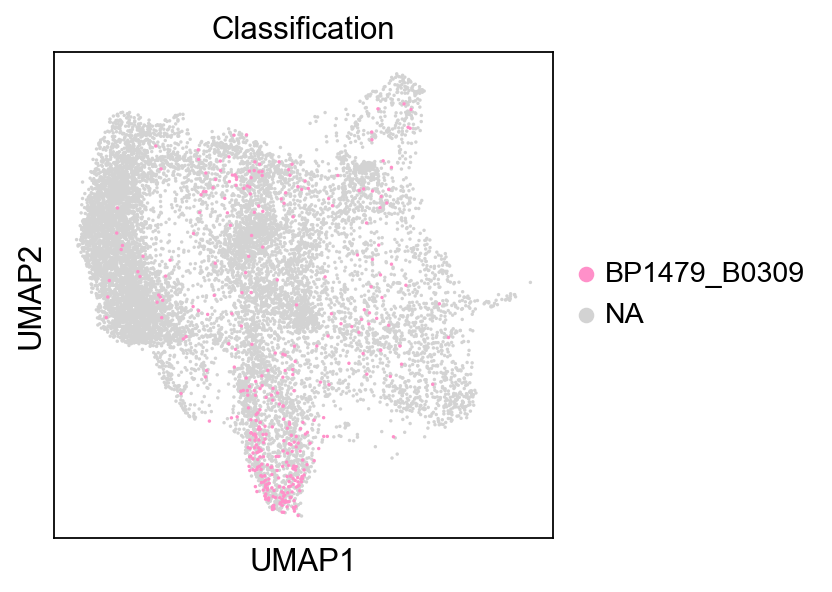

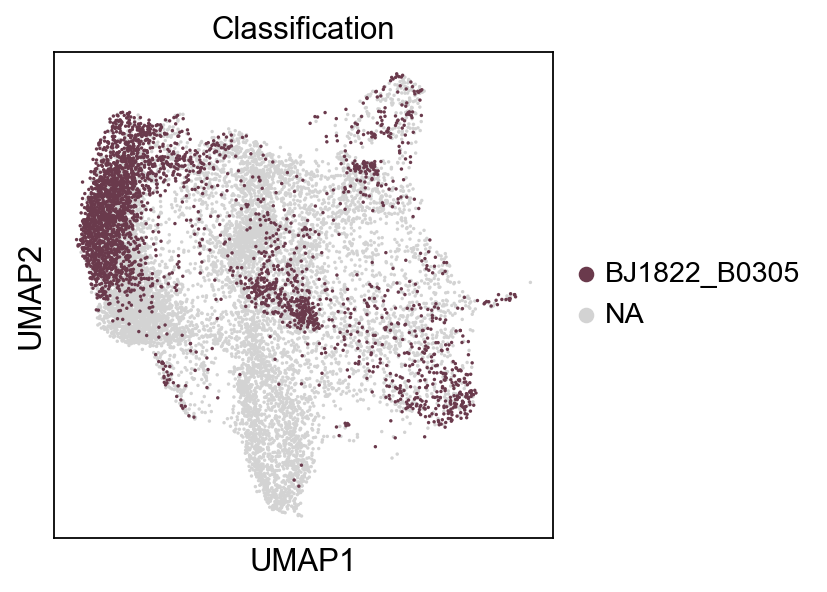

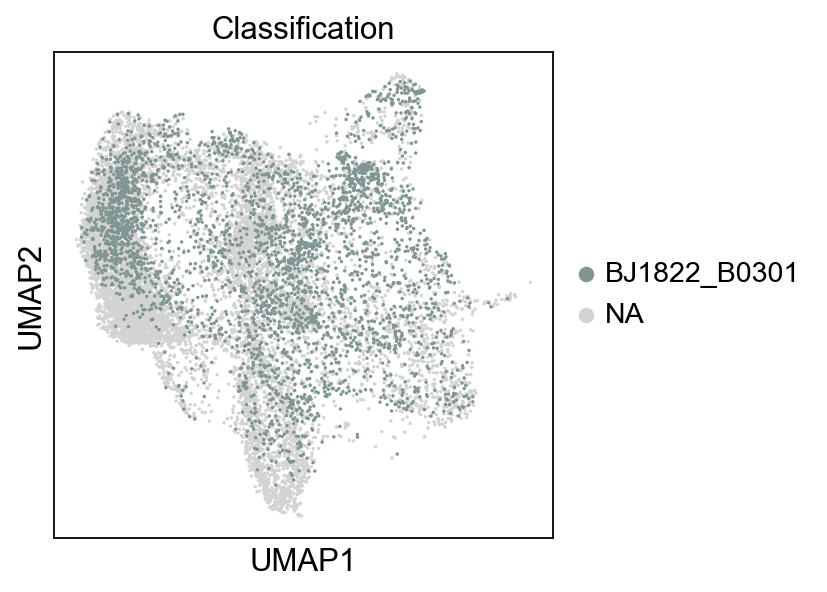

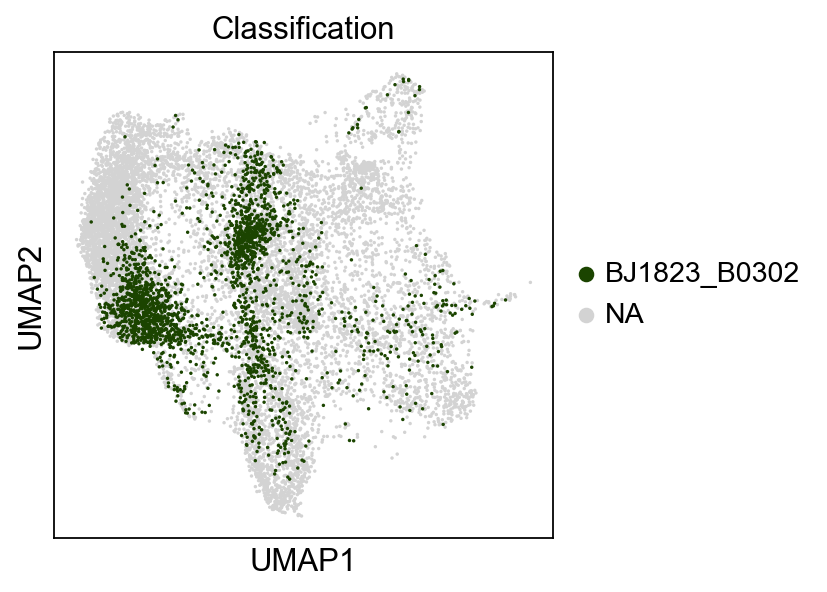

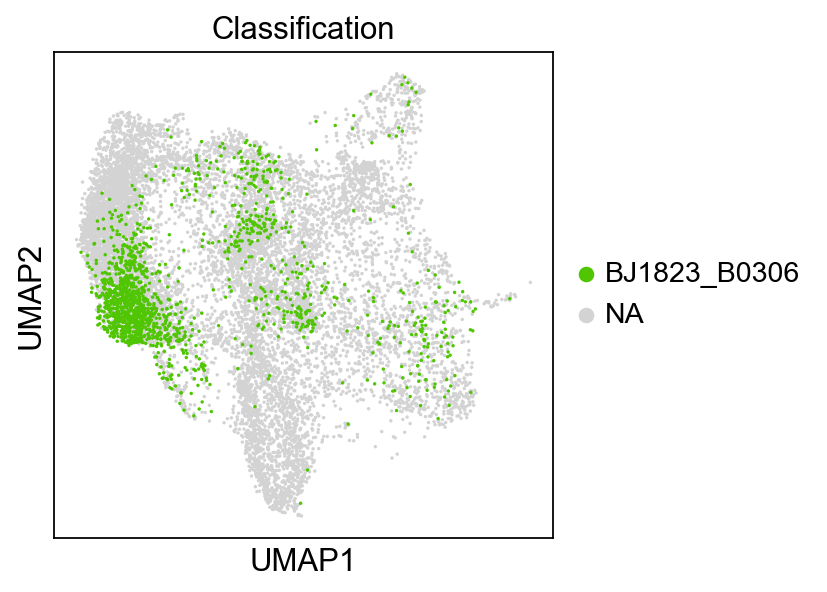

In [89]:
for label in adata.obs['Classification'].unique():
    sc.pl.umap(adata, color='Classification',groups=[label])

In [90]:
sc.tl.embedding_density(adata,basis='umap', groupby='Group')

computing density on 'umap'
--> added
    'umap_density_Group', densities (adata.obs)
    'umap_density_Group_params', parameter (adata.uns)


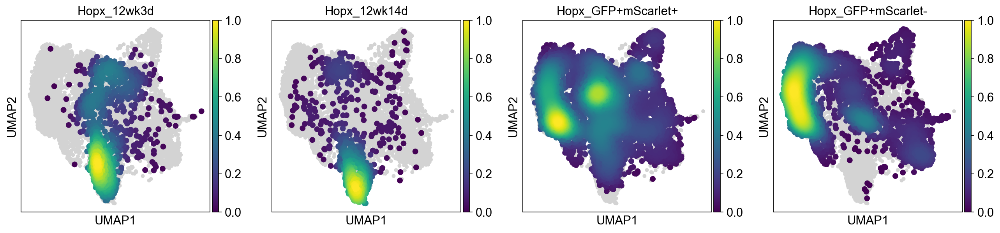

In [91]:
sc.pl.embedding_density(adata,basis='umap',key='umap_density_Group',color_map='viridis')

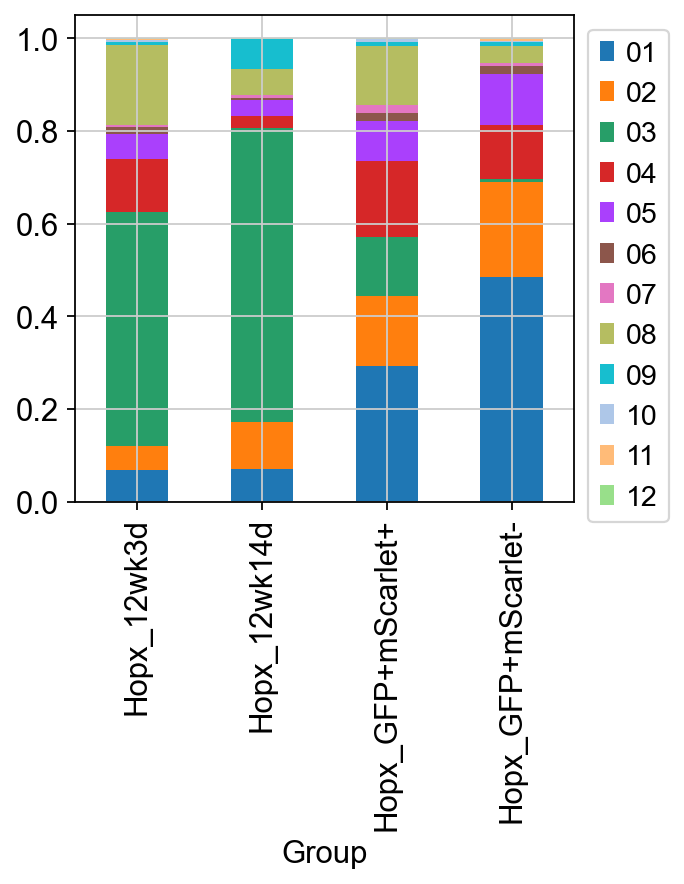

In [92]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12'],adata.obs['Group'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

In [93]:
adata.obs[['Group','Classification']].value_counts(sort=False)

Group               Classification
Hopx_12wk3d         BQ1151_B0308       546
                    BQ1152_B0309       551
Hopx_12wk14d        BP1479_B0309       361
                    BQ1920_B0308       550
Hopx_GFP+mScarlet+  BJ1822_B0301      3361
                    BJ1823_B0302      2300
Hopx_GFP+mScarlet-  BJ1822_B0305      3290
                    BJ1823_B0306      1557
Name: count, dtype: int64

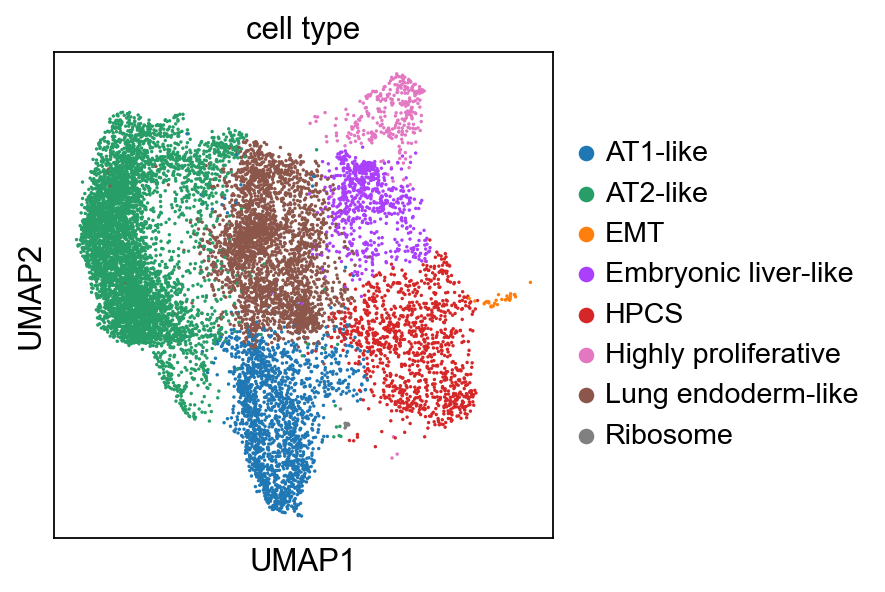

In [94]:
sc.pl.umap(adata, color=['cell type'])

In [95]:
adata.obs[['Group','Classification']].value_counts(sort=False)

Group               Classification
Hopx_12wk3d         BQ1151_B0308       546
                    BQ1152_B0309       551
Hopx_12wk14d        BP1479_B0309       361
                    BQ1920_B0308       550
Hopx_GFP+mScarlet+  BJ1822_B0301      3361
                    BJ1823_B0302      2300
Hopx_GFP+mScarlet-  BJ1822_B0305      3290
                    BJ1823_B0306      1557
Name: count, dtype: int64

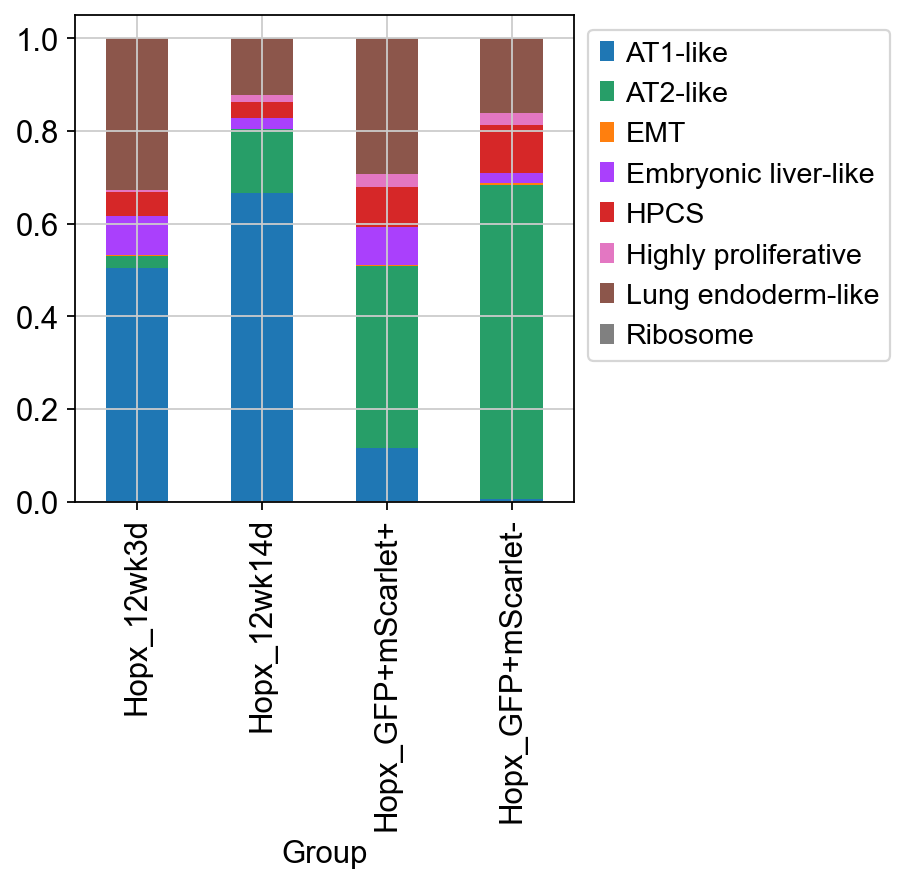

In [96]:
 cell_proportion_df = pd.crosstab(adata.obs['cell type'],adata.obs['Group'], normalize='columns').T.plot(kind='bar', stacked=True,color=adata.uns['cell type_colors']).legend(bbox_to_anchor=(1,1))

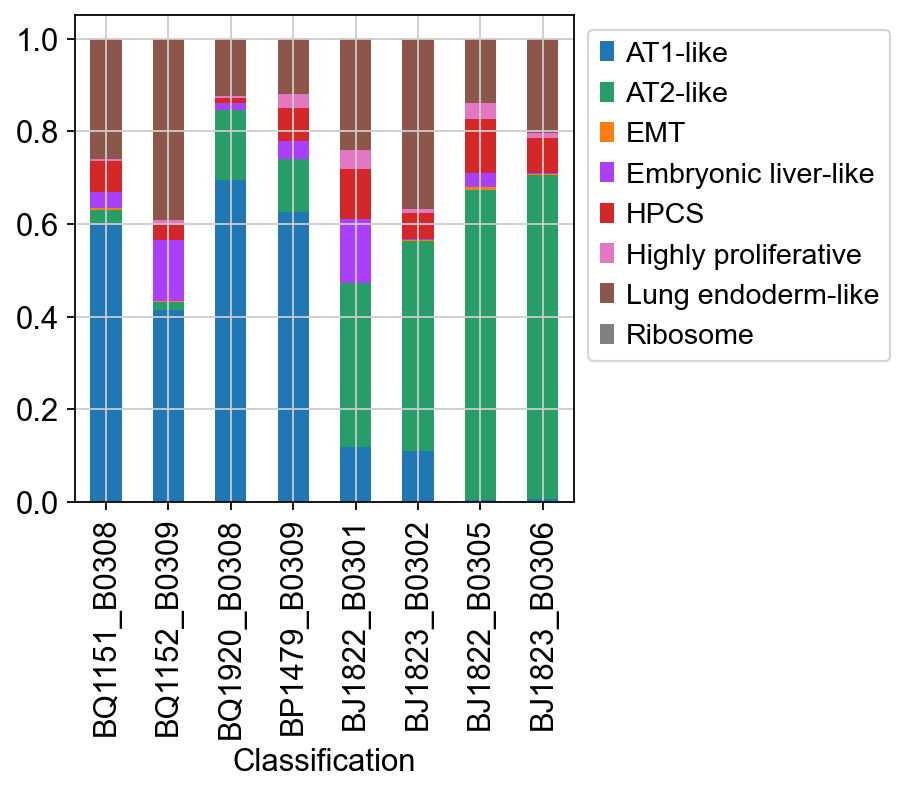

In [97]:
ordered = ['BQ1151_B0308','BQ1152_B0309', # Hopx 12wk 3d
           'BQ1920_B0308','BP1479_B0309', # Hopx 12wk 14d
           'BJ1822_B0301','BJ1823_B0302', # Hopx GFP+mScarlet+
           'BJ1822_B0305','BJ1823_B0306',] # Hopx GFP+mScarlet-
cell_proportion_df = pd.crosstab(adata.obs['cell type'],adata.obs['Classification'], normalize='columns')[ordered].T.plot(kind='bar', stacked=True, color=adata.uns['cell type_colors']).legend(bbox_to_anchor=(1,1))

In [98]:
sc.tl.embedding_density(adata,basis='umap', groupby='Classification')

computing density on 'umap'
--> added
    'umap_density_Classification', densities (adata.obs)
    'umap_density_Classification_params', parameter (adata.uns)


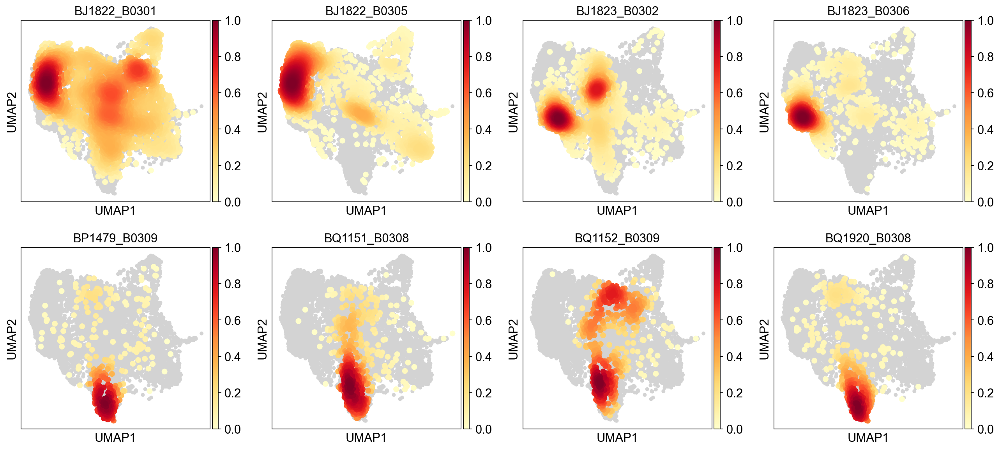

In [99]:
sc.pl.embedding_density(adata,basis='umap',key='umap_density_Classification')

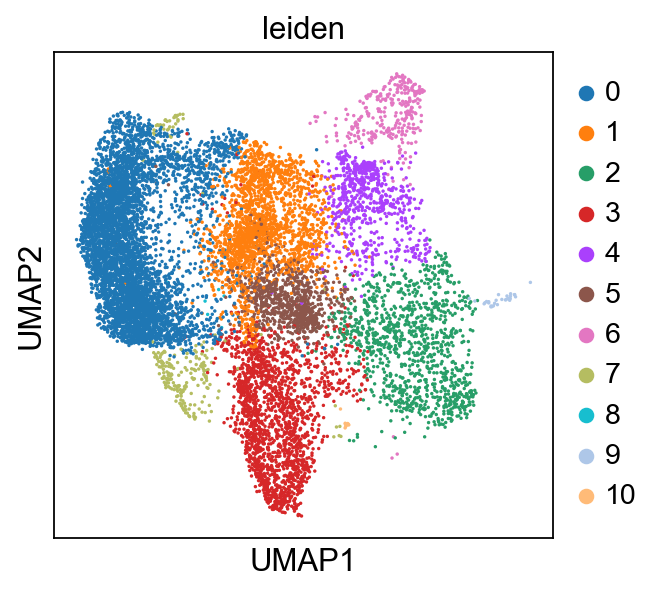

In [100]:
sc.pl.umap(adata, color=['leiden'])

## Evaluate rough clusters

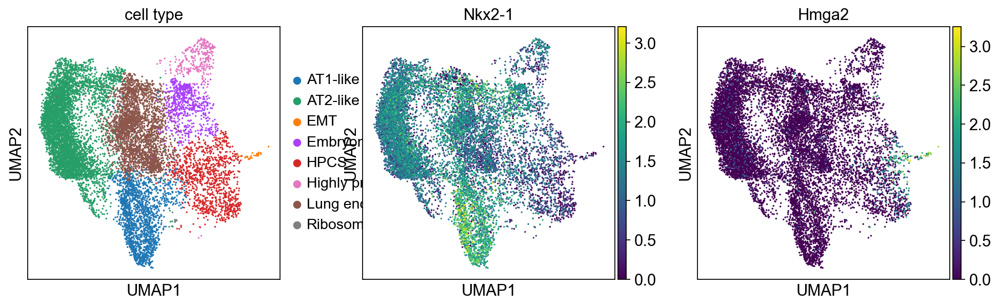

In [103]:
sc.pl.umap(adata, color=['cell type','Nkx2-1','Hmga2'])

## Figures for the paper

### Generate bar graph figures

In [104]:
adata.obs.Group.value_counts()

Group
Hopx_GFP+mScarlet+    5661
Hopx_GFP+mScarlet-    4847
Hopx_12wk3d           1097
Hopx_12wk14d           911
Name: count, dtype: int64

In [66]:
adata2 = adata[adata.obs.Group.isin(['Hopx_12wk14d']),:]

In [67]:
adata2.obs['AT1-like_cell'] = [1  if x == 'AT1-like' else 0 for x in adata2.obs['cell type']]

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_88501/1147376941.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata2.obs['AT1-like_cell'] = [1  if x == 'AT1-like' else 0 for x in adata2.obs['cell type']]


#### 14 week timepoints

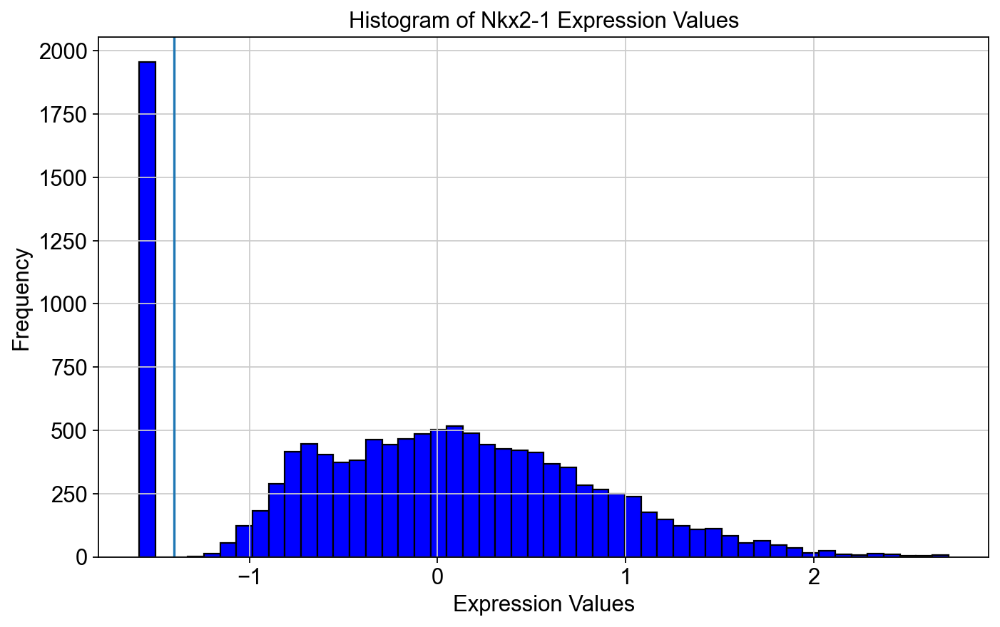

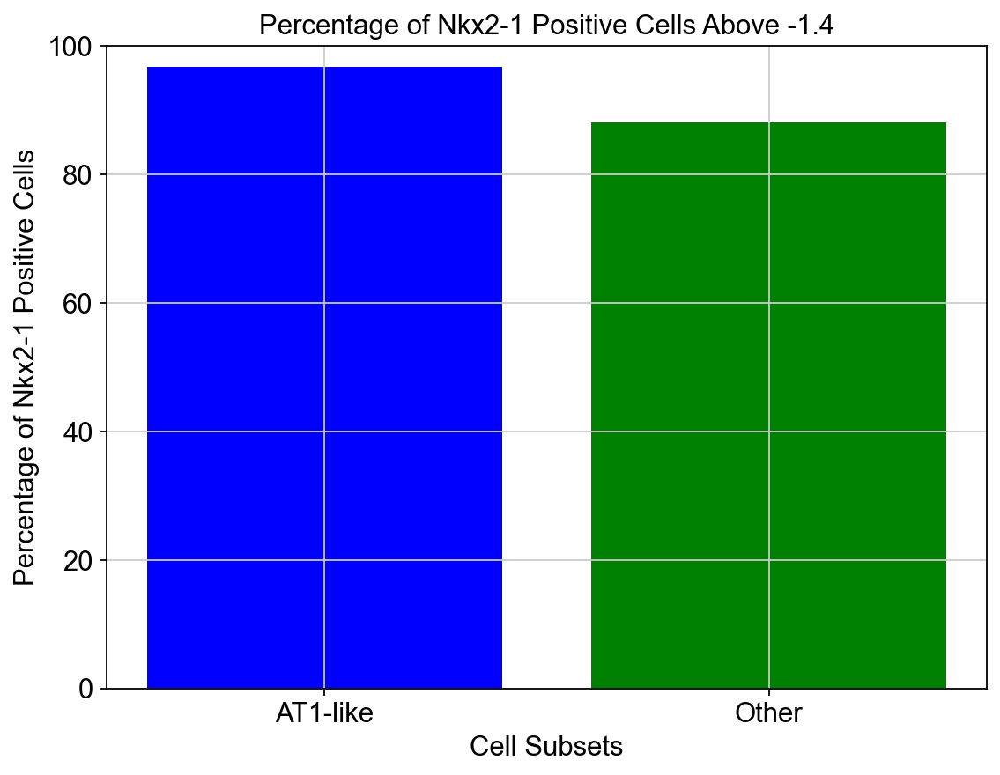

SignificanceResult(statistic=3.9640449438202245, pvalue=1.217994522204483e-06)

In [68]:
gene = 'Nkx2-1'
expression_values = adata[:, gene].X
threshold = -1.4

# Plot the histogram
plt.figure(figsize=(10, 6))
plt.hist(expression_values, bins=50, color='blue', edgecolor='black')
plt.axvline(x=threshold)
plt.xlabel('Expression Values')
plt.ylabel('Frequency')
plt.title(f'Histogram of {gene} Expression Values')
plt.show()

# Bar Graph

subset_a = adata2[adata2.obs['AT1-like_cell'] == 1,:]
subset_b = adata2[adata2.obs['AT1-like_cell'] == 0,:]

# Extract the expression values for the gene for each subset
expression_values_a = subset_a[:, gene].X
expression_values_b = subset_b[:, gene].X

# Calculate the percentage of cells with expression values above the threshold
percent_a = (expression_values_a > threshold).sum() / len(expression_values_a) * 100
percent_b = (expression_values_b > threshold).sum() / len(expression_values_b) * 100

# Plot the bar graph
plt.figure(figsize=(8, 6))
plt.bar(['AT1-like', 'Other'], [percent_a, percent_b], color=['blue', 'green'])
plt.xlabel('Cell Subsets')
plt.ylabel(f'Percentage of {gene} Positive Cells')
plt.title(f'Percentage of {gene} Positive Cells Above {threshold}')
plt.ylim(0, 100)
#plt.savefig(f'figures/Fig2i_{gene}_positive_cells_percentage_14wk.svg')
plt.show()

# calculate statistics
from scipy.stats import fisher_exact
table = [[(expression_values_a > threshold).sum(), (expression_values_a <= threshold).sum()],
        [(expression_values_b > threshold).sum(), (expression_values_b <= threshold).sum()]]
fisher_exact(table)

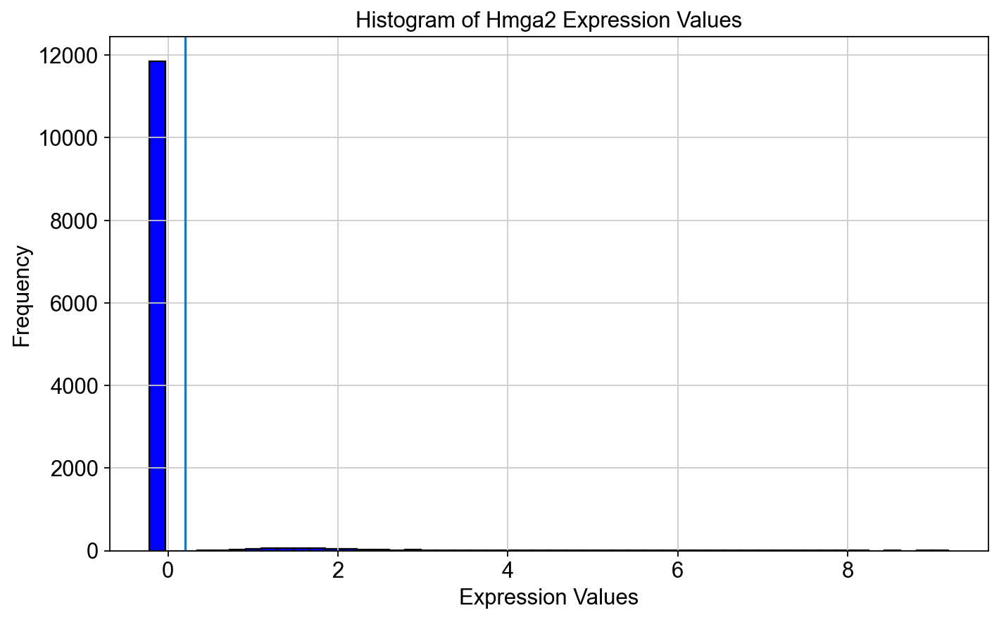

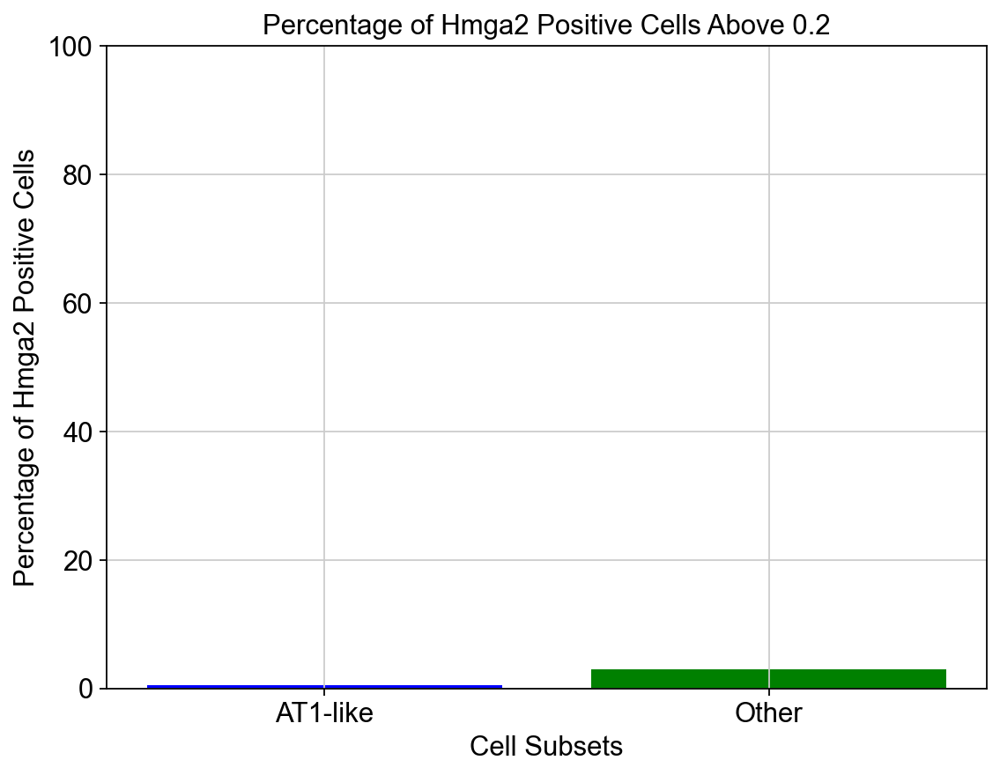

SignificanceResult(statistic=0.16198347107438016, pvalue=0.003583260864023125)

In [69]:
gene = 'Hmga2'
expression_values = adata[:, gene].X
threshold = 0.2

# Plot the histogram
plt.figure(figsize=(10, 6))
plt.hist(expression_values, bins=50, color='blue', edgecolor='black')
plt.axvline(x=threshold)
plt.xlabel('Expression Values')
plt.ylabel('Frequency')
plt.title(f'Histogram of {gene} Expression Values')
plt.show()

# Bar Graph

subset_a = adata2[adata2.obs['AT1-like_cell'] == 1,:]
subset_b = adata2[adata2.obs['AT1-like_cell'] == 0,:]

# Extract the expression values for the gene for each subset
expression_values_a = subset_a[:, gene].X
expression_values_b = subset_b[:, gene].X

# Calculate the percentage of cells with expression values above the threshold
percent_a = (expression_values_a > threshold).sum() / len(expression_values_a) * 100
percent_b = (expression_values_b > threshold).sum() / len(expression_values_b) * 100

# Plot the bar graph
plt.figure(figsize=(8, 6))
plt.bar(['AT1-like', 'Other'], [percent_a, percent_b], color=['blue', 'green'])
plt.xlabel('Cell Subsets')
plt.ylabel(f'Percentage of {gene} Positive Cells')
plt.title(f'Percentage of {gene} Positive Cells Above {threshold}')
plt.ylim(0, 100)
#plt.savefig(f'figures/Fig2i_{gene}_positive_cells_percentage_14wk.svg')
plt.show()

# Calculate statistics

from scipy.stats import fisher_exact
table = [[(expression_values_a > threshold).sum(), (expression_values_a <= threshold).sum()],
        [(expression_values_b > threshold).sum(), (expression_values_b <= threshold).sum()]]
fisher_exact(table)

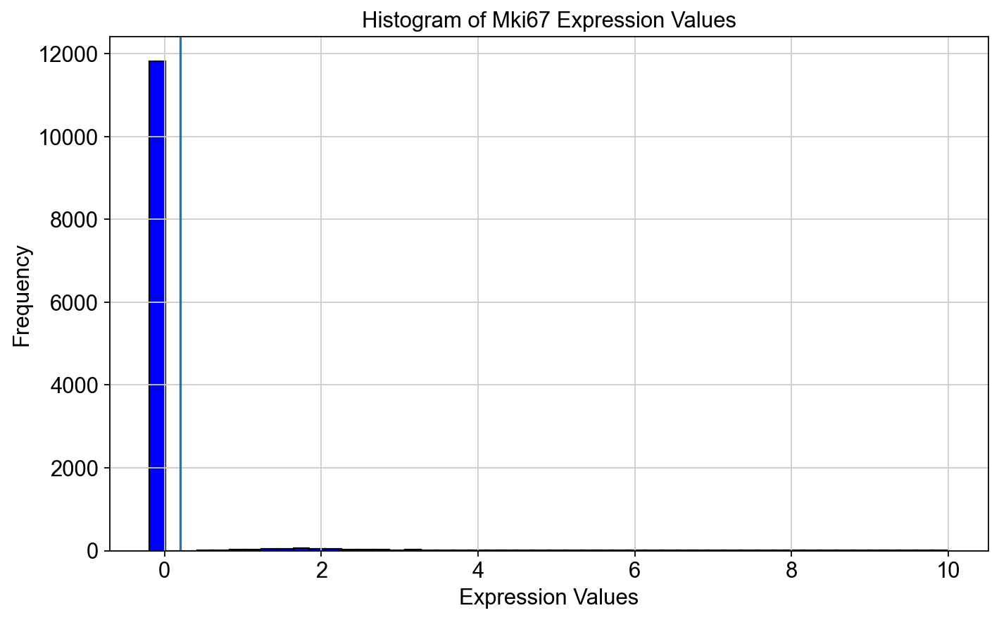

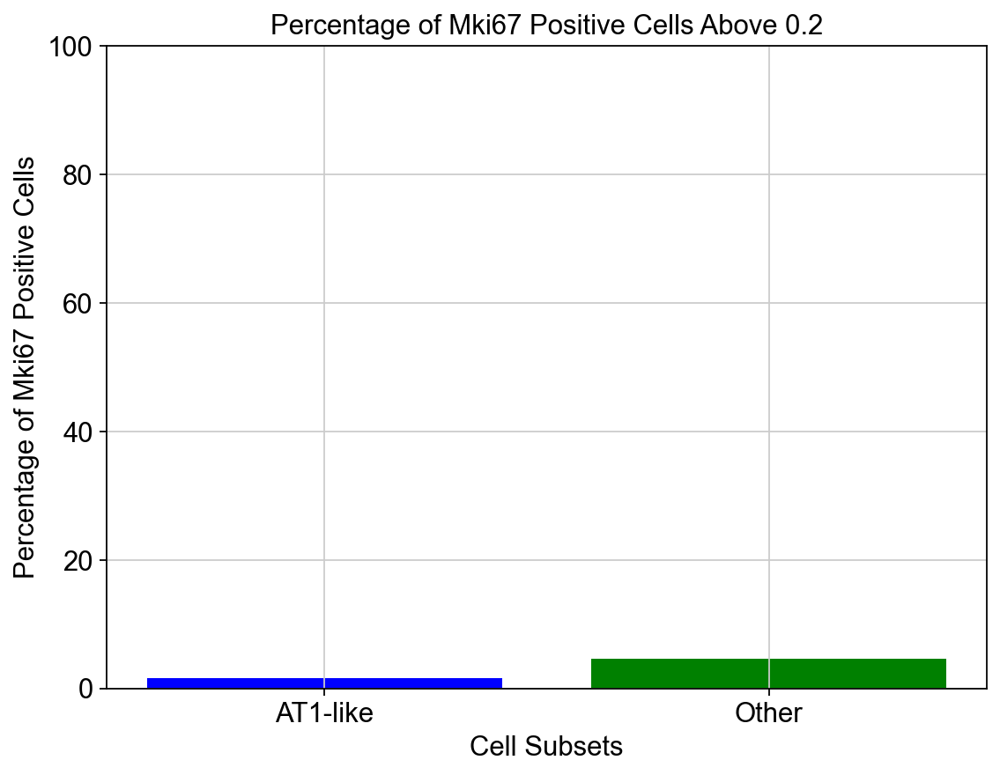

SignificanceResult(statistic=0.3451982799808887, pvalue=0.013828036440469902)

In [70]:
gene = 'Mki67'
expression_values = adata[:, gene].X
threshold = 0.2

# Plot the histogram
plt.figure(figsize=(10, 6))
plt.hist(expression_values, bins=50, color='blue', edgecolor='black')
plt.axvline(x=threshold)
plt.xlabel('Expression Values')
plt.ylabel('Frequency')
plt.title(f'Histogram of {gene} Expression Values')
plt.show()

# Bar Graph

subset_a = adata2[adata2.obs['AT1-like_cell'] == 1,:]
subset_b = adata2[adata2.obs['AT1-like_cell'] == 0,:]

# Extract the expression values for the gene for each subset
expression_values_a = subset_a[:, gene].X
expression_values_b = subset_b[:, gene].X

# Calculate the percentage of cells with expression values above the threshold
percent_a = (expression_values_a > threshold).sum() / len(expression_values_a) * 100
percent_b = (expression_values_b > threshold).sum() / len(expression_values_b) * 100

# Plot the bar graph
plt.figure(figsize=(8, 6))
plt.bar(['AT1-like', 'Other'], [percent_a, percent_b], color=['blue', 'green'])
plt.xlabel('Cell Subsets')
plt.ylabel(f'Percentage of {gene} Positive Cells')
plt.title(f'Percentage of {gene} Positive Cells Above {threshold}')
plt.ylim(0, 100)
#plt.savefig(f'figures/Fig2i_{gene}_positive_cells_percentage_14wk.svg')
plt.show()

#Calculate statistics

from scipy.stats import fisher_exact
table = [[(expression_values_a > threshold).sum(), (expression_values_a <= threshold).sum()],
        [(expression_values_b > threshold).sum(), (expression_values_b <= threshold).sum()]]
fisher_exact(table)

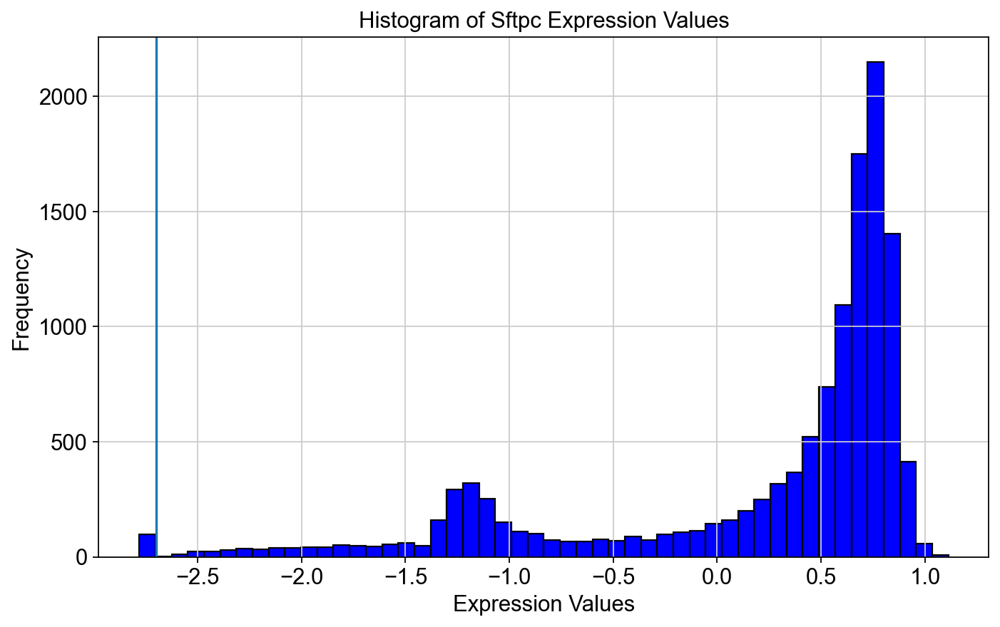

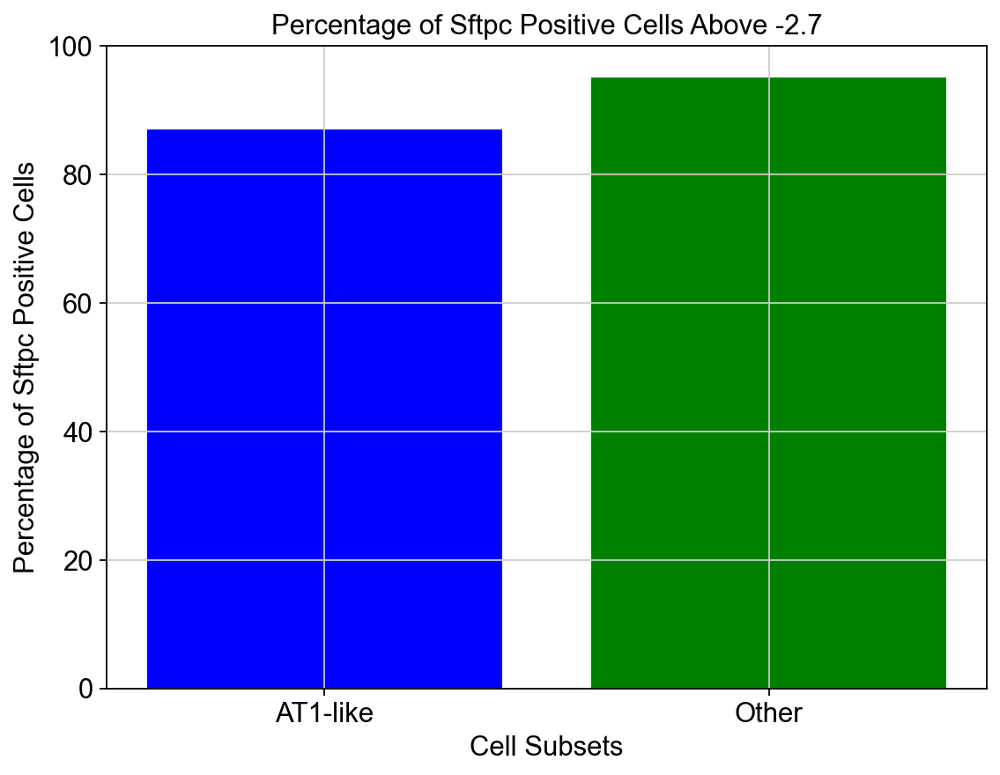

SignificanceResult(statistic=0.34876054852320676, pvalue=0.0001150390850930374)

In [71]:
gene = 'Sftpc'
expression_values = adata[:, gene].X
threshold = -2.7

# Plot the histogram
plt.figure(figsize=(10, 6))
plt.hist(expression_values, bins=50, color='blue', edgecolor='black')
plt.axvline(x=threshold)
plt.xlabel('Expression Values')
plt.ylabel('Frequency')
plt.title(f'Histogram of {gene} Expression Values')
plt.show()

# Bar Graph

subset_a = adata2[adata2.obs['AT1-like_cell'] == 1,:]
subset_b = adata2[adata2.obs['AT1-like_cell'] == 0,:]

# Extract the expression values for the gene for each subset
expression_values_a = subset_a[:, gene].X
expression_values_b = subset_b[:, gene].X

# Calculate the percentage of cells with expression values above the threshold
percent_a = (expression_values_a > threshold).sum() / len(expression_values_a) * 100
percent_b = (expression_values_b > threshold).sum() / len(expression_values_b) * 100

# Plot the bar graph
plt.figure(figsize=(8, 6))
plt.bar(['AT1-like', 'Other'], [percent_a, percent_b], color=['blue', 'green'])
plt.xlabel('Cell Subsets')
plt.ylabel(f'Percentage of {gene} Positive Cells')
plt.title(f'Percentage of {gene} Positive Cells Above {threshold}')
plt.ylim(0, 100)
#plt.savefig(f'figures/Fig2i_{gene}_positive_cells_percentage_14wk.svg')
plt.show()

# Calculate statistics
from scipy.stats import fisher_exact
table = [[(expression_values_a > threshold).sum(), (expression_values_a <= threshold).sum()],
        [(expression_values_b > threshold).sum(), (expression_values_b <= threshold).sum()]]
fisher_exact(table)

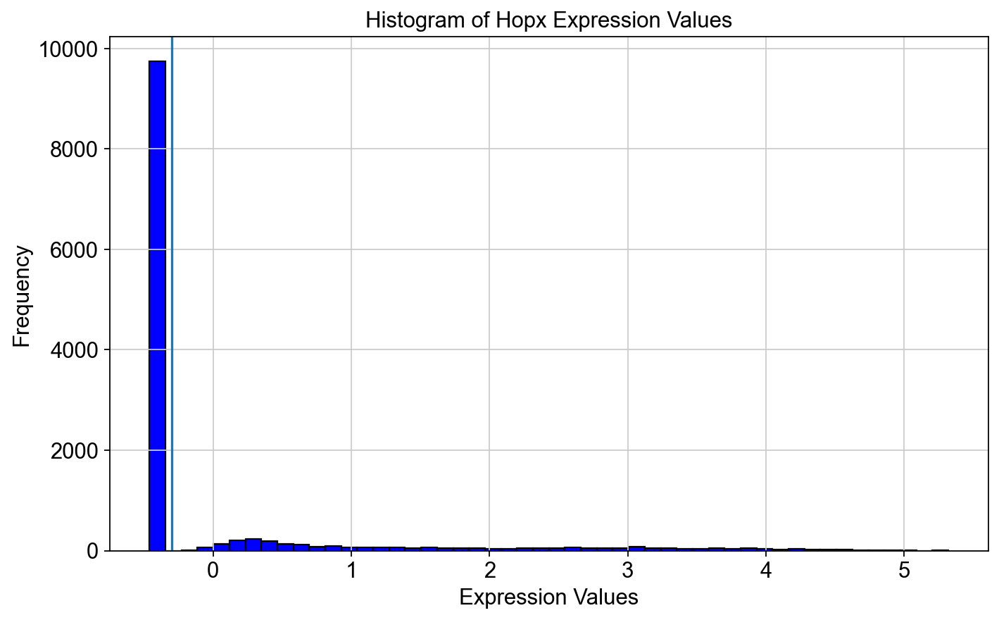

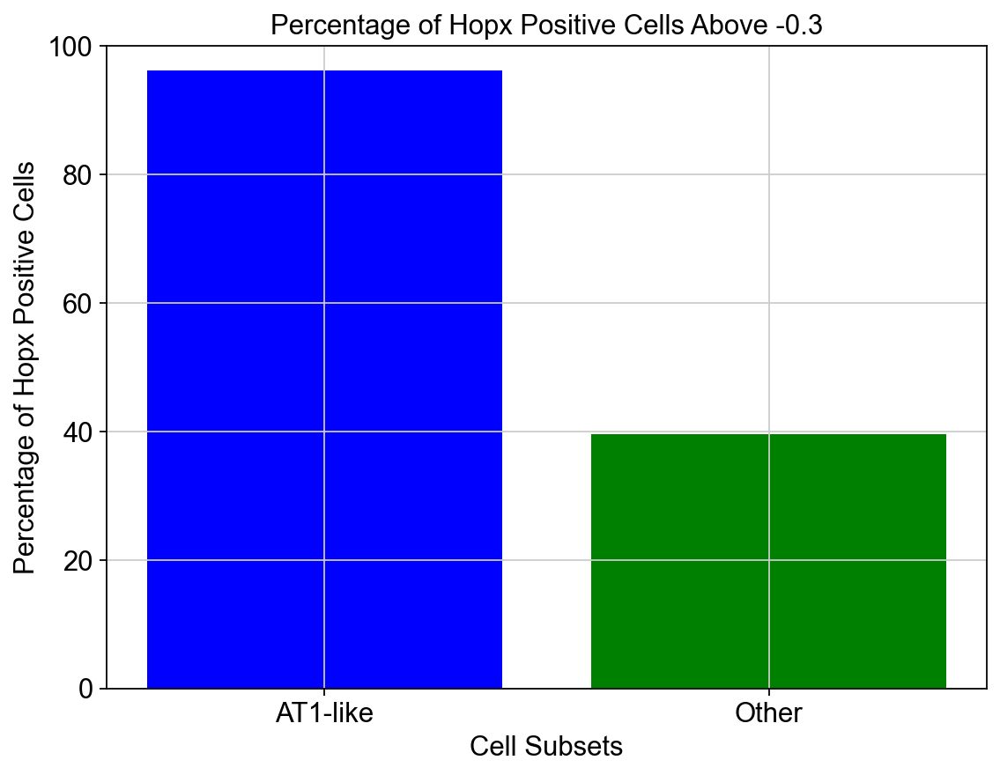

SignificanceResult(statistic=38.78804347826087, pvalue=2.9653443033153486e-82)

In [72]:
gene = 'Hopx'
expression_values = adata[:, gene].X
threshold = -0.3

# Plot the histogram
plt.figure(figsize=(10, 6))
plt.hist(expression_values, bins=50, color='blue', edgecolor='black')
plt.axvline(x=threshold)
plt.xlabel('Expression Values')
plt.ylabel('Frequency')
plt.title(f'Histogram of {gene} Expression Values')
plt.show()

# Bar Graph

subset_a = adata2[adata2.obs['AT1-like_cell'] == 1,:]
subset_b = adata2[adata2.obs['AT1-like_cell'] == 0,:]

# Extract the expression values for the gene for each subset
expression_values_a = subset_a[:, gene].X
expression_values_b = subset_b[:, gene].X

# Calculate the percentage of cells with expression values above the threshold
percent_a = (expression_values_a > threshold).sum() / len(expression_values_a) * 100
percent_b = (expression_values_b > threshold).sum() / len(expression_values_b) * 100

# Plot the bar graph
plt.figure(figsize=(8, 6))
plt.bar(['AT1-like', 'Other'], [percent_a, percent_b], color=['blue', 'green'])
plt.xlabel('Cell Subsets')
plt.ylabel(f'Percentage of {gene} Positive Cells')
plt.title(f'Percentage of {gene} Positive Cells Above {threshold}')
plt.ylim(0, 100)
#plt.savefig(f'figures/Fig2i_{gene}_positive_cells_percentage_14wk.svg')
plt.show()

#Calculate statistics
from scipy.stats import fisher_exact
table = [[(expression_values_a > threshold).sum(), (expression_values_a <= threshold).sum()],
        [(expression_values_b > threshold).sum(), (expression_values_b <= threshold).sum()]]
fisher_exact(table)

### Generate uMAPs

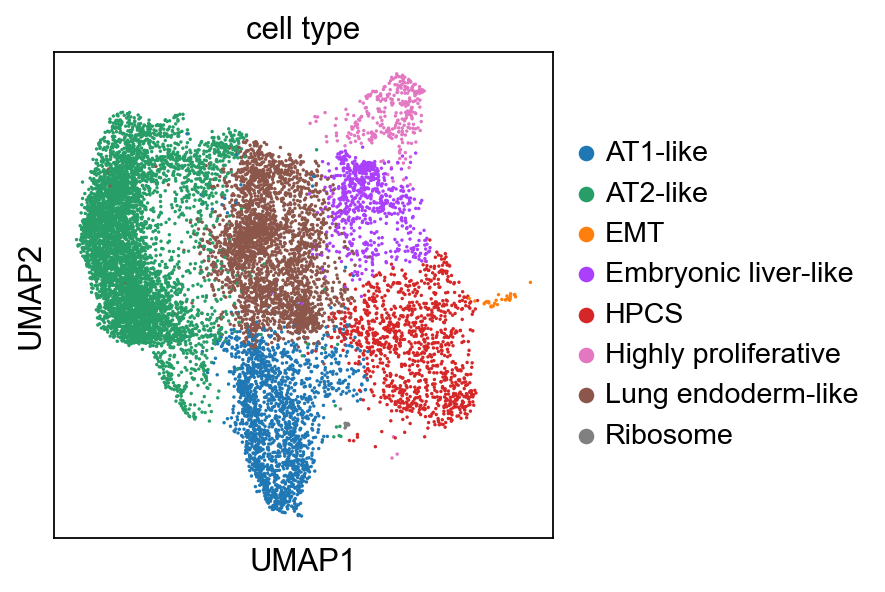

In [73]:
sc.pl.umap(adata,color=['cell type'], save='Ext_Data_Fig5a_cell state umap.svg')
#sc.pl.umap(adata,color=['Slc4a11'], save='Slc4a11 umap.svg', cmap='Reds')
#sc.pl.umap(adata,color=['iDTR'], save='DTR umap.svg', cmap='Reds')
#sc.pl.umap(adata,color=['Cluster 5'], save='Cluster 5 umap.svg', cmap='Reds')

In [74]:
ordered = ['8wk','12wk_3d','14wk']
cell_proportion_df = pd.crosstab(adata.obs['cell type'],adata.obs['Group'], normalize='columns')[ordered].T.plot(kind='bar', stacked=True, color=adata.uns["cell type_colors"]).legend(bbox_to_anchor=(1,1))
cell_proportion_df.get_figure().savefig('figures/Fig2d_cell state proportions.svg')

KeyError: "None of [Index(['8wk', '12wk_3d', '14wk'], dtype='object', name='Group')] are in the [columns]"

In [49]:
adata[adata.obs.Group=='12wk_3d',:].obs['cell type'].value_counts(normalize=True)

cell type
HPCS                    0.748005
Lung endoderm-like      0.068415
AT2-like                0.054732
Embryonic liver-like    0.047891
AT1-like                0.042189
Highly proliferative    0.038769
Name: proportion, dtype: float64

In [308]:
adata.obs['Group'].value_counts()

Group
14wk       991
12wk_3d    877
8wk        742
Name: count, dtype: int64

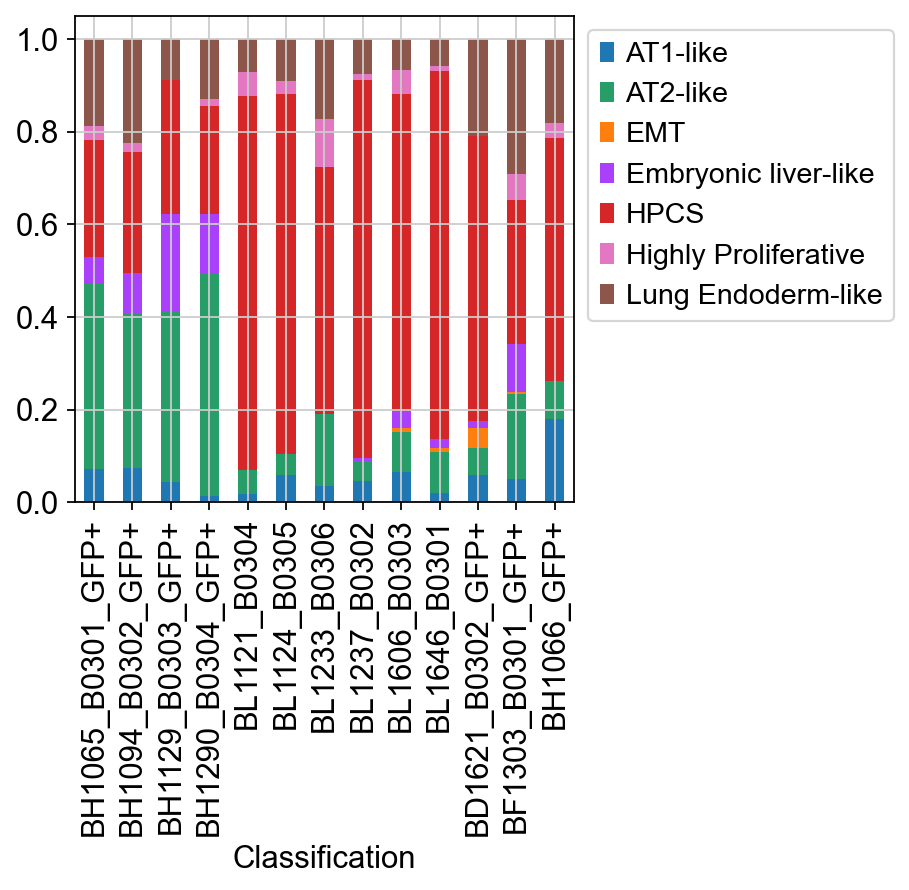

In [301]:
#ordered = ['BH1065_B0301_GFP+','BH1094_B0302_GFP+','BH1129_B0303_GFP+','BH1290_B0304_GFP+','BD1621_B0302_GFP+','BF1303_B0301_GFP+','BH1066_GFP+']
ordered = ['BH1065_B0301_GFP+','BH1094_B0302_GFP+','BH1129_B0303_GFP+','BH1290_B0304_GFP+',
           'BL1121_B0304','BL1124_B0305','BL1233_B0306','BL1237_B0302','BL1606_B0303','BL1646_B0301',
           'BD1621_B0302_GFP+','BF1303_B0301_GFP+','BH1066_GFP+']
cell_proportion_df = pd.crosstab(adata.obs['cell type'],adata.obs['Classification'], normalize='columns')[ordered].T.plot(kind='bar', stacked=True,color=adata.uns["cell type_colors"]).legend(bbox_to_anchor=(1,1))
cell_proportion_df.get_figure().savefig('figures/Ext_Data_Fig5b_cellmapbyID2.svg')

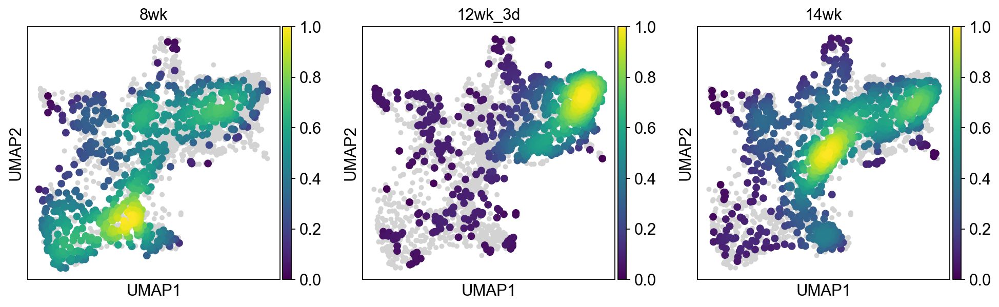

In [302]:
sc.pl.embedding_density(adata, basis='umap', key='umap_density_Group',save='Fig2_f_g_Week.svg',color_map='viridis',)

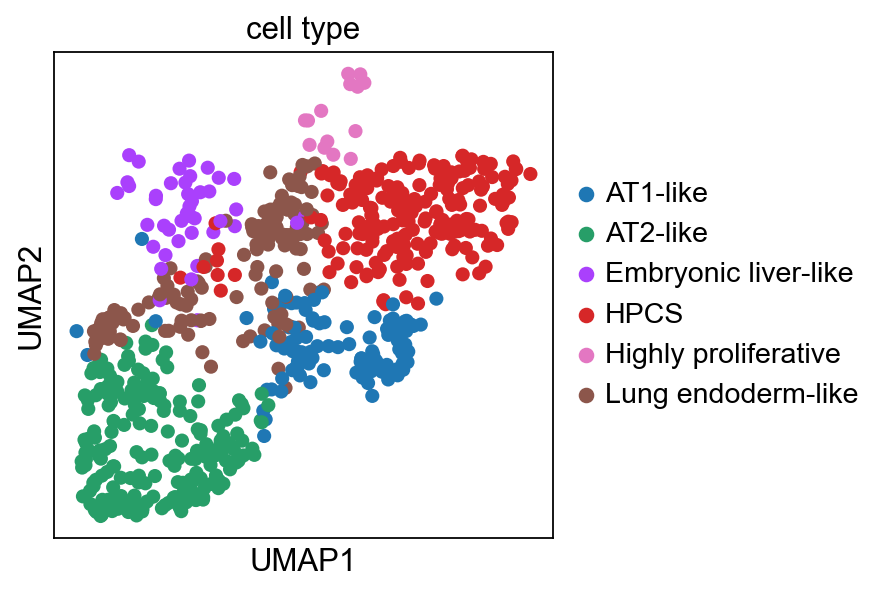

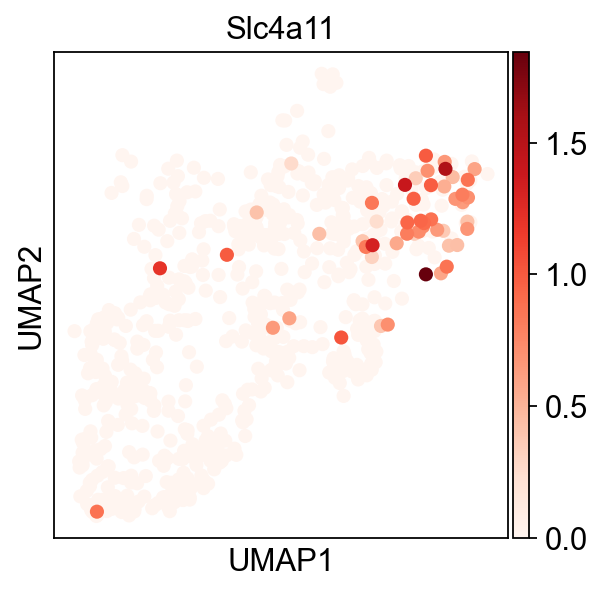

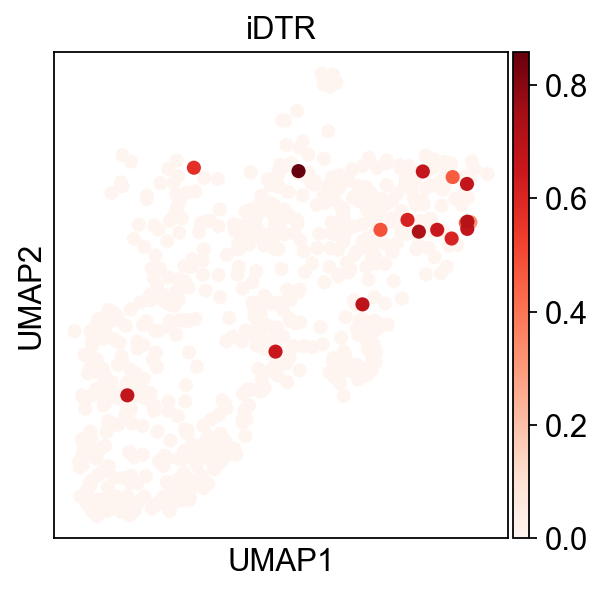

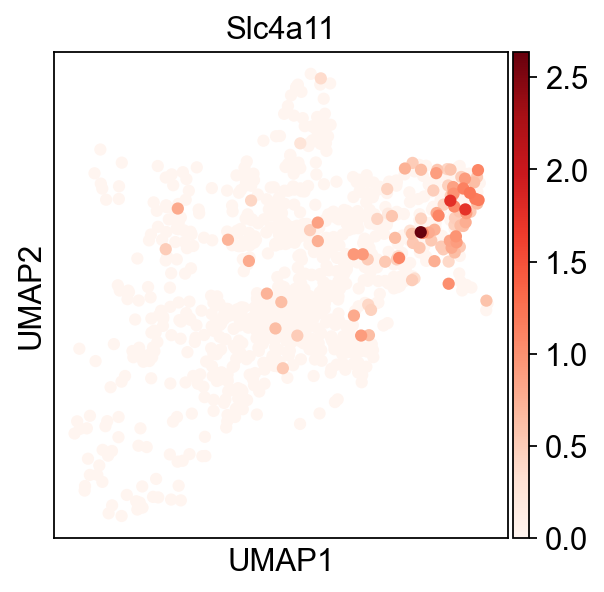

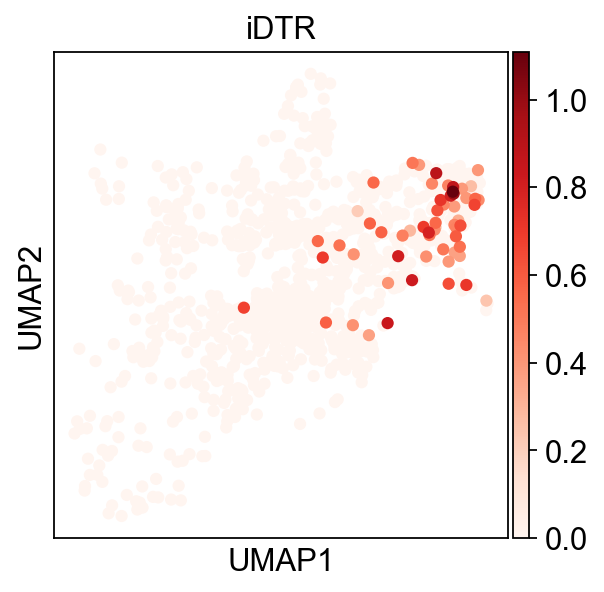

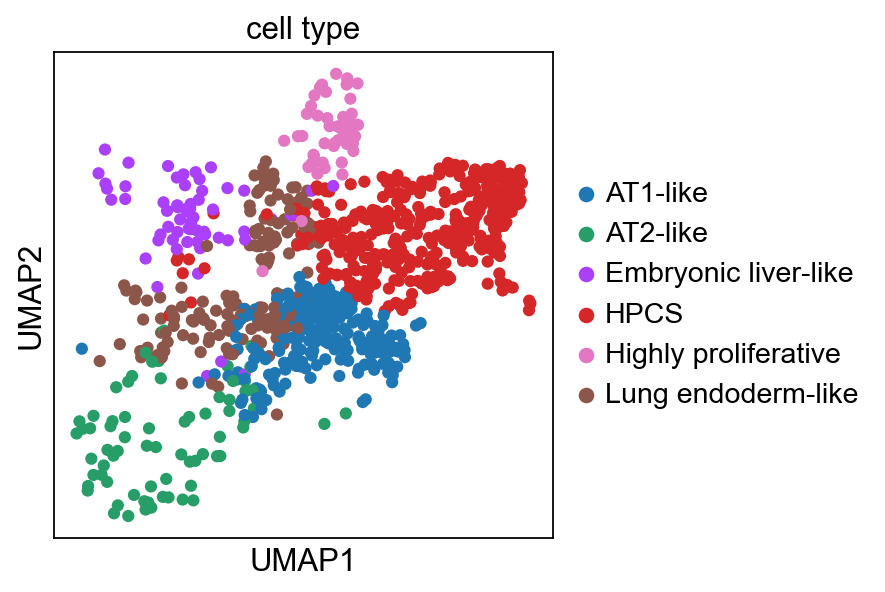

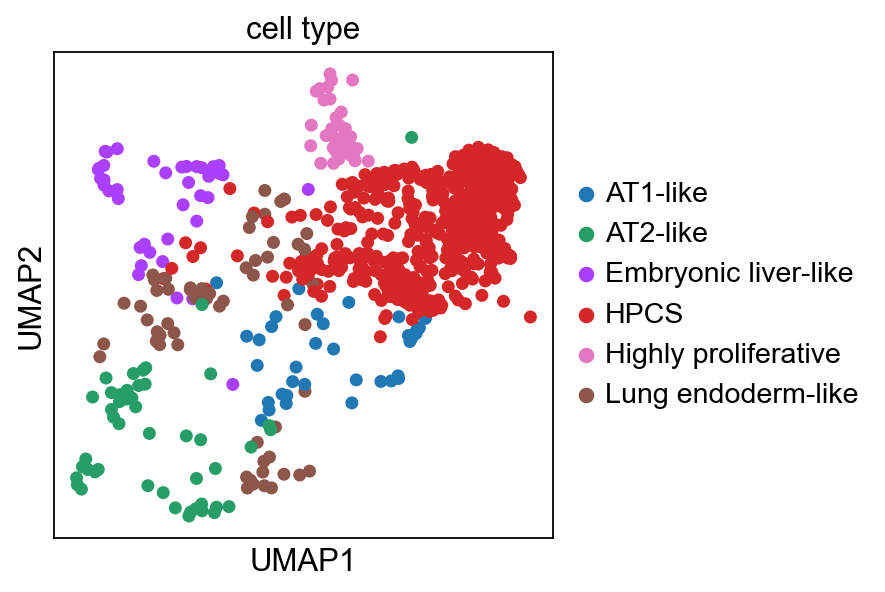

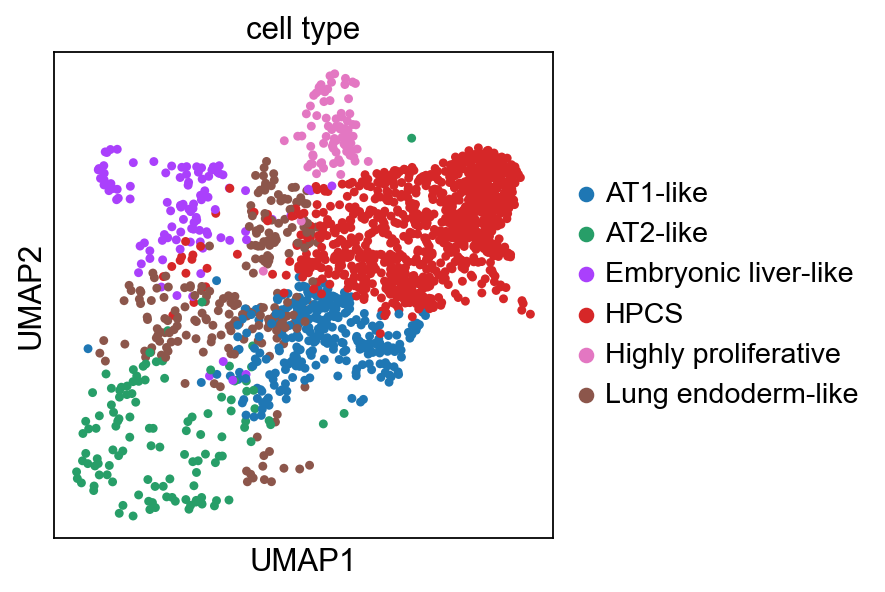

In [53]:
sc.pl.umap(adata[adata.obs.Group=='8wk',:],color=['cell type'], save='Fig2f_cell state umap-8wk.svg')
sc.pl.umap(adata[adata.obs.Group=='8wk',:],color=['Slc4a11'], save='Ext_Data_Fig5c_Slc4a11 umap-8wk.svg', cmap='Reds')
sc.pl.umap(adata[adata.obs.Group=='8wk',:],color=['iDTR'], save='Ext_Data_Fig5c_DTR umap-8wk.svg', cmap='Reds')
#sc.pl.umap(adata[adata.obs.Group=='8wk',:],color=['Cluster 5'], save='HPCS umap-8wk.svg', cmap='Reds')
sc.pl.umap(adata[adata.obs.Group=='14wk',:],color=['Slc4a11'], save='Ext_Data_Fig5d_Slc4a11 umap-14wk.svg', cmap='Reds')
sc.pl.umap(adata[adata.obs.Group=='14wk',:],color=['iDTR'], save='Ext_Data_Fig5dDTR umap-14wk.svg', cmap='Reds')
#sc.pl.umap(adata[adata.obs.Group=='14wk',:],color=['Cluster 5'], save='HPCS umap-14wk.svg', cmap='Reds')
sc.pl.umap(adata[adata.obs.Group=='14wk',:],color=['cell type'], save='Fig2g_cell state umap-14wk.svg')
sc.pl.umap(adata[adata.obs.Group=='12wk_3d',:],color=['cell type']) # save to file at somepoint
sc.pl.umap(adata[adata.obs.Group.isin(['12wk_3d','14wk']),:],color=['cell type'],save='Interim_14wk.svg')

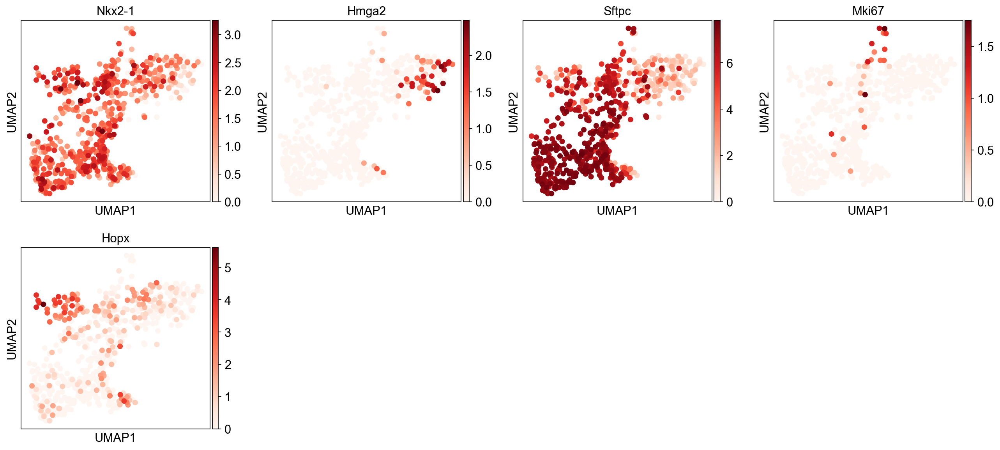

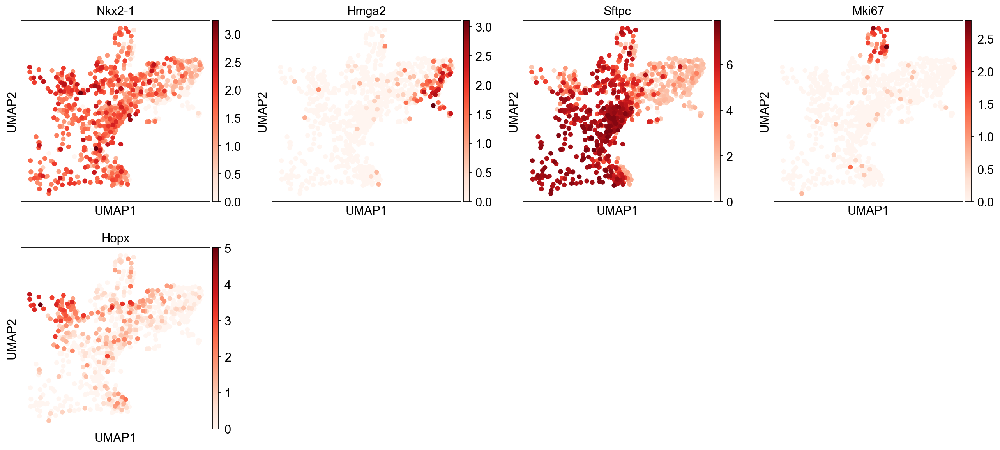

In [305]:
#Markers
sc.pl.umap(adata[adata.obs.Group=='8wk',:],color=['Nkx2-1','Hmga2','Sftpc','Mki67','Hopx'], save='Ext_Data_Fig5e_h_cell type markers-8wk.svg',cmap='Reds')
sc.pl.umap(adata[adata.obs.Group=='14wk',:],color=['Nkx2-1','Hmga2','Sftpc','Mki67','Hopx'], save='Fig2h_Ext_Data_Fig5h_cell type markers-14wk.svg',cmap='Reds')

## For Revision

In [48]:
adata_orig = load('write/combined_data.joblib').raw.to_adata()

In [49]:
adata2 = load('../../IGO16652_IGO16655/write/allmice-tumor-IGO16652_IGO16655-noPtprc.joblib')

### Try concatenation

In [50]:
adata_orig.obs.batch.value_counts()

batch
depletion        10763
untraced_14wk     1865
traced            1733
Name: count, dtype: int64

In [51]:
adata_concat = adata_orig.concatenate(adata2, join="outer")

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_50885/3254273629.py:1: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  adata_concat = adata_orig.concatenate(adata2, join="outer")


In [52]:
sc.pp.highly_variable_genes(adata_concat, batch_key='batch')

extracting highly variable genes


/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/preprocessing/_highly_variable_genes.py:226: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  disp_grouped = df.groupby("mean_bin")["dispersions"]
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/preprocessing/_highly_variable_genes.py:226: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  disp_grouped = df.groupby("mean_bin")["dispersions"]


    finished (0:00:11)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/preprocessing/_highly_variable_genes.py:508: FutureWarning: The provided callable <function nanmean at 0x105d7cd60> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  df = df.groupby("gene").agg(
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/preprocessing/_highly_variable_genes.py:508: FutureWarning: The provided callable <function nanmean at 0x105d7cd60> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  df = df.groupby("gene").agg(
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/preprocessing/_highly_variable_genes.py:508: FutureWarning: The provided callable <function nansum at 0x105d7c860> is current

In [53]:
adata_concat.var.highly_variable = adata_concat.var.highly_variable_intersection

In [54]:
#Ensure marker genes aren't making an impact to highly variable gene analysis downstream
adata_concat.var.highly_variable['EGFP'] = False
adata_concat.var.highly_variable['mScarlet'] = False
adata_concat.var.highly_variable['Cre'] = False
adata_concat.var.highly_variable['ERT'] = False
adata_concat.var.highly_variable['iDTR'] = False
adata_concat.var.highly_variable['tagBFP'] = False
adata_concat.var.highly_variable['mKate2'] = False
adata_concat.var.highly_variable['Akaluc'] = False
adata_concat.var.highly_variable['tdTomato'] = False

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_50885/490956250.py:2: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata_concat.var.highly_variable['EGFP'] = False
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_50885/

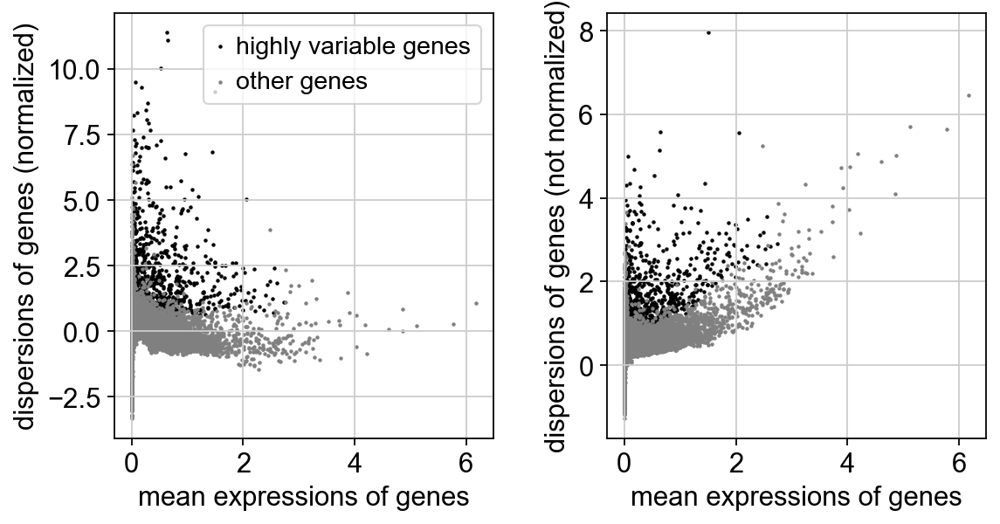

In [55]:
sc.pl.highly_variable_genes(adata_concat)

In [56]:
adata_concat.raw = adata_concat

In [57]:
sc.pp.scale(adata_concat, max_value=10)

... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


In [58]:
sc.tl.pca(adata_concat, svd_solver='arpack', n_comps=150)

computing PCA
    on highly variable genes
    with n_comps=150
    finished (0:00:03)


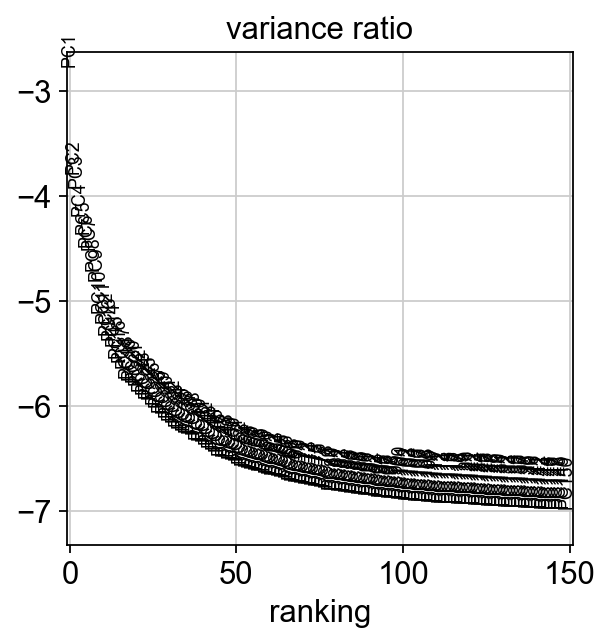

In [59]:
sc.pl.pca_variance_ratio(adata_concat, log=True, n_pcs=150)

In [60]:
sc.pp.neighbors(adata_concat, n_neighbors=15, n_pcs=50)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:13)


In [61]:
sc.tl.umap(adata_concat)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:12)


/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector

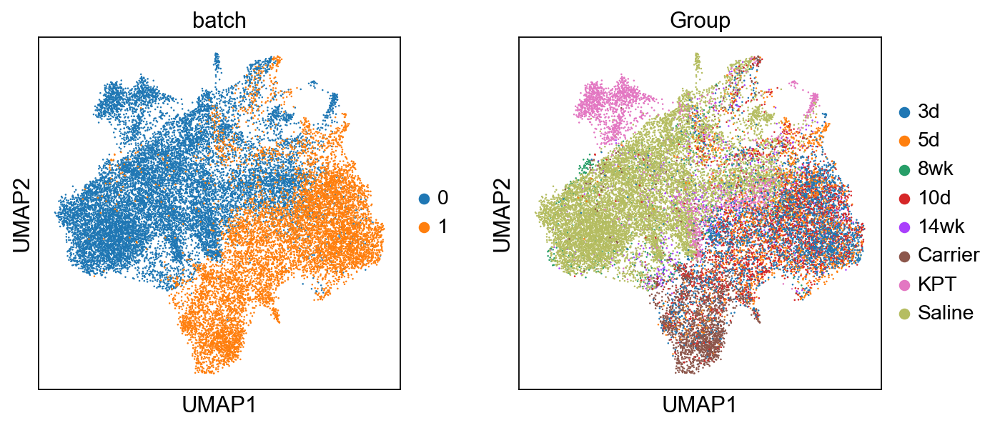

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector

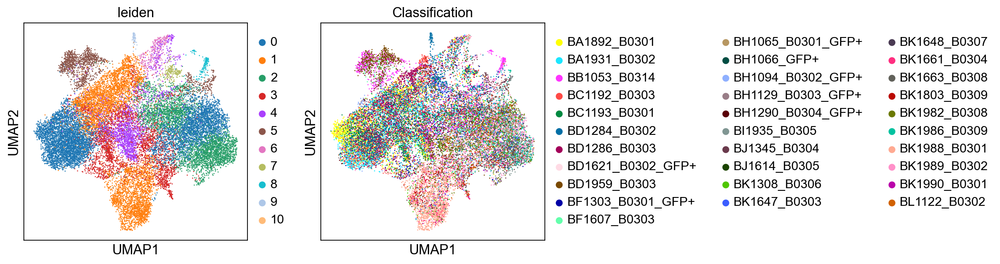

In [62]:
sc.pl.umap(adata_concat, color=['batch','Group'])
sc.pl.umap(adata_concat, color=['leiden','Classification',])

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


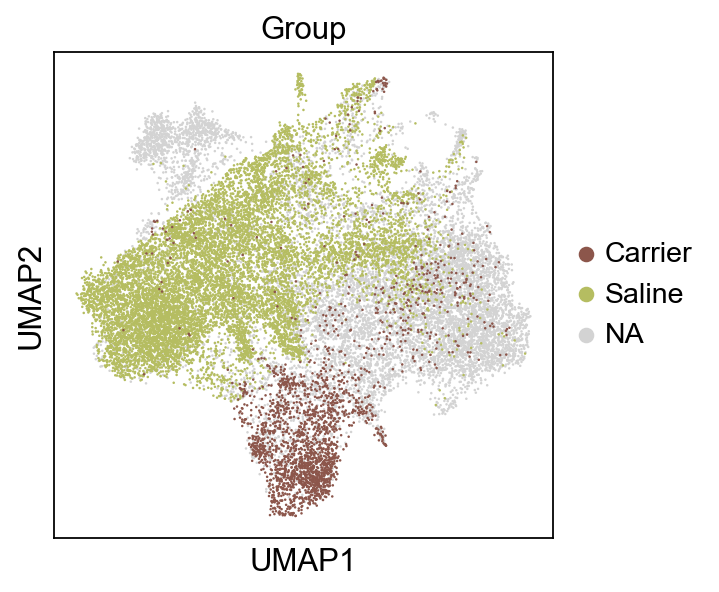

In [63]:
sc.pl.umap(adata_concat, color=['Group'], groups=['Saline', 'Carrier'])

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


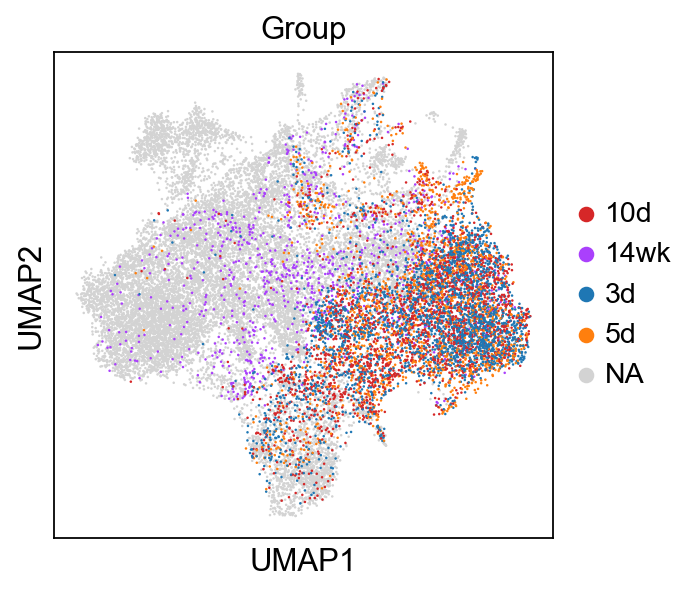

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


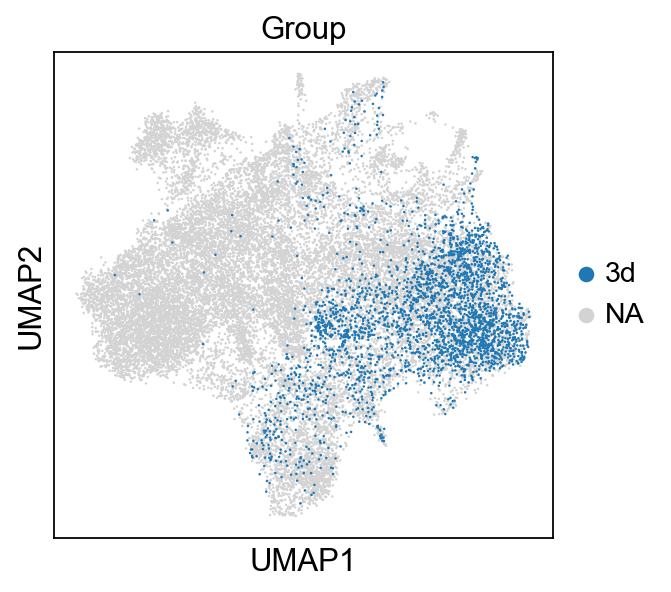

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


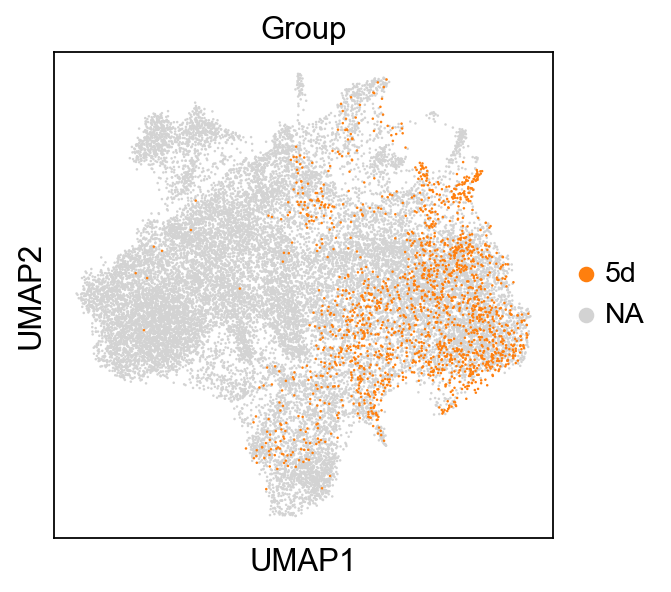

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


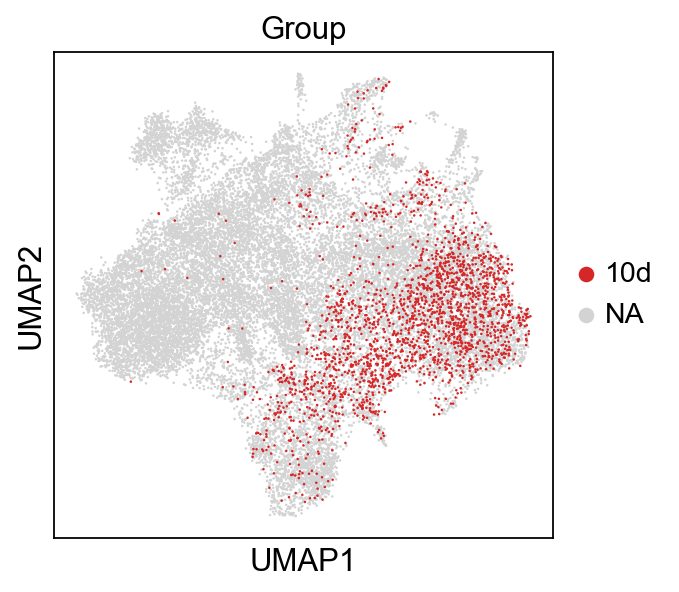

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


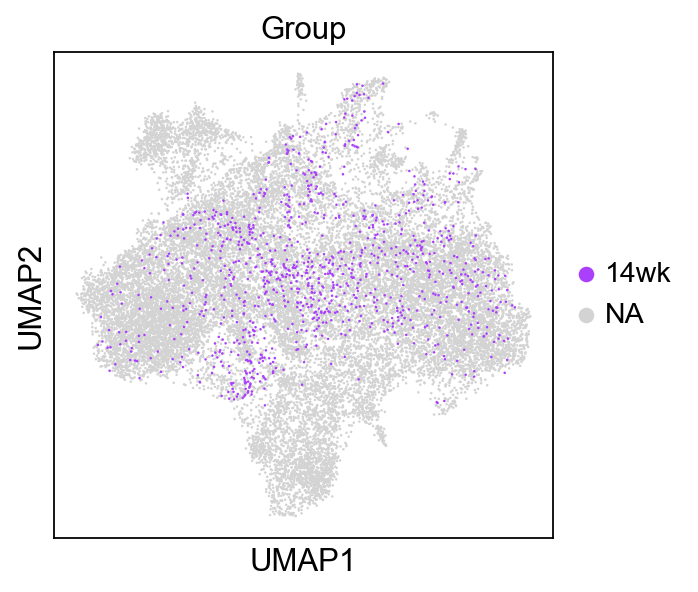

In [64]:
sc.pl.umap(adata_concat, color=['Group'], groups=['3d','5d','10d','14wk'])
sc.pl.umap(adata_concat, color=['Group'], groups=['3d'])
sc.pl.umap(adata_concat, color=['Group'], groups=['5d'])
sc.pl.umap(adata_concat, color=['Group'], groups=['10d'])
sc.pl.umap(adata_concat, color=['Group'], groups=['14wk'])

In [65]:
sc.tl.embedding_density(adata_concat,basis='umap', groupby='Group')

computing density on 'umap'
--> added
    'umap_density_Group', densities (adata.obs)
    'umap_density_Group_params', parameter (adata.uns)


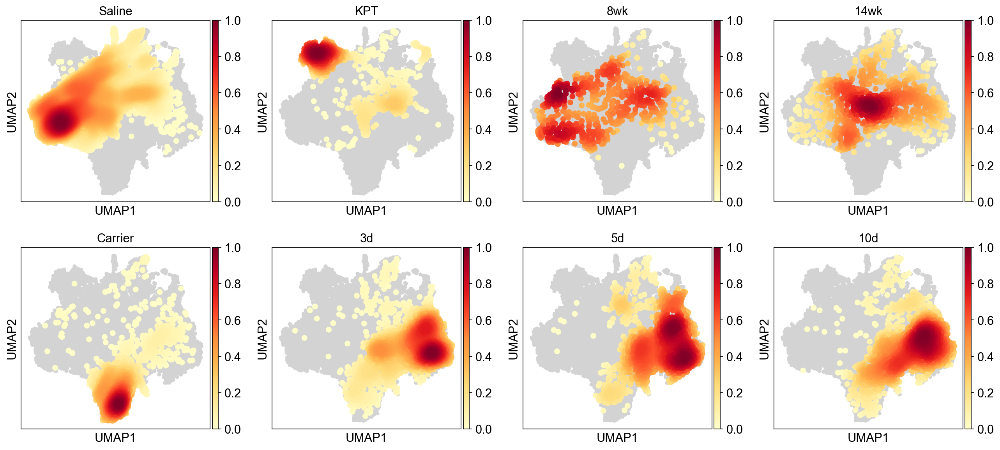

In [66]:
sc.pl.embedding_density(adata_concat,basis='umap',key='umap_density_Group', group=['Saline','KPT','8wk','14wk','Carrier','3d','5d','10d'])

### Logistic Regression

In [67]:
from sklearn.linear_model import LogisticRegression
from joblib import dump, load
names = load('../common_files/genes.joblib')

In [68]:
adata_log = adata_concat[:,adata_concat.var.index.isin(names)]

In [69]:
adata_names = [x for x in adata_log.var.index]

In [70]:
goi = [x for x in adata_log.var.index]

### Load SmartSeq h5ad file

In [71]:
smartseq = anndata.read('../Marjanovic_et_al_2020/write/Marjanovic_et_al_LUAD_data.h5ad')

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/anndata/__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


### Logistic Regression against Cancer Cell 2020 Clusters intersected with 10x data

In [72]:
from sklearn.model_selection import train_test_split

names_adata = smartseq[:,smartseq.var.index.isin(goi)]

X_train, X_test, y_train, y_test = train_test_split(names_adata.X, smartseq.obs['clusterK12'], test_size=0.25, random_state=250)

In [73]:
names = [x for x in names_adata.var.index]

In [74]:
# import the class
from sklearn.linear_model import LogisticRegression

# instantiate the model (using the default parameters)
logreg = LogisticRegression(random_state=250,multi_class='multinomial', solver='lbfgs')

# fit the model with data
logreg.fit(X_train, y_train)

y_pred = logreg.predict(X_test)
y_score = logreg.predict_proba(X_test)


In [75]:
# import the metrics class
from sklearn import metrics

cnf_matrix = metrics.confusion_matrix(y_test, y_pred)
cnf_matrix

array([[144,   5,   2,   0,   0,   0,   1,   0,   0,   0,   0,   0],
       [  7,  70,   0,   3,   0,   0,   0,   0,   0,   0,   0,   0],
       [  0,   0,  42,   0,   2,   0,   0,   2,   0,   1,   0,   0],
       [  0,   1,   0,  66,   0,   0,   0,   9,   1,   0,   0,   0],
       [  0,   0,   3,   0, 181,   2,   0,   2,   0,   0,   0,   1],
       [  0,   0,   0,   0,   0,  34,   0,   0,   0,   0,   0,   0],
       [  0,   0,   0,   0,   0,   0,  14,   1,   0,   0,   0,   0],
       [  0,   0,   1,   2,   1,   0,   0, 138,   1,   0,   0,   1],
       [  0,   0,   0,   1,   1,   0,   0,   1,  38,   1,   0,   0],
       [  0,   0,   1,   1,   0,   0,   0,   3,   0,  57,   0,   1],
       [  0,   0,   0,   0,   0,   0,   0,   0,   1,   0,  13,   0],
       [  0,   0,   0,   0,   1,   0,   0,   0,   1,   1,   0,  40]])

Text(0.5, 295.64444444444445, 'Predicted label')

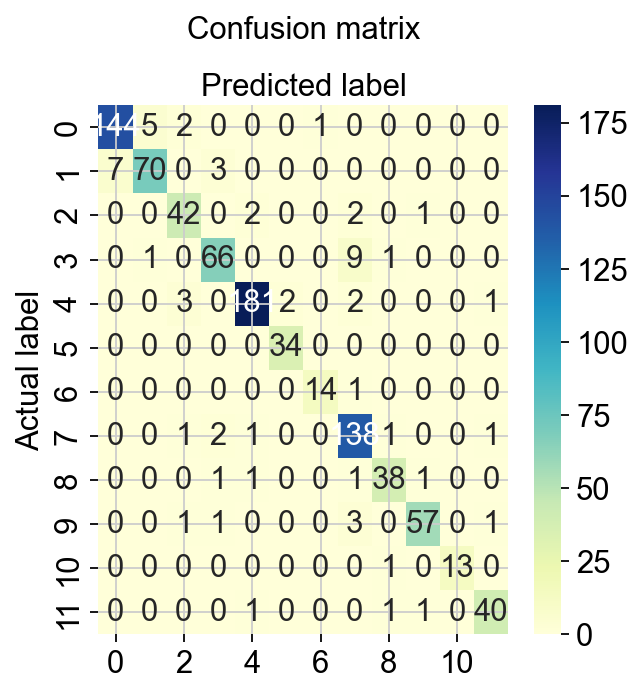

In [76]:
# import required modules
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

class_names=[0,1] # name  of classes
fig, ax = plt.subplots()
tick_marks = np.arange(len(class_names))
plt.xticks(tick_marks, class_names)
plt.yticks(tick_marks, class_names)
# create heatmap
sns.heatmap(pd.DataFrame(cnf_matrix), annot=True, cmap="YlGnBu" ,fmt='g')
ax.xaxis.set_label_position("top")
plt.tight_layout()
plt.title('Confusion matrix', y=1.1)
plt.ylabel('Actual label')
plt.xlabel('Predicted label')

#Text(0.5,257.44,'Predicted label');

In [77]:
from sklearn.metrics import classification_report
target_names = ['1', '2', '3','4','5','6','7','8','9','10','11','12']
print(classification_report(y_test, y_pred, target_names=target_names))

              precision    recall  f1-score   support

           1       0.95      0.95      0.95       152
           2       0.92      0.88      0.90        80
           3       0.86      0.89      0.88        47
           4       0.90      0.86      0.88        77
           5       0.97      0.96      0.97       189
           6       0.94      1.00      0.97        34
           7       0.93      0.93      0.93        15
           8       0.88      0.96      0.92       144
           9       0.90      0.90      0.90        42
          10       0.95      0.90      0.93        63
          11       1.00      0.93      0.96        14
          12       0.93      0.93      0.93        43

    accuracy                           0.93       900
   macro avg       0.93      0.92      0.93       900
weighted avg       0.93      0.93      0.93       900



In [78]:
from sklearn.preprocessing import LabelBinarizer

label_binarizer = LabelBinarizer().fit(y_train)
y_onehot_test = label_binarizer.transform(y_test)
y_onehot_test.shape  # (n_samples, n_classes)

(900, 12)

In [79]:
class_of_interest = '09'
class_id = np.flatnonzero(label_binarizer.classes_ == class_of_interest)[0]
class_id

8

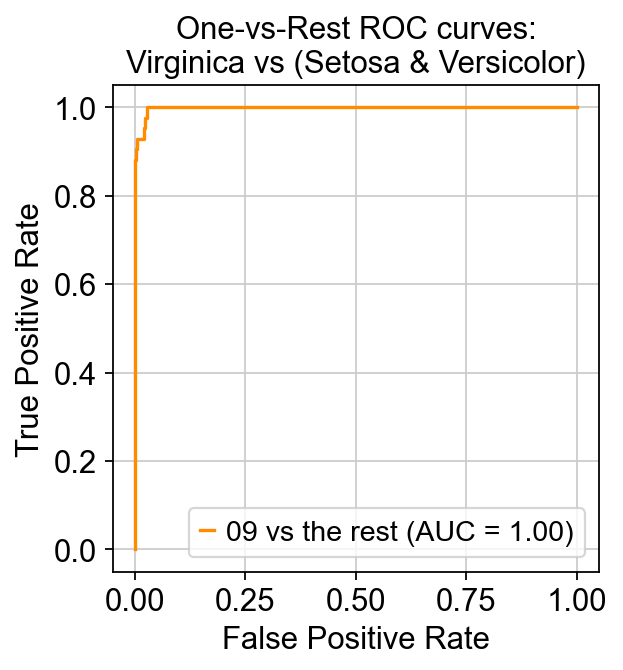

In [80]:
import matplotlib.pyplot as plt

from sklearn.metrics import RocCurveDisplay

RocCurveDisplay.from_predictions(
    y_onehot_test[:, class_id],
    y_score[:, class_id],
    name=f"{class_of_interest} vs the rest",
    color="darkorange",
    #plot_chance_level=True,
)
plt.axis("square")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("One-vs-Rest ROC curves:\nVirginica vs (Setosa & Versicolor)")
plt.legend()
plt.show()

In [81]:
y_pred = logreg.predict(smartseq[:,names].X)
y_proba = logreg.predict_proba(smartseq[:,names].X)

In [82]:
smartseq.obs['clusterK12_intersecting'] = [x for x in y_pred]
smartseq.obs['clusterK12_intersecting'] = smartseq.obs['clusterK12_intersecting'].astype('category')

In [83]:
results_binary = logreg.predict(X_test)
probs_binary = logreg.predict_proba(X_test)

results_df_binary = pd.DataFrame()
results_df_binary['predicted'] = list(results_binary)
#results_df_binary['actual'] = list(smartseq.obs['clusterK12'])
results_df_binary['actual'] = list(y_test)
for x in range(0,12):
    results_df_binary["probability_%d" % (x+1)] = [i[x] for i in list(probs_binary)]
results_df_binary['highest_prob'] =results_df_binary[["probability_%d" % (x+1) for x in range(0,12)]].max(axis=1)
results_df_binary['correct'] = (results_df_binary['predicted'] == results_df_binary['actual']).astype(int)
results_df_binary

,predicted,actual,probability_1,probability_2,probability_3,probability_4,probability_5,probability_6,probability_7,probability_8,probability_9,probability_10,probability_11,probability_12,highest_prob,correct
0,08,03,2.868328e-09,3.460578e-05,4.371896e-02,7.218471e-03,1.012053e-07,7.244185e-06,1.134288e-04,9.487001e-01,2.917646e-07,5.980578e-06,6.280483e-06,1.945099e-04,0.948700,0
1,01,01,9.999955e-01,6.941143e-08,1.027168e-09,1.257665e-08,4.209504e-08,4.018203e-07,3.988907e-06,9.467826e-12,4.689616e-11,4.997502e-10,2.515213e-08,3.730061e-10,0.999995,1
2,08,08,1.269929e-10,2.125600e-08,9.089243e-08,1.145072e-07,3.338207e-07,1.550019e-07,4.437503e-06,9.999719e-01,1.675945e-06,1.995408e-05,1.284142e-06,7.926104e-08,0.999972,1
3,10,10,9.053277e-09,2.515427e-06,8.532344e-06,1.457809e-07,3.888347e-01,8.818036e-04,5.106599e-05,1.008522e-04,1.126121e-04,6.094916e-01,5.523411e-05,4.609465e-04,0.609492,1
4,08,08,1.266332e-08,5.002160e-08,7.333045e-09,1.145182e-06,9.265604e-07,4.119222e-07,2.401401e-05,9.994290e-01,5.384298e-04,2.888819e-06,8.575594e-07,2.302360e-06,0.999429,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
895,05,05,2.917477e-04,1.890985e-07,6.788875e-06,9.690636e-05,9.603476e-01,2.371568e-02,5.558702e-04,5.872352e-03,1.338517e-03,7.502267e-03,2.446856e-04,2.739860e-05,0.960348,1
896,05,05,1.838115e-10,2.744455e-07,8.843662e-08,1.064511e-07,9.999900e-01,2.051210e-06,3.637997e-07,7.987108e-11,3.127367e-08,2.428232e-07,5.914011e-06,8.812662e-07,0.999990,1
897,08,08,6.340169e-06,3.560933e-05,9.588498e-06,2.346279e-03,2.789336e-08,3.648616e-06,7.356555e-05,9.882901e-01,9.024668e-03,1.856010e-04,1.775563e-05,6.796066e-06,0.988290,1
898,05,05,1.945549e-10,6.390892e-08,5.449948e-06,1.413578e-10,9.999930e-01,4.447883e-08,3.240526e-07,2.421682e-07,1.586812e-08,8.246898e-08,6.215381e-07,1.738290e-07,0.999993,1


In [84]:
results_df_binary['bin'] = pd.qcut(results_df_binary['highest_prob'], q=7)
idx = pd.IntervalIndex(results_df_binary['bin'])
results_df_binary['low'] = idx.left
results_df_binary['high'] = idx.right
results_df_binary['prob range'] = results_df_binary['low'].round(2).astype(str) + "-" + results_df_binary['high'].round(2).astype(str)
df_bins_grouped = results_df_binary[['low','high','correct','prob range']].groupby('prob range').mean().reset_index()
df_bins_grouped

,prob range,low,high,correct
0,0.33-0.89,0.329623,0.890908,0.682171
1,0.89-0.99,0.890908,0.987005,0.898438
2,0.99-1.0,0.987005,0.997938,0.945736
3,1.0-1.0,0.999421,0.999935,0.996109


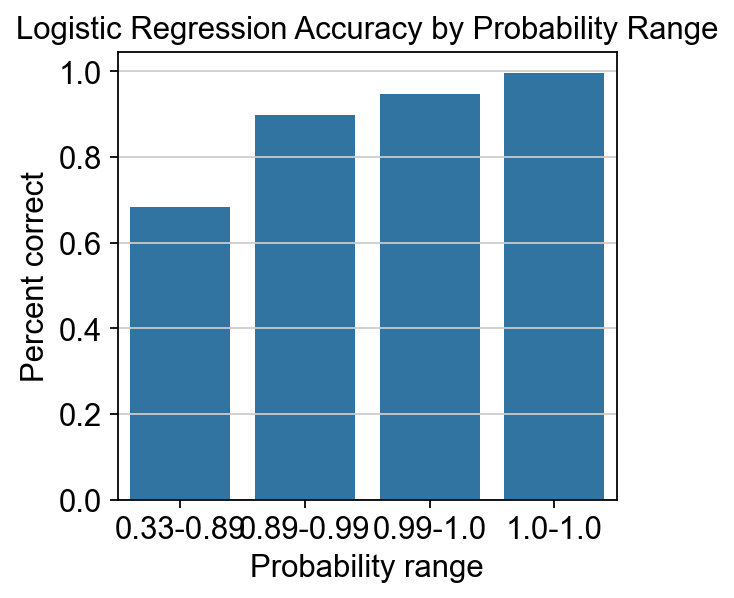

In [85]:
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
plt.figure(figsize=(4,4))
plt.subplots_adjust(top=0.85)

ax = sns.barplot(x='prob range', y='correct', data=df_bins_grouped)
plt.title("Logistic Regression Accuracy by Probability Range")
plt.ylabel('Percent correct')
plt.xlabel('Probability range')
plt.show()

In [86]:
#reset size
from matplotlib import rcParams
FIGSIZE=(4,4)
rcParams['figure.figsize']=FIGSIZE

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector

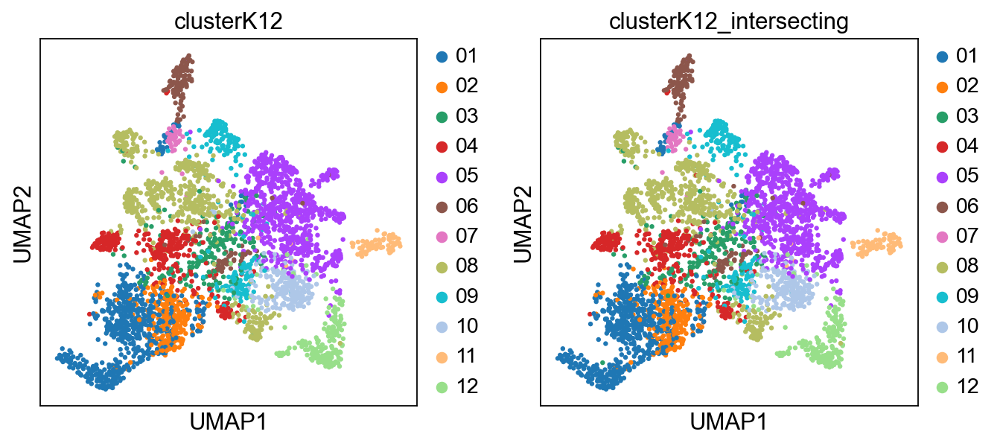

In [87]:
sc.pl.umap(smartseq, color=['clusterK12','clusterK12_intersecting'])

In [88]:
dict = {1: "01", 2: "02", 3: "03", 4: "04", 5: "05", 6: "06", 7: "07", 8: "08", 9: "09", 10: "10", 11: "11", 12: "12"}

In [89]:
from sklearn.metrics import accuracy_score
accuracy_score(smartseq.obs.replace({"clusterK12": dict})['clusterK12'], smartseq.obs['clusterK12_intersecting'])

0.9825

In [90]:
results_binary = logreg.predict(smartseq[:,names].X)
probs_binary = logreg.predict_proba(smartseq[:,names].X)

results_df_binary = pd.DataFrame()
results_df_binary['predicted'] = list(results_binary)

for x in range(0,12):
    results_df_binary[x+1] = [i[x] for i in list(probs_binary)]
results_df_binary['highest_prob'] =results_df_binary[[x+1 for x in range(0,12)]].max(axis=1)
results_df_binary

,predicted,1,2,3,4,5,6,7,8,9,10,11,12,highest_prob
0,11,8.796093e-14,2.660610e-11,3.404641e-11,3.026630e-14,1.161233e-08,8.333951e-12,2.247561e-09,7.060597e-12,2.067889e-12,8.387666e-11,1.000000e+00,2.995966e-10,1.000000
1,12,5.206856e-12,5.189690e-12,4.089516e-12,1.704494e-10,2.692326e-11,1.739873e-07,1.469114e-09,3.205880e-09,3.447484e-08,6.026923e-08,6.284009e-10,9.999997e-01,1.000000
2,05,1.277104e-03,1.892312e-07,5.771381e-04,5.244707e-08,9.981390e-01,2.467711e-06,8.452564e-07,1.240774e-10,8.765880e-08,5.671729e-07,7.266742e-07,1.871464e-06,0.998139
3,10,1.460946e-07,4.149387e-07,3.092091e-07,2.038255e-03,1.043945e-07,5.870702e-06,3.268425e-06,3.279166e-03,1.131351e-06,9.946589e-01,1.320579e-06,1.109795e-05,0.994659
4,01,9.999960e-01,2.136095e-09,1.033843e-06,2.766485e-06,3.137071e-09,2.620481e-08,2.801411e-08,2.387854e-11,9.013663e-13,2.144803e-09,1.442870e-07,2.609028e-09,0.999996
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3595,08,7.631595e-11,1.041708e-07,7.548215e-09,5.216491e-08,2.053247e-09,4.641840e-09,2.989691e-07,9.999894e-01,1.002500e-05,1.048341e-07,2.522326e-08,2.464661e-09,0.999989
3596,09,4.504296e-08,7.408408e-07,9.989865e-08,1.147848e-07,6.539311e-07,6.667240e-08,1.581373e-06,7.037236e-04,9.992910e-01,3.585687e-07,1.438028e-06,2.188238e-07,0.999291
3597,08,9.116719e-09,4.183248e-07,2.151318e-08,7.855839e-06,1.198864e-09,2.346832e-08,2.143866e-06,9.998178e-01,1.702475e-04,9.455757e-07,3.893059e-07,1.018315e-07,0.999818
3598,08,8.957867e-09,4.388338e-06,3.305323e-06,2.245562e-06,6.270319e-04,8.931110e-07,1.535183e-05,9.992576e-01,4.841118e-05,3.318618e-05,4.716440e-06,2.849941e-06,0.999258


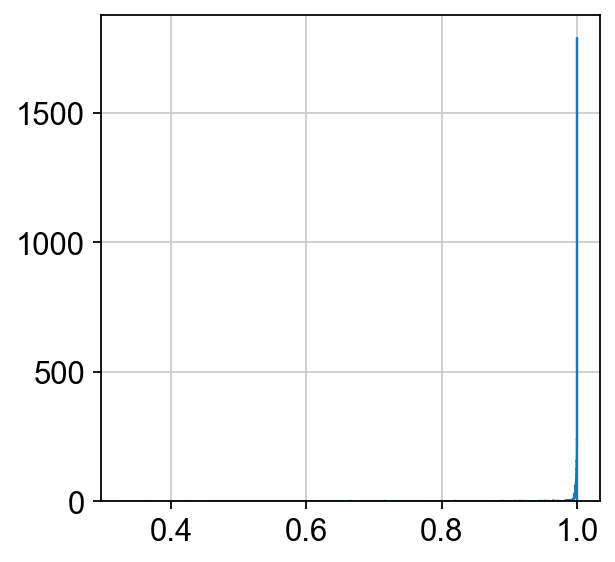

In [91]:
_ = plt.hist(results_df_binary['highest_prob'], bins='auto', histtype='step')

### End LogisticRegression

In [92]:
adata_ordered_genes = [adata_names.index(x) for x in names]

In [93]:
adata_log_ordered = adata_log[:,adata_ordered_genes]

In [94]:
y_pred = logreg.predict(adata_log_ordered.X)

In [95]:
adata_log_ordered.obs['clusterK12'] = [x for x in y_pred]
adata_log_ordered.obs['clusterK12'] = adata_log_ordered.obs['clusterK12'].astype('category')

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_50885/3908199522.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_log_ordered.obs['clusterK12'] = [x for x in y_pred]


In [96]:
#reset size
from matplotlib import rcParams
FIGSIZE=(4,4)
rcParams['figure.figsize']=FIGSIZE

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector

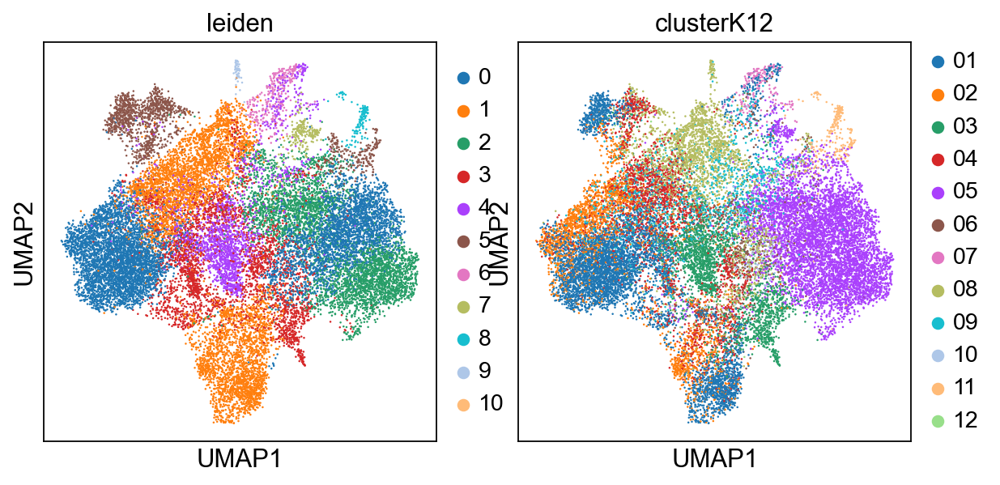

In [97]:
sc.pl.umap(adata_log_ordered,color=['leiden','clusterK12'], wspace=0.1)

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


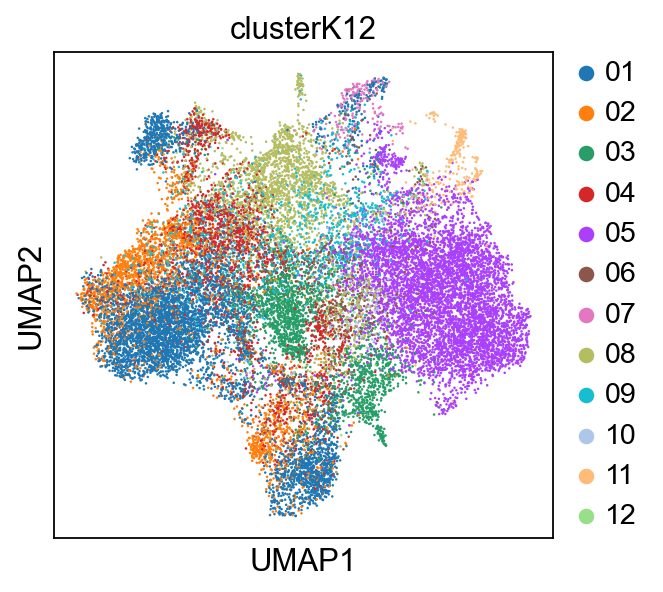

In [98]:
sc.pl.umap(adata_log_ordered,color=['clusterK12'])

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


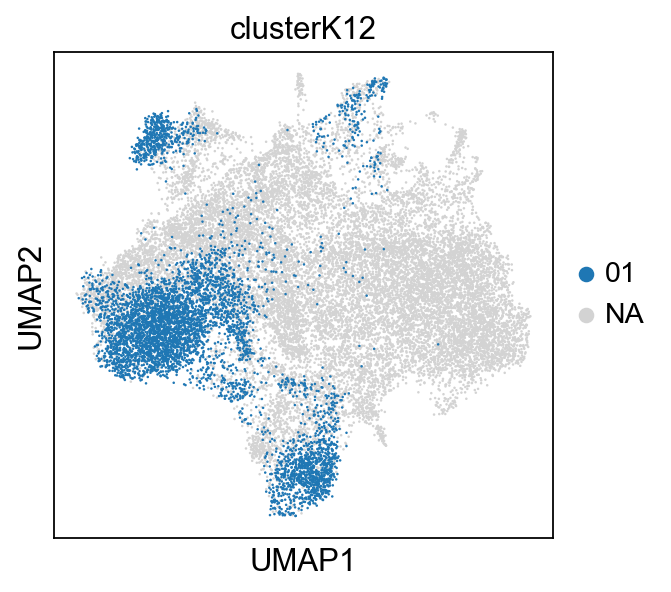

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


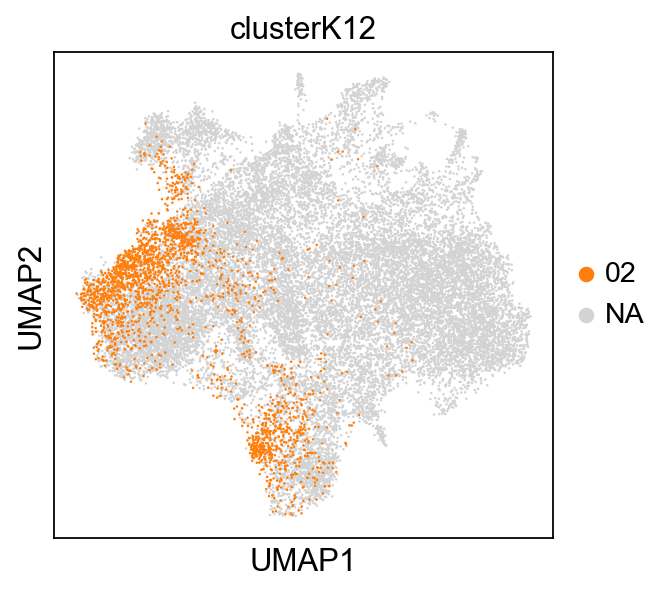

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


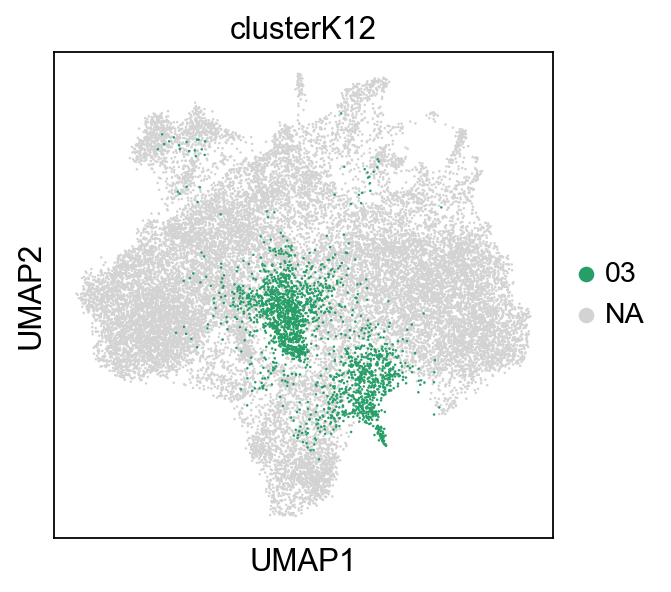

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


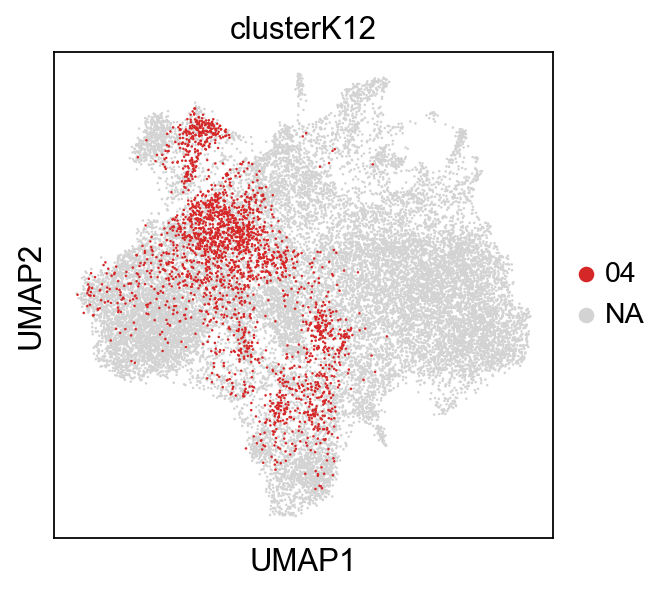

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


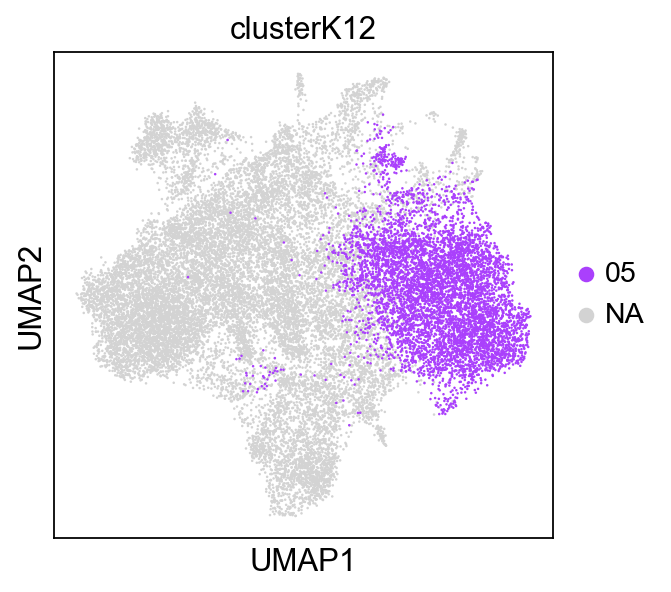

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


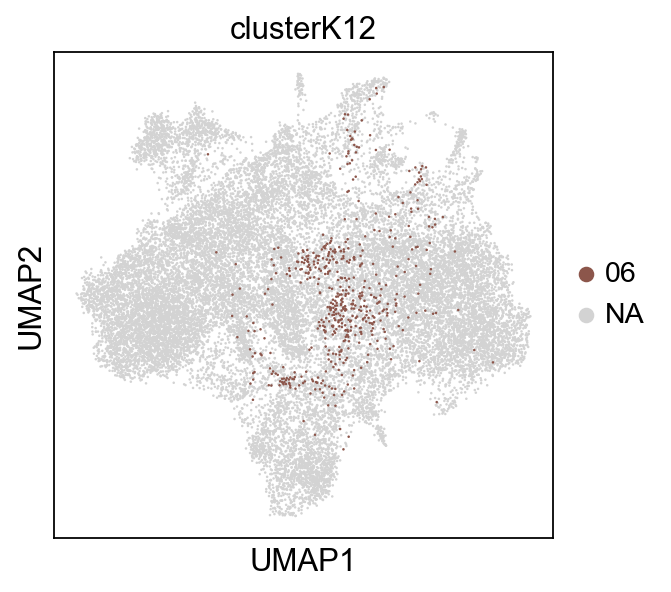

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


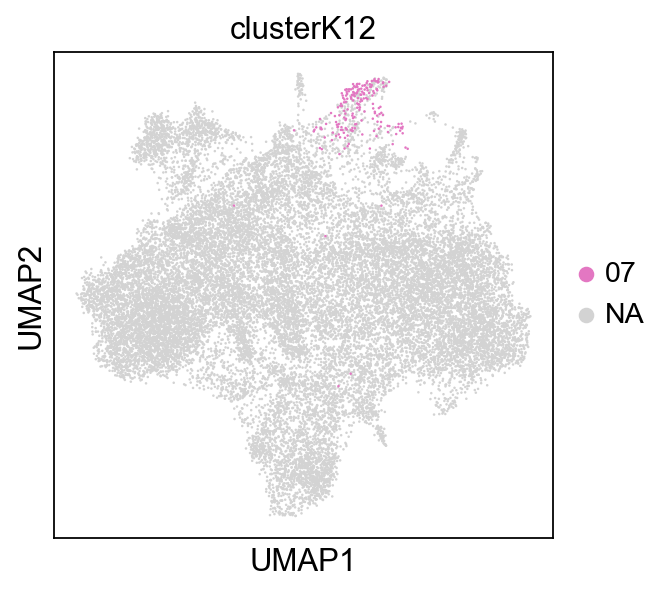

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


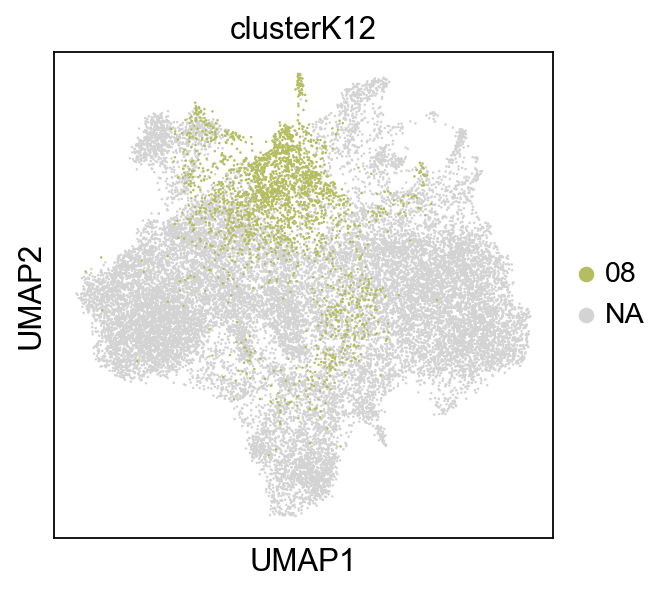

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


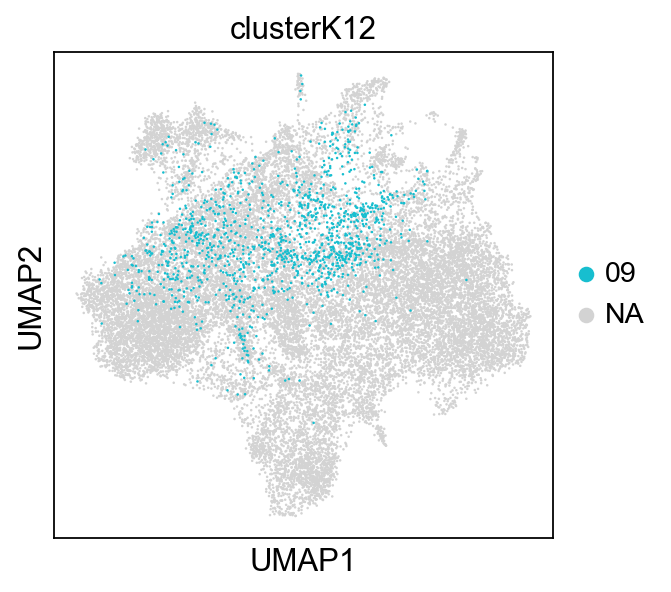

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


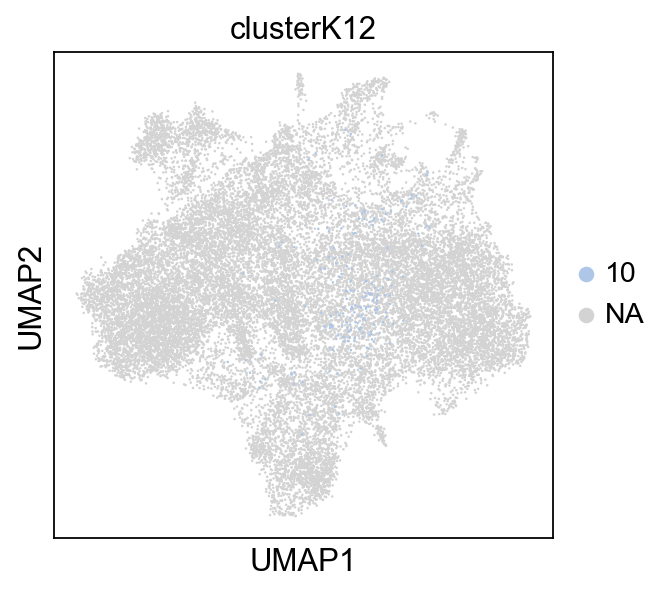

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


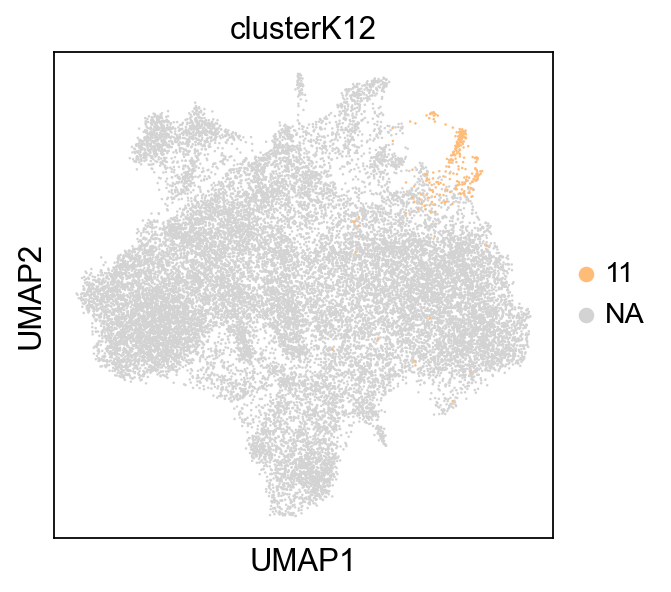

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


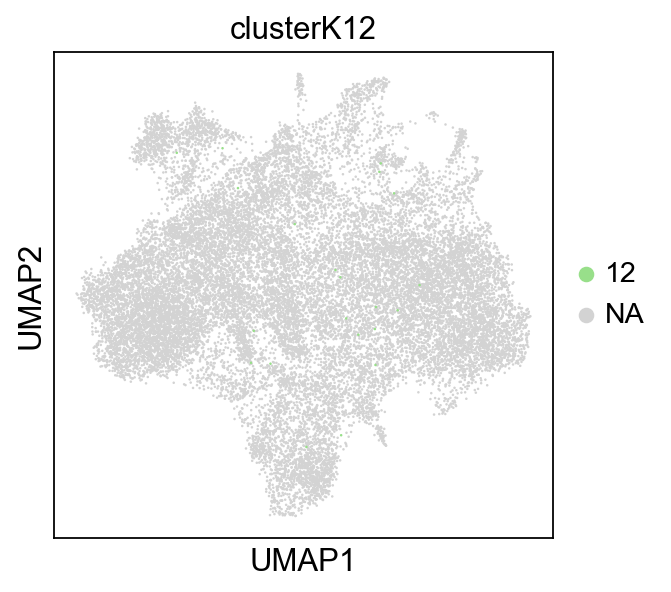

In [99]:
for x in adata_log_ordered.obs.clusterK12.cat.categories:
    sc.pl.umap(adata_log_ordered,color=['clusterK12'], groups=[x])

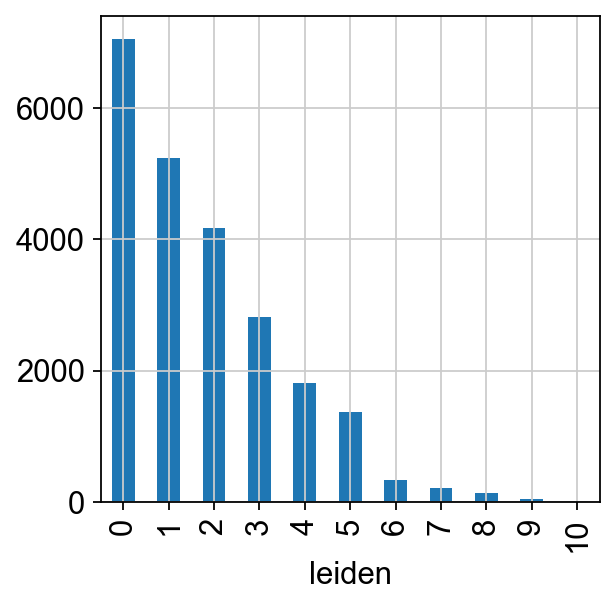

In [100]:
 cell_proportion_df = adata_log_ordered.obs.leiden.value_counts().T.plot(kind='bar', stacked=True, legend=False)

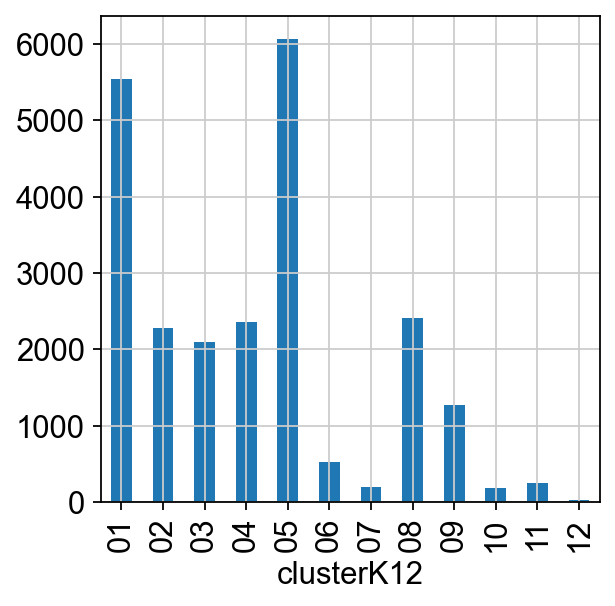

In [101]:
 cell_proportion_df = adata_log_ordered.obs.clusterK12.value_counts(sort=False).T.plot(kind='bar', stacked=True, legend=False)

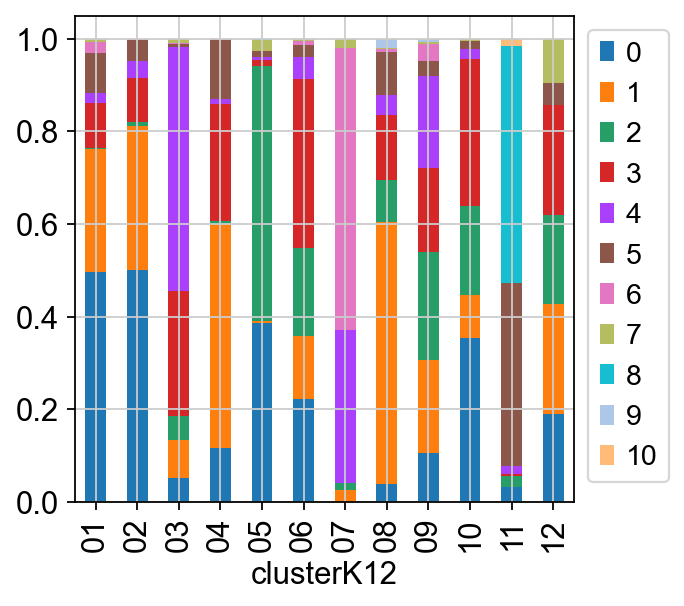

In [102]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['leiden'],adata_log_ordered.obs['clusterK12'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

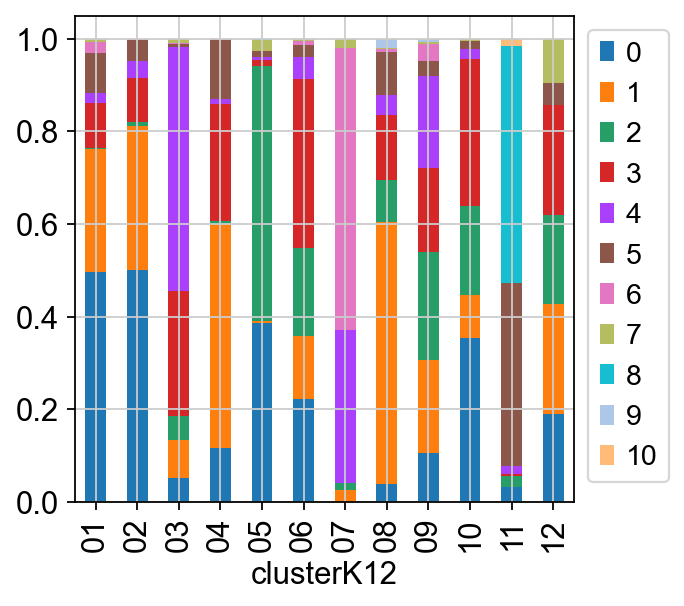

In [103]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['leiden'],adata_log_ordered.obs['clusterK12'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

In [104]:
results_binary = logreg.predict(adata_log_ordered.X)
probs_binary = logreg.predict_proba(adata_log_ordered.X)

results_df_binary = pd.DataFrame()
results_df_binary['predicted'] = list(results_binary)
#results_df_binary['actual'] = list(smartseq.obs['clusterK12'])
for x in range(0,12):
    results_df_binary[x+1] = [i[x] for i in list(probs_binary)]
results_df_binary['highest_prob'] =results_df_binary[[x+1 for x in range(0,12)]].max(axis=1)
results_df_binary

,predicted,1,2,3,4,5,6,7,8,9,10,11,12,highest_prob
0,03,4.181836e-05,2.051069e-02,8.801221e-01,1.816365e-03,1.136786e-03,5.691973e-02,5.823041e-04,1.441190e-03,1.112380e-02,2.262956e-02,2.362155e-03,1.313477e-03,0.880122
1,01,6.035238e-01,1.218105e-03,4.246199e-04,3.568736e-01,5.461536e-06,8.692169e-04,3.859016e-03,1.633329e-02,9.373311e-03,4.586396e-03,1.648853e-03,1.284357e-03,0.603524
2,01,3.383568e-01,5.573857e-03,7.765702e-03,1.224813e-01,1.092667e-04,1.672986e-01,5.876849e-03,8.028986e-02,1.909472e-01,4.078386e-02,6.518939e-03,3.399773e-02,0.338357
3,03,1.279987e-03,7.939456e-04,6.778226e-01,6.805226e-04,6.218270e-02,6.460954e-03,4.216613e-03,4.407189e-02,1.569311e-01,3.623199e-02,2.710146e-03,6.617644e-03,0.677823
4,08,2.103866e-05,8.709911e-06,4.110305e-04,2.255977e-04,8.763023e-06,1.889363e-04,3.387323e-04,9.950562e-01,2.707657e-05,2.455918e-03,8.654778e-05,1.171414e-03,0.995056
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23204,05,4.064138e-10,1.476816e-07,1.292763e-07,7.428511e-10,9.999612e-01,3.317462e-07,1.563374e-06,1.339329e-08,3.848165e-07,2.936106e-07,2.884850e-05,7.123490e-06,0.999961
23205,05,2.935493e-10,1.054614e-07,3.662899e-08,2.381187e-08,9.999798e-01,6.502630e-06,4.286958e-07,3.172954e-10,6.433622e-08,1.272637e-06,8.420237e-06,3.321051e-06,0.999980
23206,09,4.567959e-05,2.633240e-03,4.308908e-03,4.410238e-04,1.459259e-02,4.399983e-02,6.599775e-03,3.193807e-02,7.290507e-01,1.553318e-01,7.452731e-03,3.605685e-03,0.729051
23207,04,1.022492e-09,2.979530e-05,1.346434e-07,9.985350e-01,2.701531e-10,3.835137e-07,8.437612e-07,1.412766e-03,6.228777e-08,2.050970e-05,2.222708e-07,2.581273e-07,0.998535


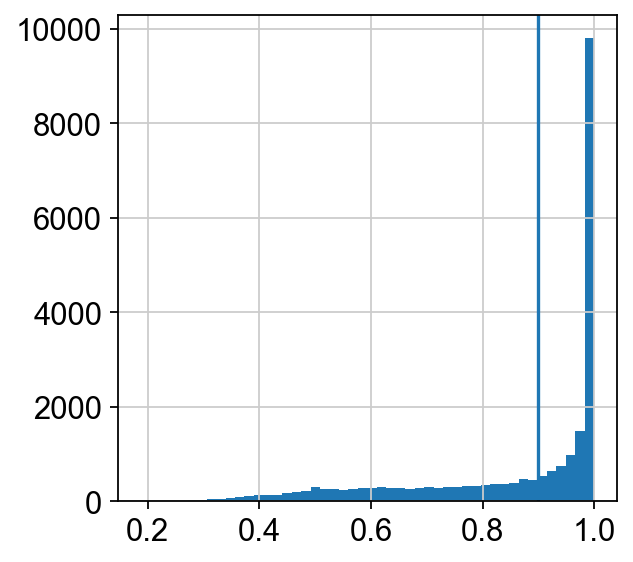

In [105]:
_ = plt.hist(results_df_binary['highest_prob'], bins='auto')
plt.axvline(x=0.9)

In [106]:
results_df_binary['bin'] = pd.qcut(results_df_binary['highest_prob'], q=7)
idx = pd.IntervalIndex(results_df_binary['bin'])
results_df_binary['low'] = idx.left
results_df_binary['high'] = idx.right
results_df_binary['prob range'] = results_df_binary['low'].round(2).astype(str) + "-" + results_df_binary['high'].round(2).astype(str)
df_bins_grouped = results_df_binary[['low','high','prob range']].groupby('prob range').mean().reset_index()
df_bins_grouped

,prob range,low,high
0,0.19-0.61,0.18700,0.60900
1,0.61-0.8,0.60900,0.79730
2,0.8-0.93,0.79730,0.92660
3,0.93-0.98,0.92660,0.98180
4,0.98-1.0,0.98180,0.99760
5,1.0-1.0,0.99875,0.99995


In [107]:
cutoff = 0.8
adata_log_ordered.obs['clusterK12_stringent'] = 'other'
adata_log_ordered.obs['clusterK12_stringent'][np.array(results_df_binary['highest_prob'] >= cutoff)] = ["%02d" % y for y in results_df_binary[[x+1 for x in range(0,12)]].idxmax(axis=1)[np.array(results_df_binary['highest_prob'] >= cutoff)].to_numpy()]

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_50885/4020989001.py:3: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata_log_ordered.obs['clusterK12_stringent'][np.array(results_df_binary['highest_prob'] >= cutoff)] = ["%02d" % 

In [108]:
adata_log_ordered.obs['clusterK12_stringent']

AAACCCAGTAGCGTAG-1-14wk-traced-0       03
AAACGAATCAAGTCGT-1-14wk-traced-0    other
AAAGAACAGATGACAT-1-14wk-traced-0    other
AAAGGGCTCACTTGTT-1-14wk-traced-0    other
AAAGGTATCCATAGGT-1-14wk-traced-0       08
                                    ...  
TGTGCATGTCTGGCTA-1-1-1                 05
TGTGCATGTGGCTGCT-1-1-1                 05
TGTGCCTCATTAGATG-1-1-1              other
TGTGCTGGTATGGTTC-1-1-1                 04
TGTGGTTGTCTAGCTG-1-1-1                 05
Name: clusterK12_stringent, Length: 23209, dtype: object

In [109]:
adata_log_ordered.obs['clusterK12_stringent'] = adata_log_ordered.obs['clusterK12_stringent'].astype('category')

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector

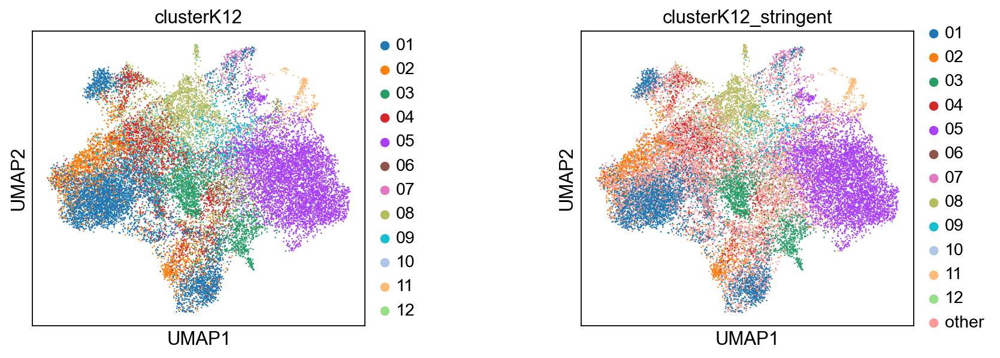

In [110]:
sc.pl.umap(adata_log_ordered, color=['clusterK12', 'clusterK12_stringent'], wspace=0.5)

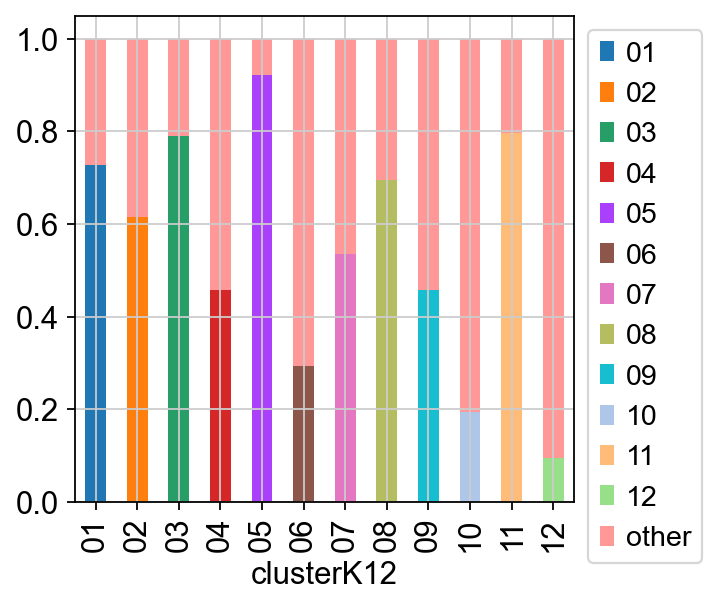

In [111]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['clusterK12_stringent'],adata_log_ordered.obs['clusterK12'],normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

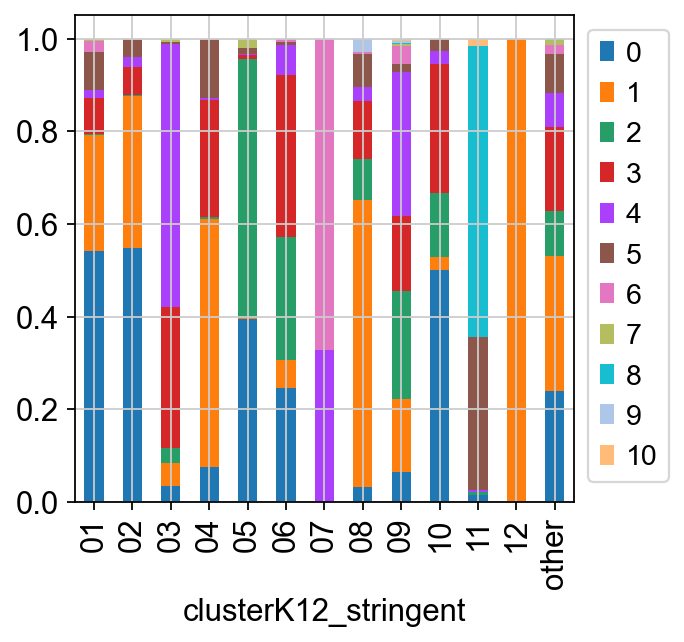

In [112]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['leiden'],adata_log_ordered.obs['clusterK12_stringent'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

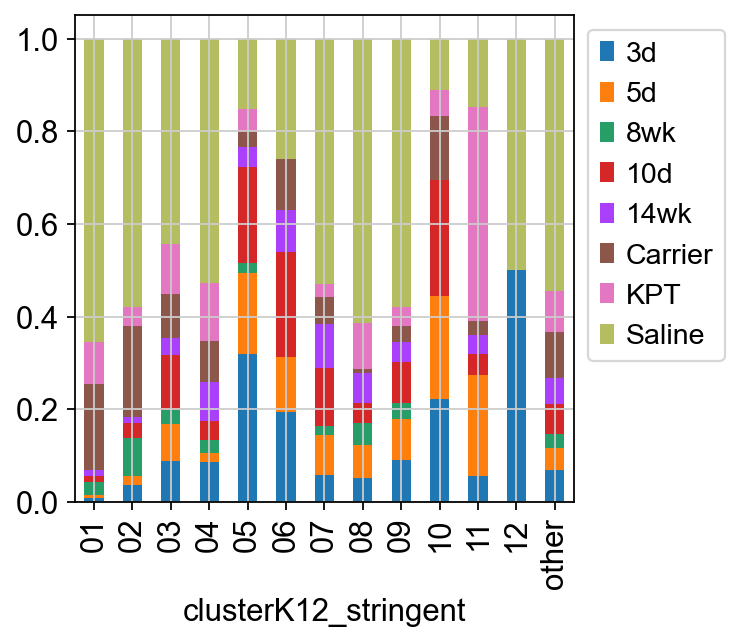

In [113]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['Group'],adata_log_ordered.obs['clusterK12_stringent'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_matrixplot.py:143: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  values_df = self.obs_tidy.groupby(level=0).mean()


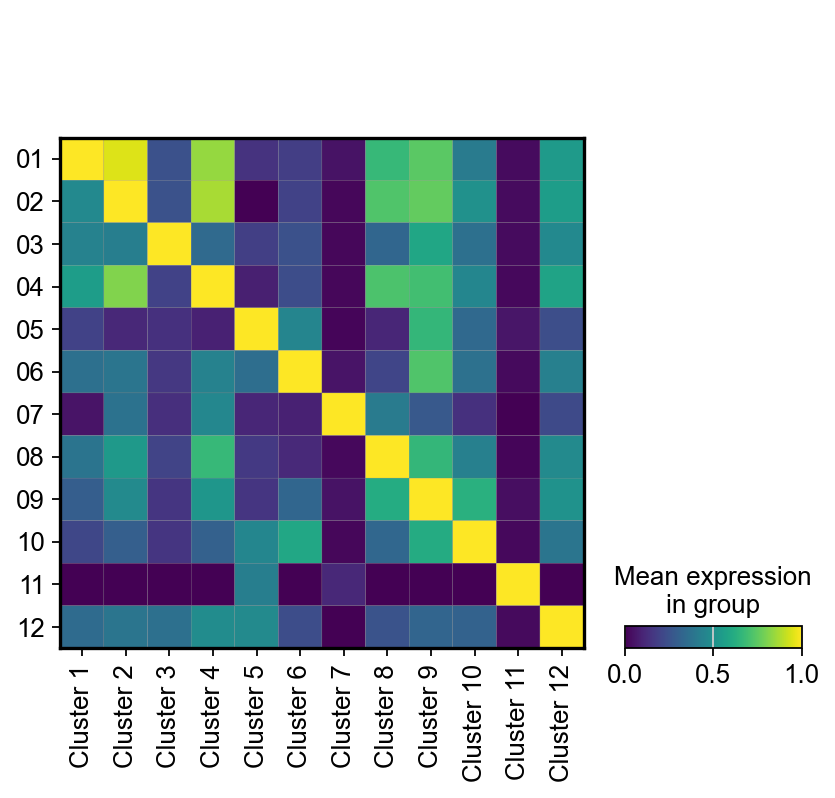

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_matrixplot.py:143: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  values_df = self.obs_tidy.groupby(level=0).mean()


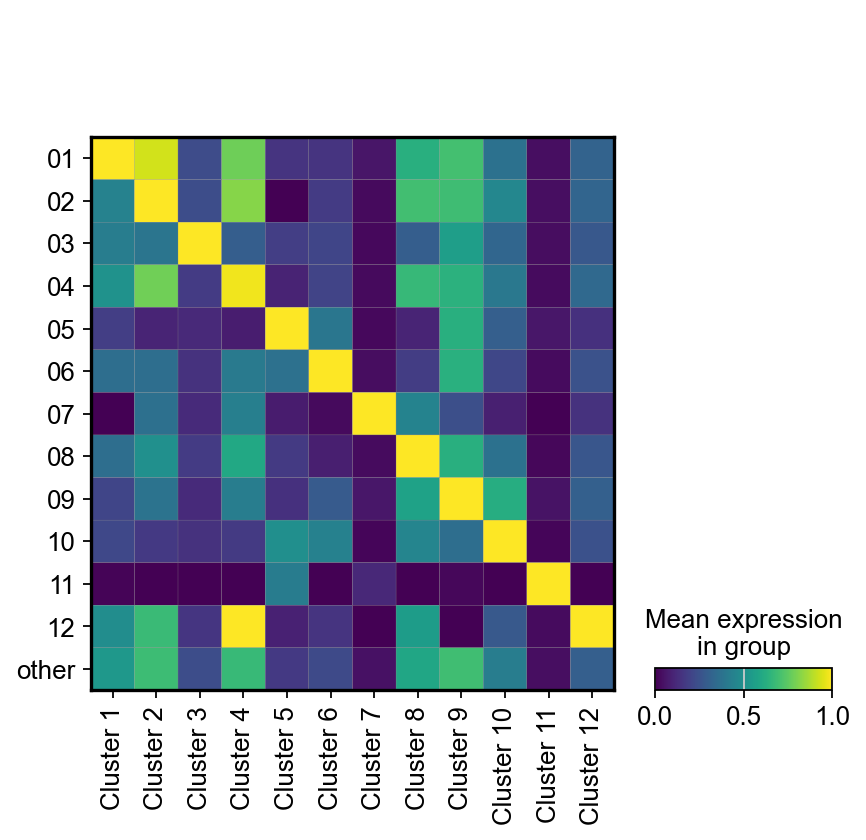

In [114]:
cancerCell = ['Cluster 1', 'Cluster 2','Cluster 3','Cluster 4','Cluster 5','Cluster 6', 'Cluster 7', 
              'Cluster 8', 'Cluster 9', 'Cluster 10', 'Cluster 11', 'Cluster 12']
#cell_proportion_df = pd.crosstab(adata_log_ordered.obs['Cluster 1'],adata_log_ordered.obs['clusterK12']).T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))
sc.pl.matrixplot(adata_log_ordered, cancerCell, 'clusterK12', standard_scale='var')
sc.pl.matrixplot(adata_log_ordered, cancerCell, 'clusterK12_stringent', standard_scale='var')

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


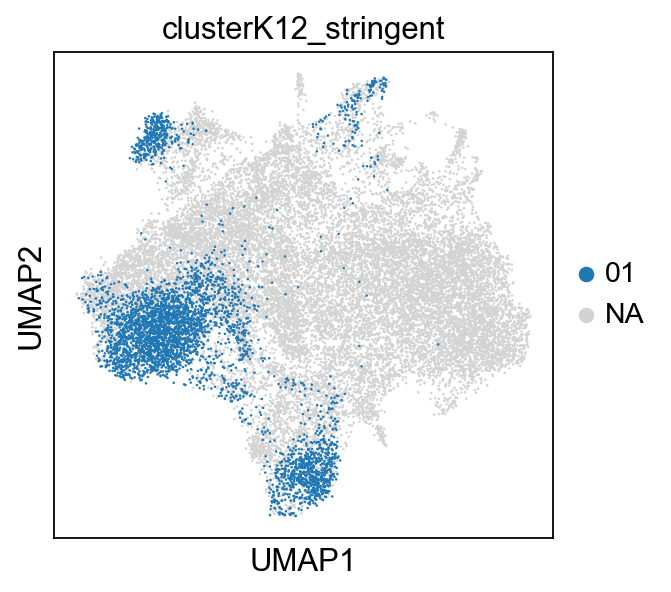

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


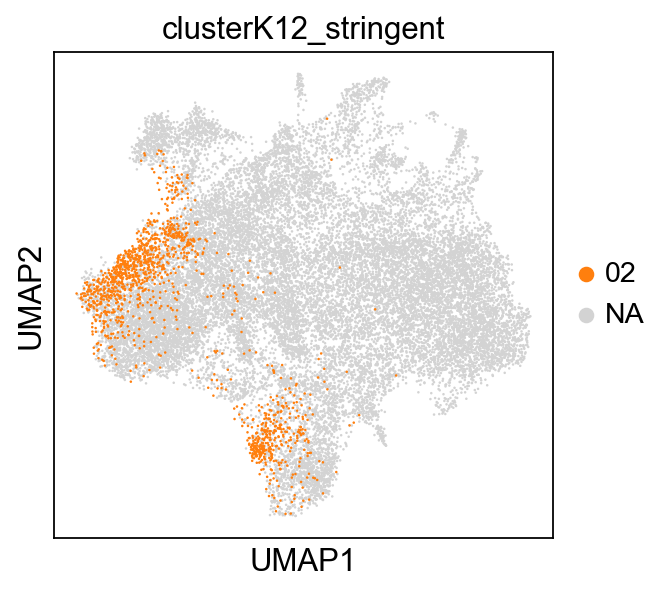

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


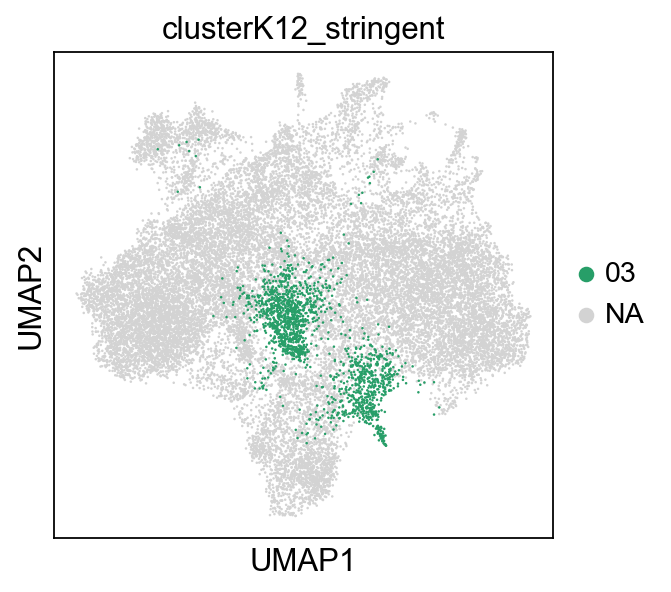

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


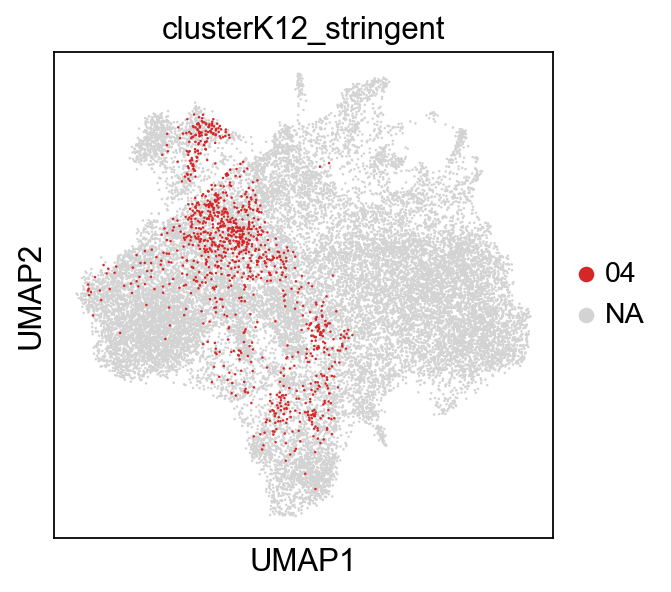

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


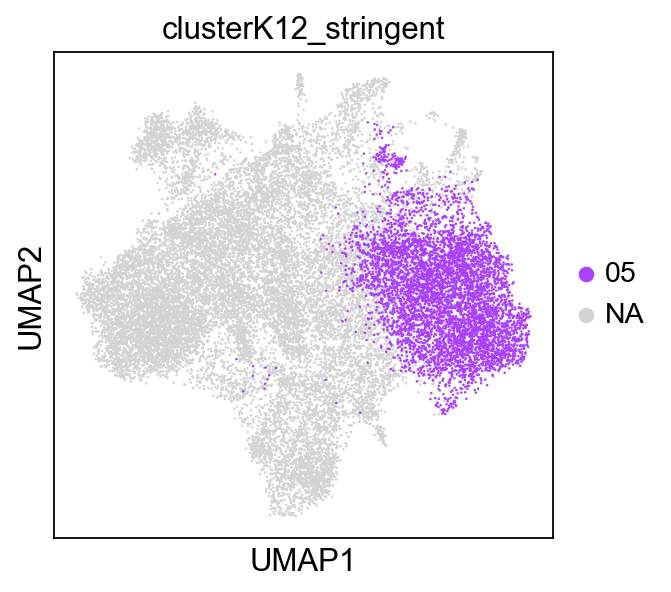

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


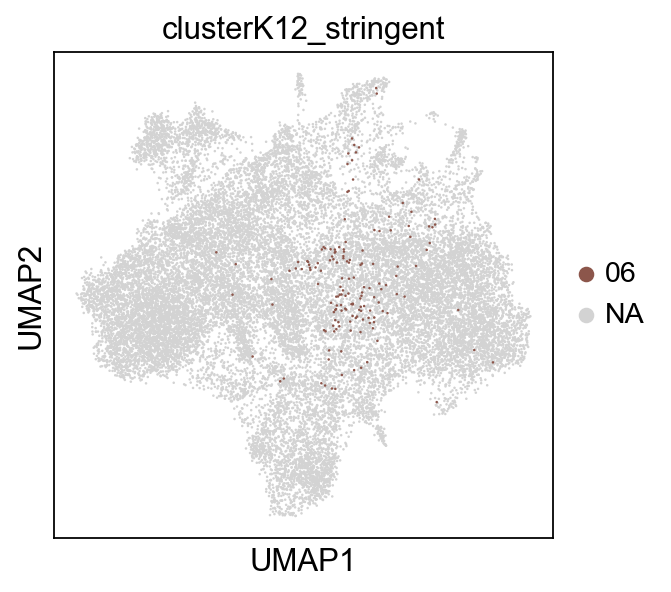

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


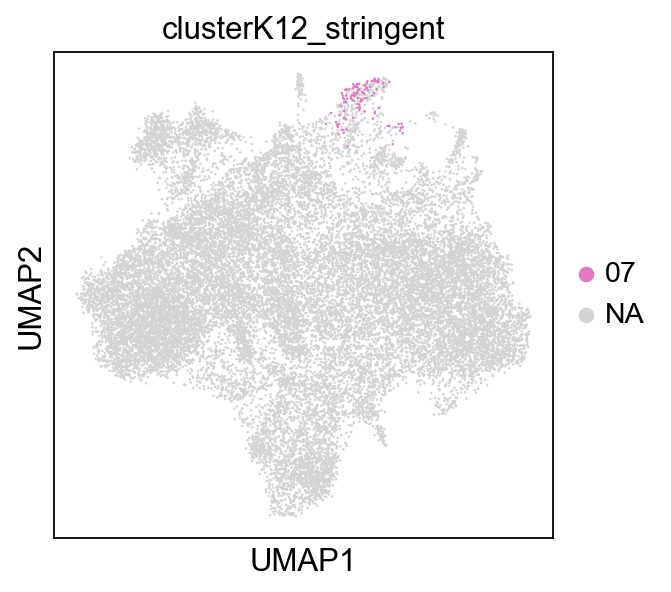

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


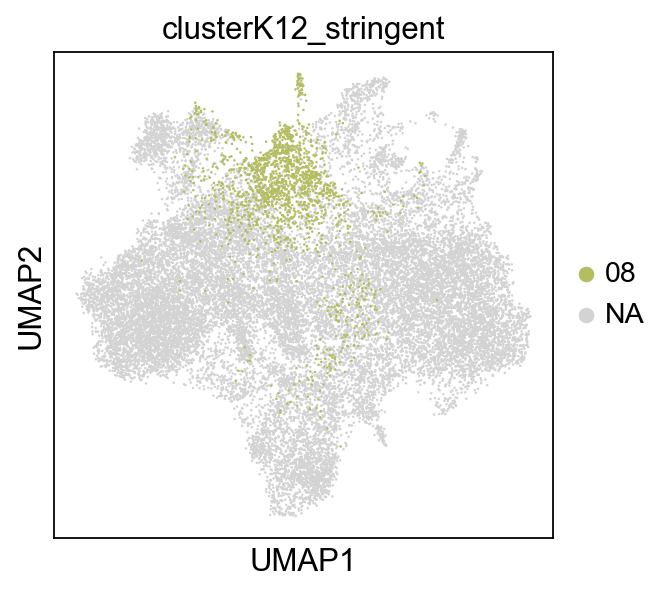

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


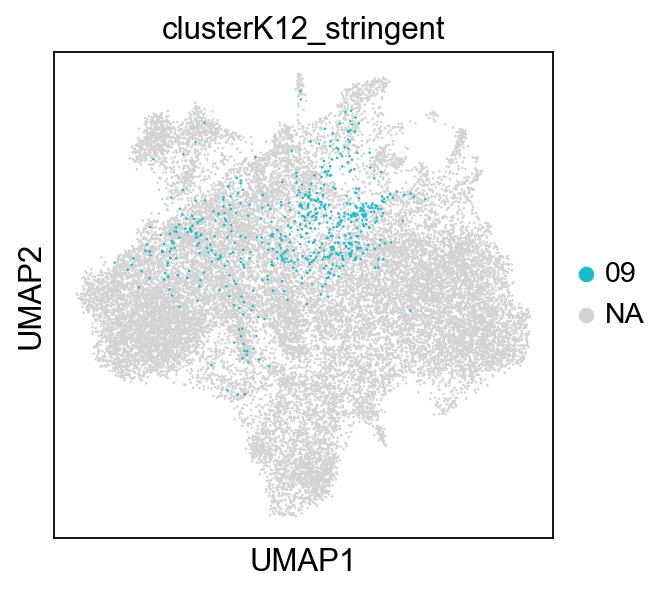

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


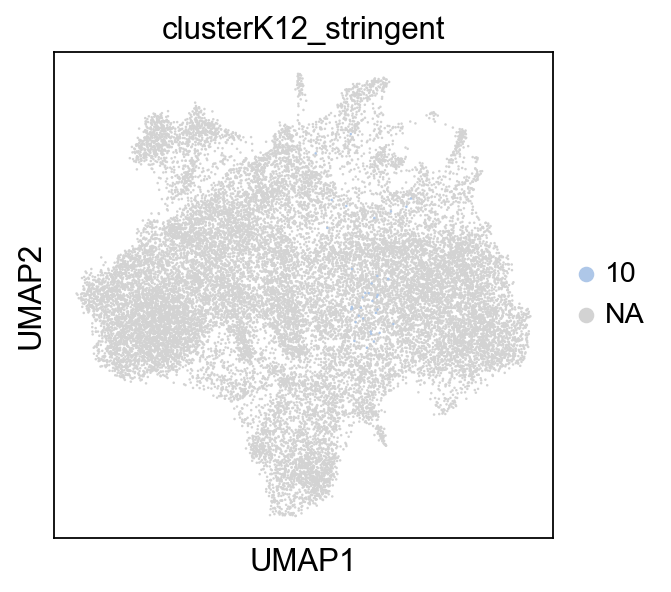

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


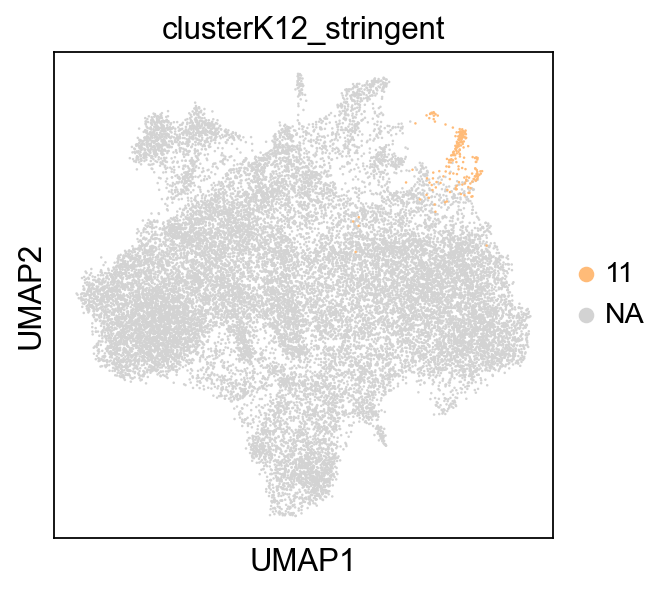

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


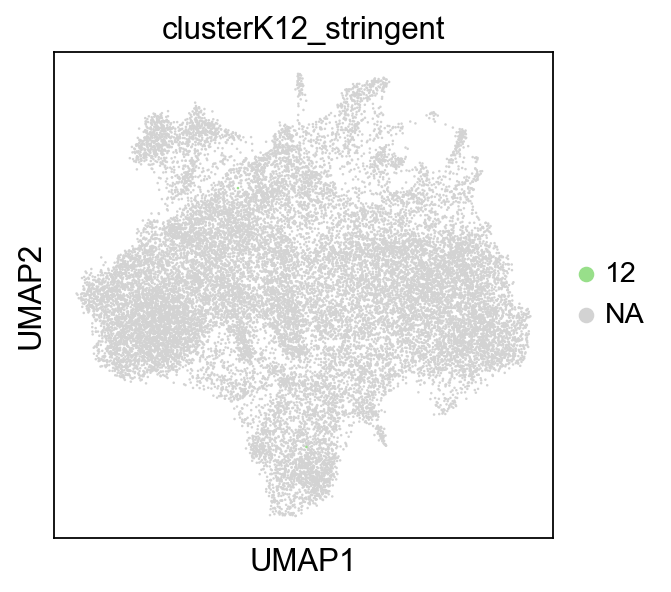

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


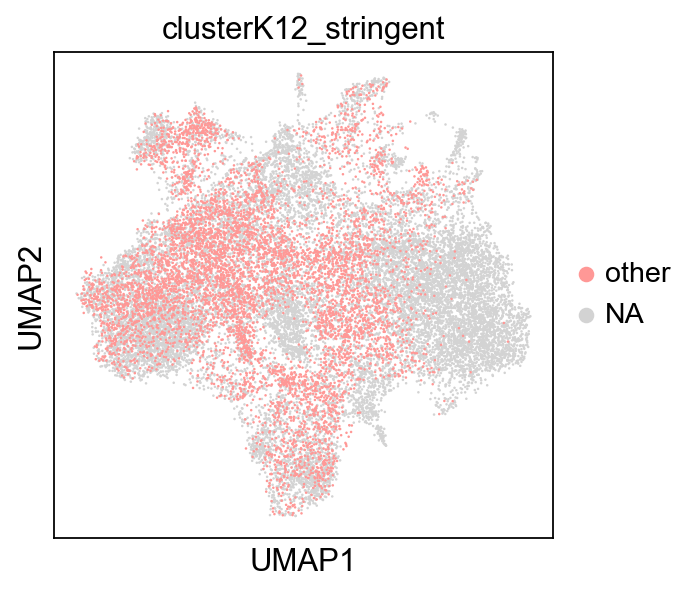

In [115]:
for x in adata_log_ordered.obs.clusterK12_stringent.cat.categories:
    # skip if NA
    sc.pl.umap(adata_log_ordered, color='clusterK12_stringent', groups=[x])

In [116]:
cancerCell = ['Cluster 1', 'Cluster 2','Cluster 3','Cluster 4','Cluster 5','Cluster 6', 'Cluster 7', 
              'Cluster 8', 'Cluster 9', 'Cluster 10', 'Cluster 11', 'Cluster 12']

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_stacked_violin.py:324: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  _color_df = _matrix.groupby(level=0).median()
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_stacked_violin.py:405: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the What's New notes for pandas 2.1.0 for details. Specify future_stack=True to adopt the new implementation and silence this warning.
  pd.DataFrame(_matrix.stack(dropna=False))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_stacked_violin.py:461: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and wil

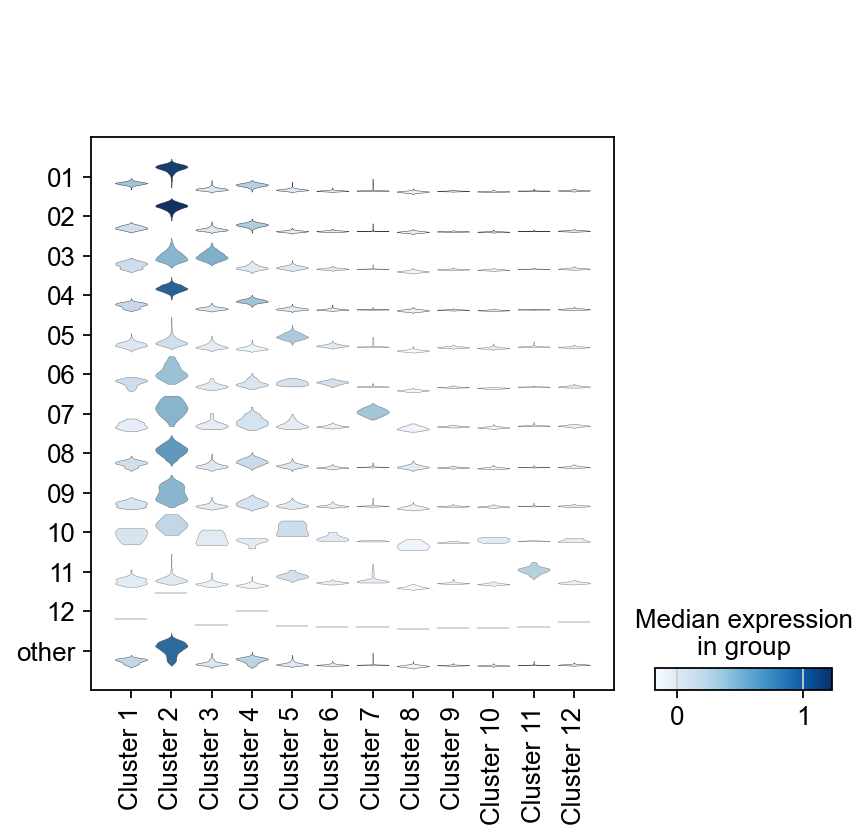

In [117]:
sc.pl.stacked_violin(adata_log_ordered, cancerCell, groupby='clusterK12_stringent')

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will b

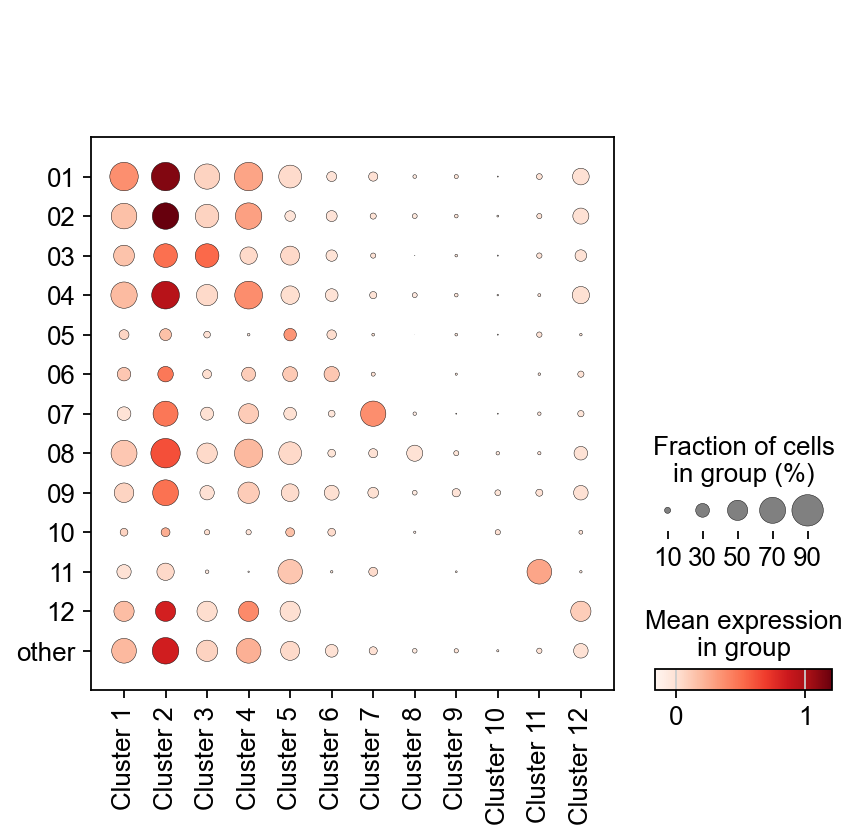

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will b

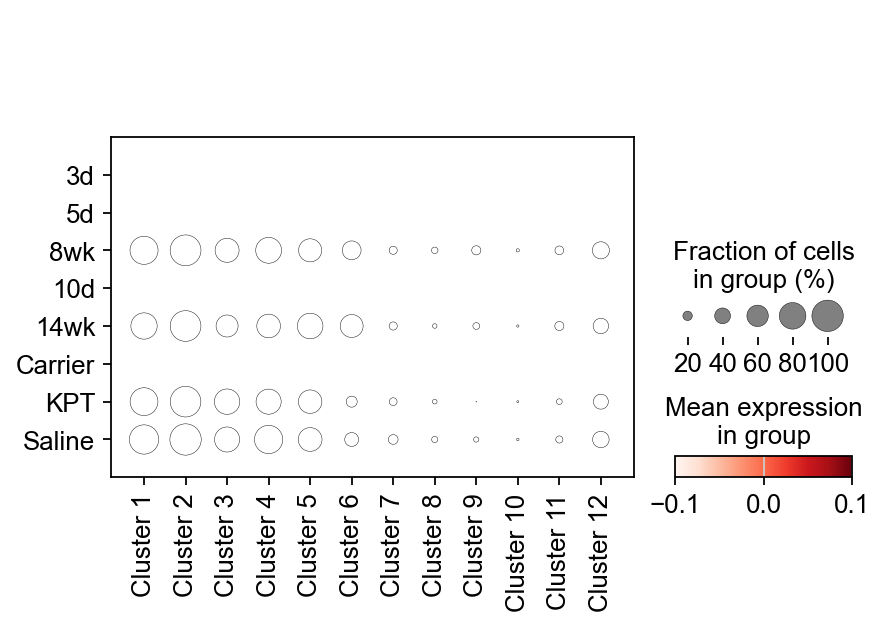

In [118]:
sc.pl.dotplot(adata_log_ordered, [*cancerCell], groupby='clusterK12_stringent')
sc.pl.dotplot(adata_log_ordered, [*cancerCell], groupby='Group')

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_matrixplot.py:143: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  values_df = self.obs_tidy.groupby(level=0).mean()


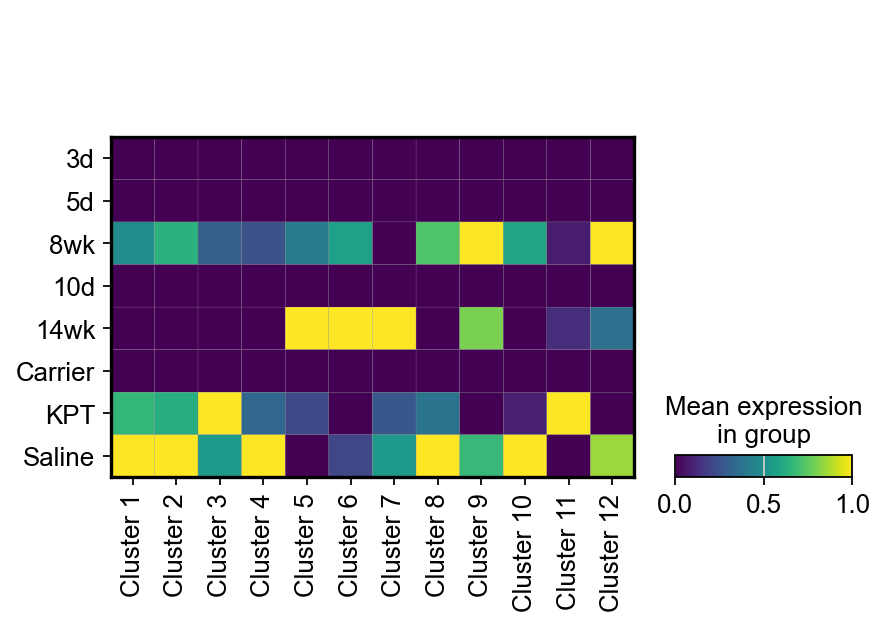

In [119]:
sc.pl.matrixplot(adata_log_ordered, [*cancerCell], groupby='Group',standard_scale='var')
#sc.pl.matrixplot(adata_log_ordered, cancerCell, groupby='Group',standard_scale='var')

In [120]:
adata_concat.obs['clusterK12'] = adata_log_ordered.obs['clusterK12'].astype('category')
adata_concat.obs['clusterK12_stringent'] = adata_log_ordered.obs['clusterK12_stringent'].astype('category')

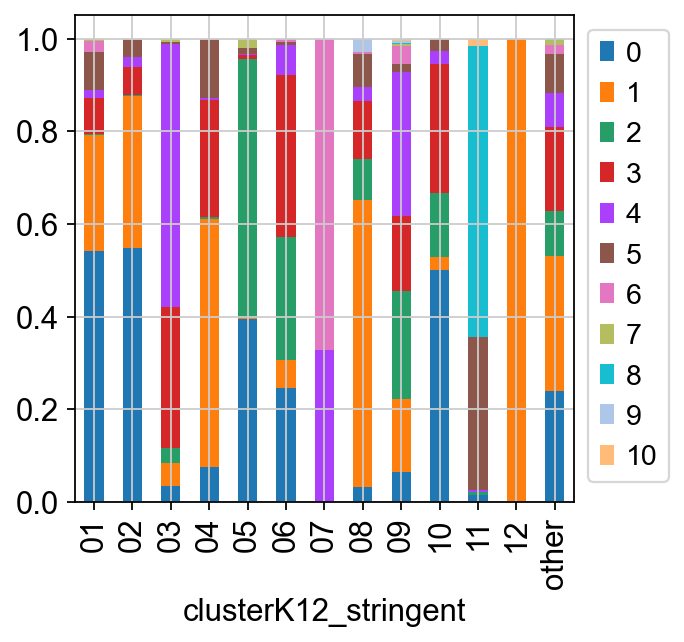

In [121]:
 cell_proportion_df = pd.crosstab(adata_concat.obs['leiden'],adata_log_ordered.obs['clusterK12_stringent'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

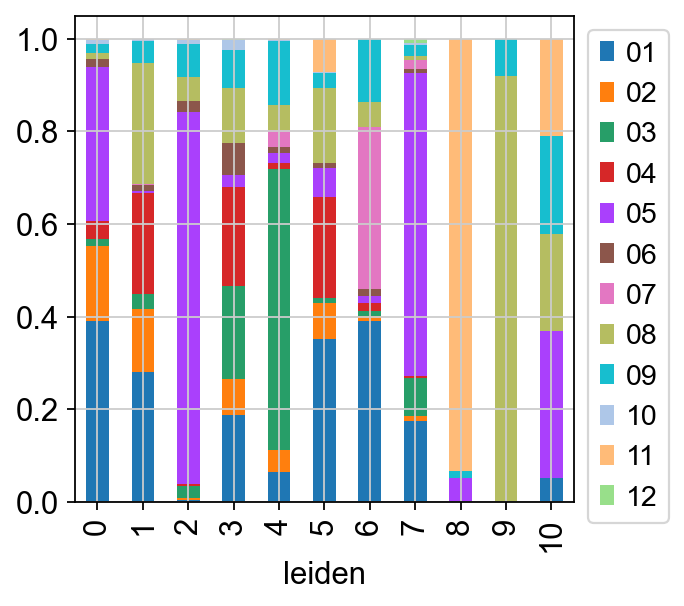

In [122]:
 cell_proportion_df = pd.crosstab(adata_concat.obs['clusterK12'],adata_log_ordered.obs['leiden'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

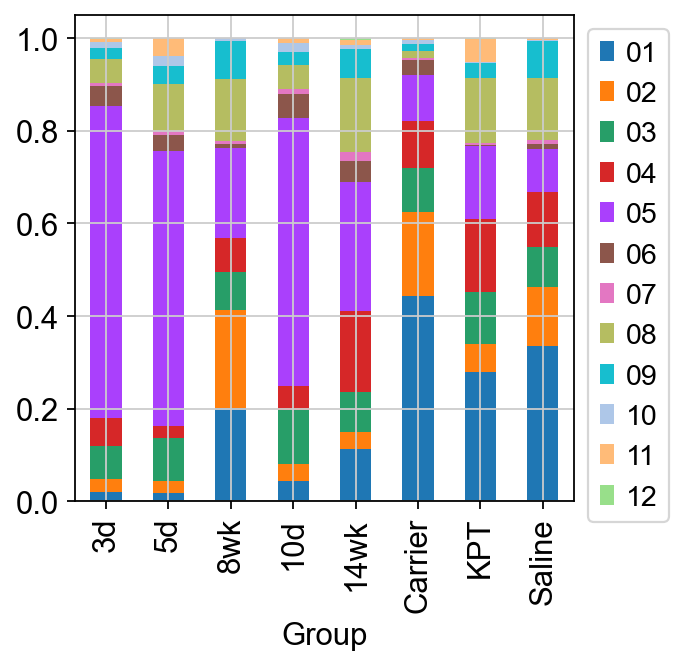

In [123]:
 cell_proportion_df = pd.crosstab(adata_concat.obs['clusterK12'],adata_log_ordered.obs['Group'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector

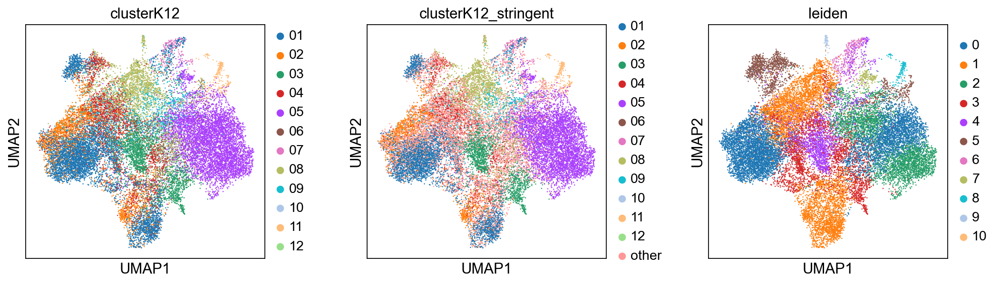

In [124]:
sc.pl.umap(adata_concat, color=['clusterK12', 'clusterK12_stringent','leiden'], wspace=0.3)

### End Logistic Regression

In [125]:
sc.tl.embedding_density(adata_concat,basis='umap', groupby='clusterK12')

computing density on 'umap'
--> added
    'umap_density_clusterK12', densities (adata.obs)
    'umap_density_clusterK12_params', parameter (adata.uns)


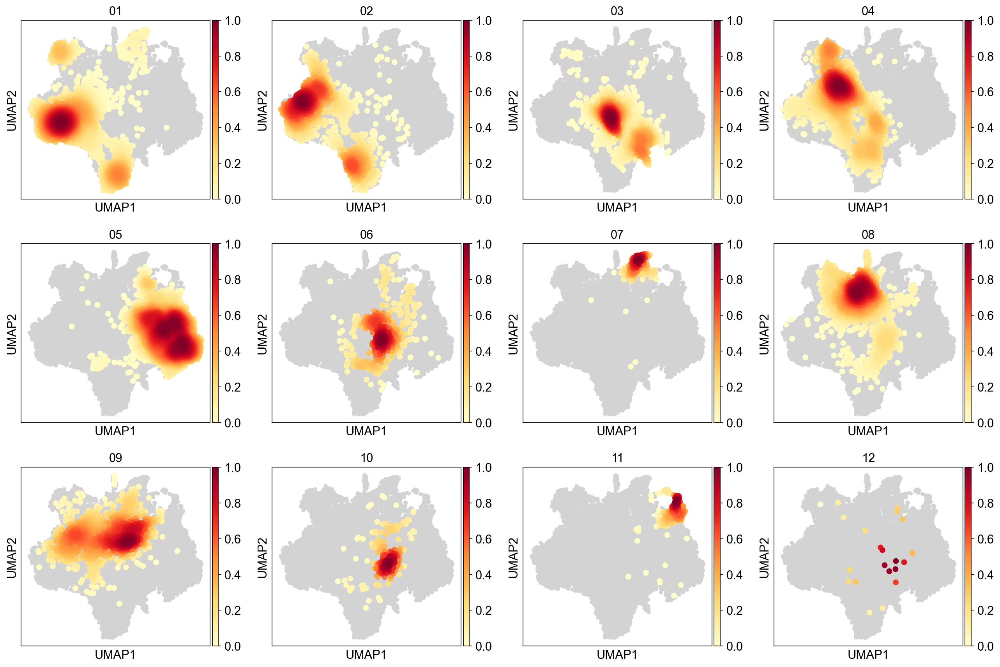

In [126]:
sc.pl.embedding_density(adata_concat,basis='umap',key='umap_density_clusterK12')

### Try ingestion

In [127]:
var_names = adata_orig.var_names.intersection(adata2.var_names)
adata_ref = adata_orig[:, var_names]
adata3 = adata2[:, var_names]

In [128]:
sc.pp.highly_variable_genes(adata_ref, batch_key='batch')

extracting highly variable genes


/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/preprocessing/_highly_variable_genes.py:226: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  disp_grouped = df.groupby("mean_bin")["dispersions"]
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/preprocessing/_highly_variable_genes.py:226: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  disp_grouped = df.groupby("mean_bin")["dispersions"]
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/preprocessing/_highly_variable_genes.py:226: FutureWarning: The default of observed=False i

    finished (0:00:06)


/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/preprocessing/_highly_variable_genes.py:508: FutureWarning: The provided callable <function nanmean at 0x105d7cd60> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  df = df.groupby("gene").agg(
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/preprocessing/_highly_variable_genes.py:508: FutureWarning: The provided callable <function nanmean at 0x105d7cd60> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  df = df.groupby("gene").agg(
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/preprocessing/_highly_variable_genes.py:508: FutureWarning: The provided callable <function nansum at 0x105d7c860> is current

--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


In [129]:
adata_ref.var.highly_variable = adata_ref.var.highly_variable_intersection

In [130]:
#Ensure marker genes aren't making an impact to highly variable gene analysis downstream
adata_ref.var.highly_variable['EGFP'] = False
adata_ref.var.highly_variable['mScarlet'] = False
adata_ref.var.highly_variable['Cre'] = False
adata_ref.var.highly_variable['ERT'] = False
adata_ref.var.highly_variable['iDTR'] = False
adata_ref.var.highly_variable['tagBFP'] = False
adata_ref.var.highly_variable['mKate2'] = False
adata_ref.var.highly_variable['Akaluc'] = False
adata_ref.var.highly_variable['tdTomato'] = False

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_50885/3000869962.py:2: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata_ref.var.highly_variable['EGFP'] = False
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_50885/30

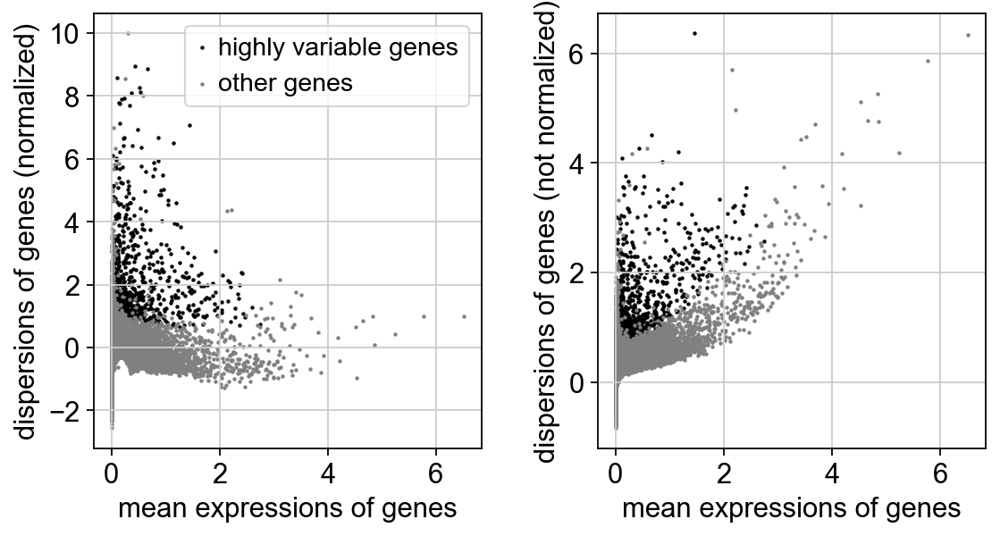

In [131]:
sc.pl.highly_variable_genes(adata_ref)

In [132]:
adata_ref.raw = adata_ref

In [133]:
sc.pp.scale(adata_ref, max_value=10)

... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


In [134]:
sc.tl.pca(adata_ref, svd_solver='arpack', n_comps=150)

computing PCA
    on highly variable genes
    with n_comps=150
    finished (0:00:01)


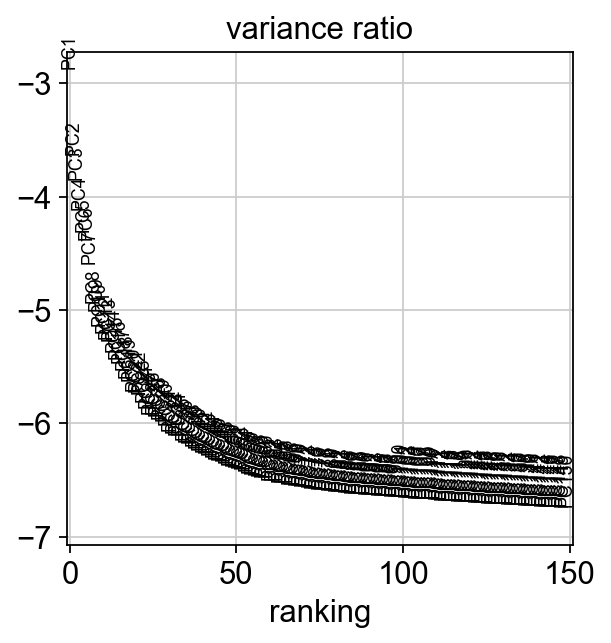

In [135]:
sc.pl.pca_variance_ratio(adata_ref, log=True, n_pcs=150)

In [136]:
sc.pp.neighbors(adata_ref, n_neighbors=15, n_pcs=50)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)


In [137]:
sc.tl.umap(adata_ref)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:08)


/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


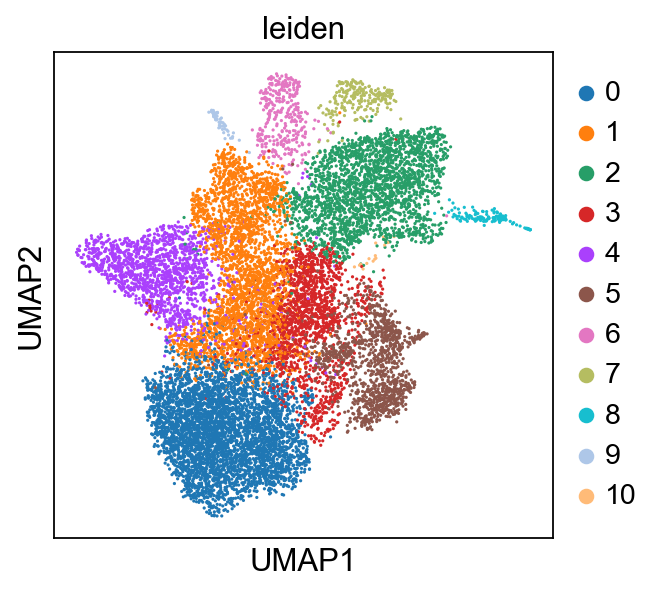

In [138]:
sc.pl.umap(adata_ref, color="leiden")

In [139]:
sc.tl.ingest(adata3, adata_ref, obs="leiden")

running ingest


/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/umap/umap_.py:1943: UserWarning: n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/tools/_ingest.py:511: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  values = [cat_array[inds].mode()[0] for inds in self._indices]


    finished (0:00:18)


<frozen _collections_abc>:949: ImplicitModificationWarning: Setting element `.obsm['rep']` of view, initializing view as actual.
<frozen _collections_abc>:949: ImplicitModificationWarning: Setting element `.obsm['X_umap']` of view, initializing view as actual.
<frozen _collections_abc>:949: ImplicitModificationWarning: Setting element `.obsm['X_pca']` of view, initializing view as actual.


In [140]:
adata3.uns["leiden_colors"] = adata_ref.uns["leiden_colors"]

In [141]:
adata_concat = adata_ref.concatenate(adata3, batch_categories=["old", "new"])

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_50885/1929136370.py:1: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  adata_concat = adata_ref.concatenate(adata3, batch_categories=["old", "new"])
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/anndata/_core/merge.py:1356: UserWarning: Only some AnnData objects have `.raw` attribute, not concatenating `.raw` attributes.
  warn(


In [142]:
adata_concat.obs.leiden = adata_concat.obs.leiden.astype("category")
# fix category ordering
adata_concat.obs.leiden = adata_concat.obs.leiden.cat.reorder_categories(adata_ref.obs.leiden.cat.categories)
# fix category colors
adata_concat.uns["leiden_colors"] = adata_ref.uns["leiden_colors"]

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector

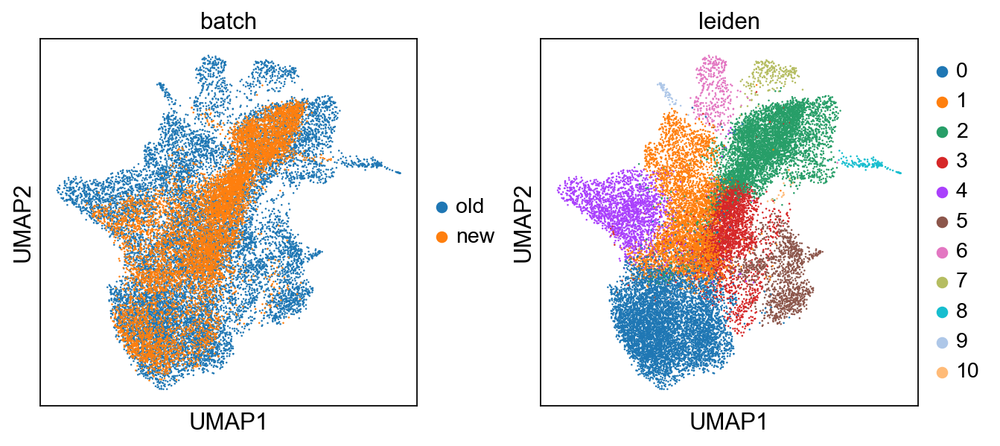

In [143]:
sc.pl.umap(adata_concat, color=["batch", "leiden"])

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector

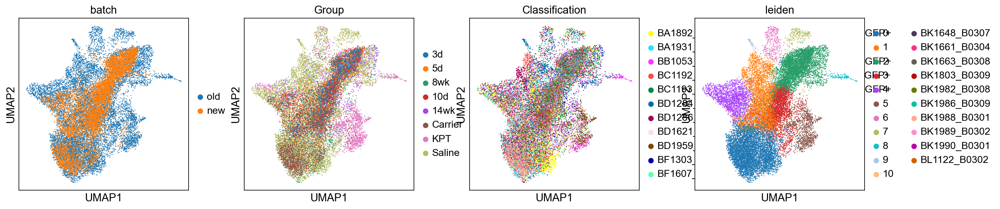

In [144]:
sc.pl.umap(adata_concat, color=['batch','Group','Classification','leiden'])

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


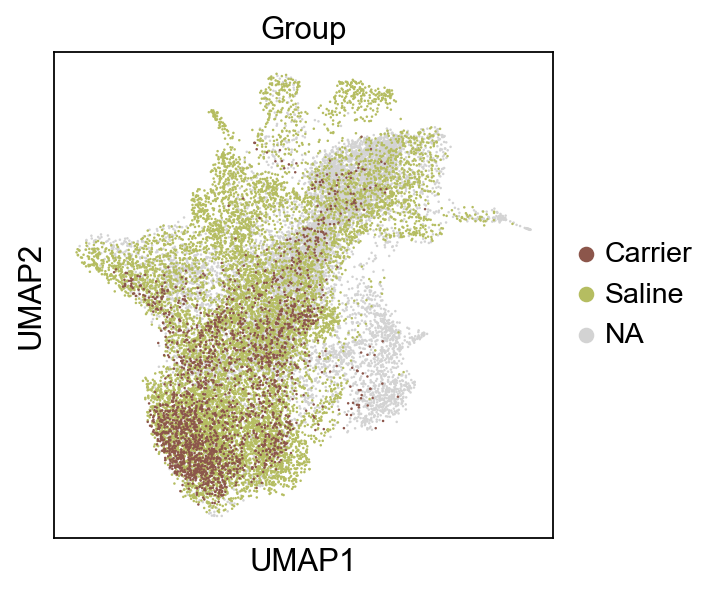

In [145]:
sc.pl.umap(adata_concat, color=['Group'], groups=['Saline', 'Carrier'])

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


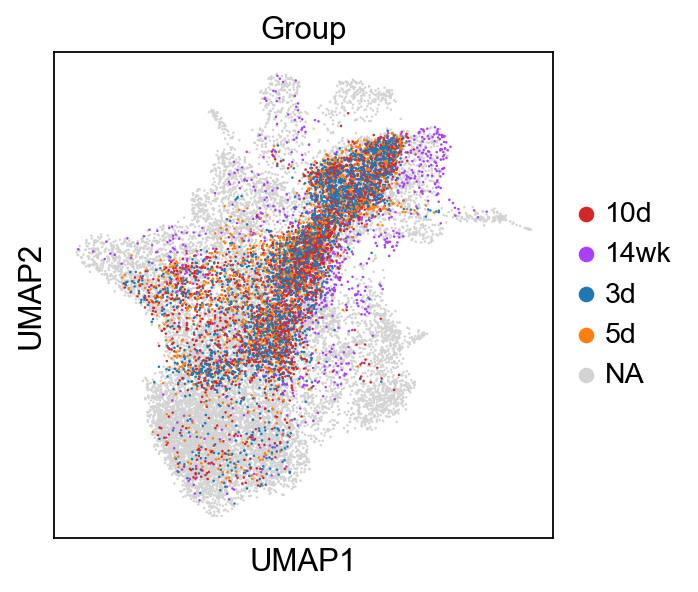

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


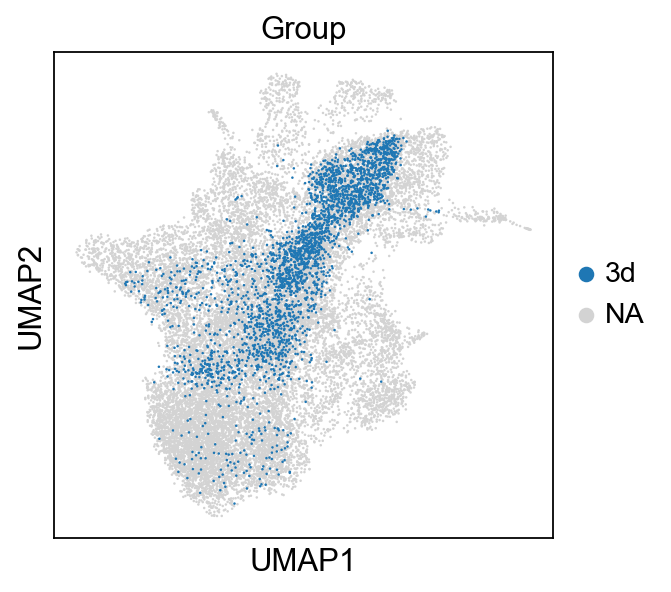

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


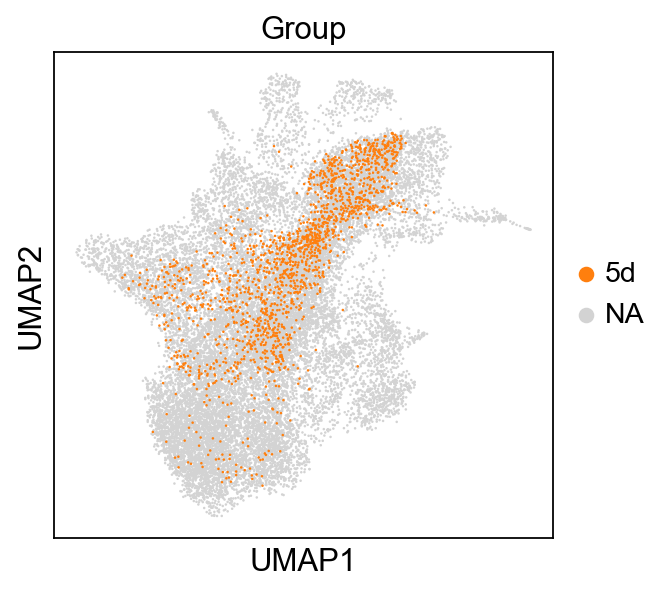

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


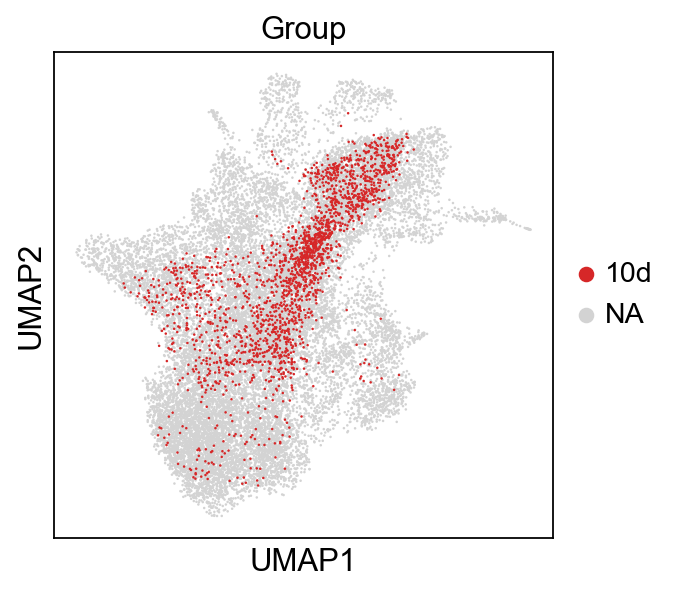

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


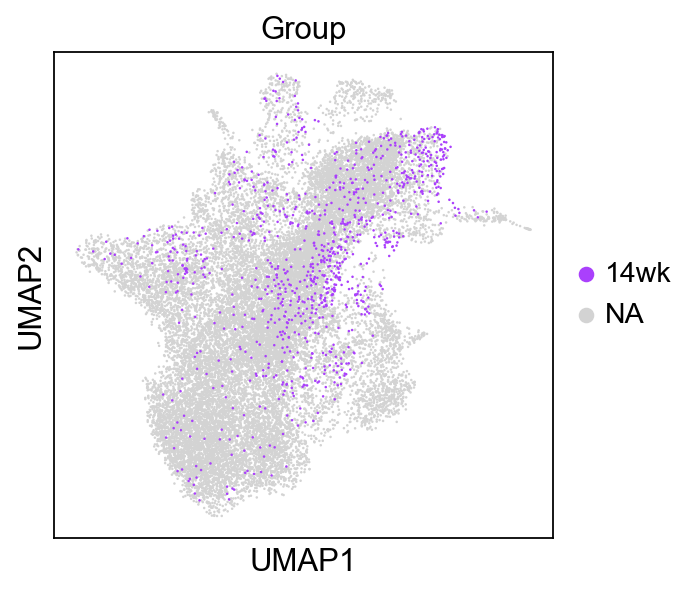

In [146]:
sc.pl.umap(adata_concat, color=['Group'], groups=['3d','5d','10d','14wk'])
sc.pl.umap(adata_concat, color=['Group'], groups=['3d'])
sc.pl.umap(adata_concat, color=['Group'], groups=['5d'])
sc.pl.umap(adata_concat, color=['Group'], groups=['10d'])
sc.pl.umap(adata_concat, color=['Group'], groups=['14wk'])

In [147]:
sc.tl.embedding_density(adata_concat,basis='umap', groupby='Group')

computing density on 'umap'
--> added
    'umap_density_Group', densities (adata.obs)
    'umap_density_Group_params', parameter (adata.uns)


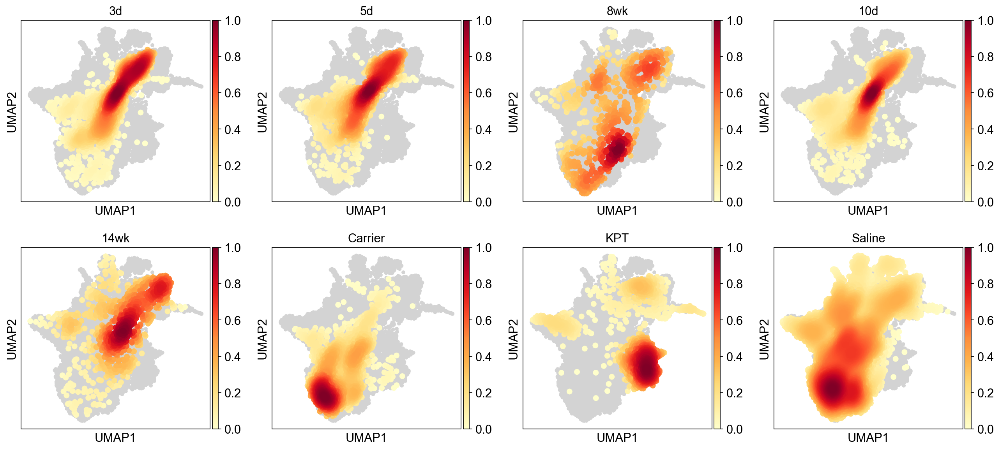

In [148]:
sc.pl.embedding_density(adata_concat,basis='umap',key='umap_density_Group')

In [149]:
adata.obs.batch.value_counts()

batch
traced    1733
Name: count, dtype: int64

## For Revision - 12wk 3d trace - no introns

In [1]:
from joblib import load, dump

In [2]:
adata_orig = load('write/combined_data.joblib').raw.to_adata()

In [3]:
#adata2 = load('../../IGO16686-mTmG-12wk-3d-tracing/write/allmice-tumor-IGO16686.joblib')

In [4]:
adata2 = anndata.read_h5ad('../../IGO16686-mTmG-12wk-3d-tracing/write/allmice-tumor-IGO16686-nointrons.h5ad')


NameError: name 'anndata' is not defined

### Try concatenation

In [313]:
adata_orig.obs[['batch','Group']].value_counts()

batch          Group  
depletion      Saline     10763
untraced_14wk  KPT         1865
traced         14wk         991
               12wk_3d      877
               8wk          742
Name: count, dtype: int64

In [314]:
adata_concat = adata_orig.concatenate(adata2, join="outer")

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_50885/3254273629.py:1: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  adata_concat = adata_orig.concatenate(adata2, join="outer")
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/anndata/_core/merge.py:1356: UserWarning: Only some AnnData objects have `.raw` attribute, not concatenating `.raw` attributes.
  warn(


In [315]:
adata_concat.obs[['batch','Group']].value_counts()

batch  Group  
0      Saline     10763
       KPT         1865
       14wk         991
1      3d           877
0      12wk_3d      877
       8wk          742
1      Carrier       99
Name: count, dtype: int64

In [316]:
sc.pp.highly_variable_genes(adata_concat, batch_key='batch')

extracting highly variable genes


/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/preprocessing/_highly_variable_genes.py:226: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  disp_grouped = df.groupby("mean_bin")["dispersions"]
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/preprocessing/_highly_variable_genes.py:226: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  disp_grouped = df.groupby("mean_bin")["dispersions"]


    finished (0:00:07)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/preprocessing/_highly_variable_genes.py:508: FutureWarning: The provided callable <function nanmean at 0x105d7cd60> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  df = df.groupby("gene").agg(
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/preprocessing/_highly_variable_genes.py:508: FutureWarning: The provided callable <function nanmean at 0x105d7cd60> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  df = df.groupby("gene").agg(
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/preprocessing/_highly_variable_genes.py:508: FutureWarning: The provided callable <function nansum at 0x105d7c860> is current

In [317]:
adata_concat.var.highly_variable = adata_concat.var.highly_variable_intersection

In [318]:
#Ensure marker genes aren't making an impact to highly variable gene analysis downstream
adata_concat.var.highly_variable['EGFP'] = False
adata_concat.var.highly_variable['mScarlet'] = False
adata_concat.var.highly_variable['Cre'] = False
adata_concat.var.highly_variable['ERT'] = False
adata_concat.var.highly_variable['iDTR'] = False
adata_concat.var.highly_variable['tagBFP'] = False
adata_concat.var.highly_variable['mKate2'] = False
adata_concat.var.highly_variable['Akaluc'] = False
adata_concat.var.highly_variable['tdTomato'] = False
adata_concat.var.highly_variable['CLuc'] = False
adata_concat.var.highly_variable['GLuc'] = False

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_50885/2794567156.py:2: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata_concat.var.highly_variable['EGFP'] = False
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_50885

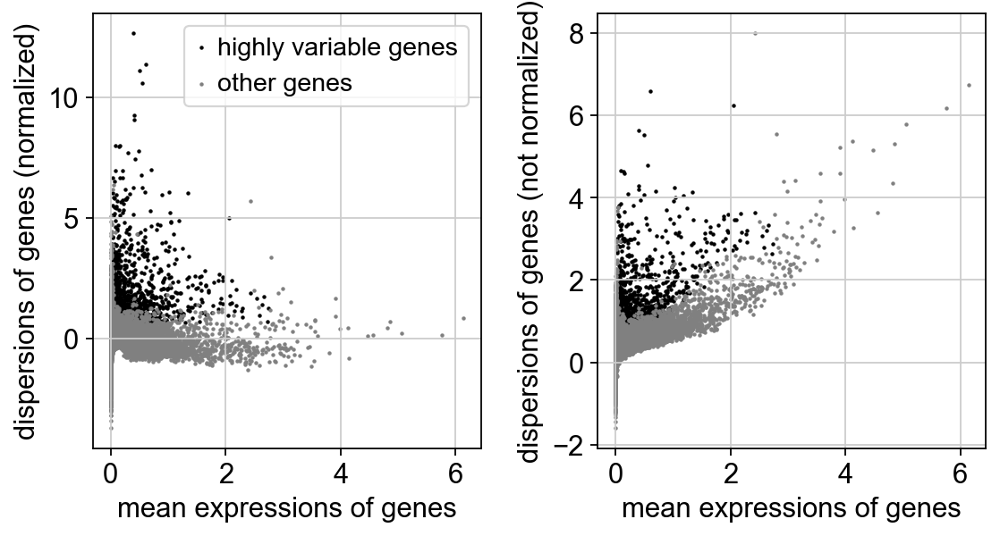

In [319]:
sc.pl.highly_variable_genes(adata_concat)

In [320]:
adata_concat.raw = adata_concat

In [321]:
sc.pp.scale(adata_concat, max_value=10)

... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


In [322]:
sc.tl.pca(adata_concat, svd_solver='arpack', n_comps=150)

computing PCA
    on highly variable genes
    with n_comps=150
    finished (0:00:03)


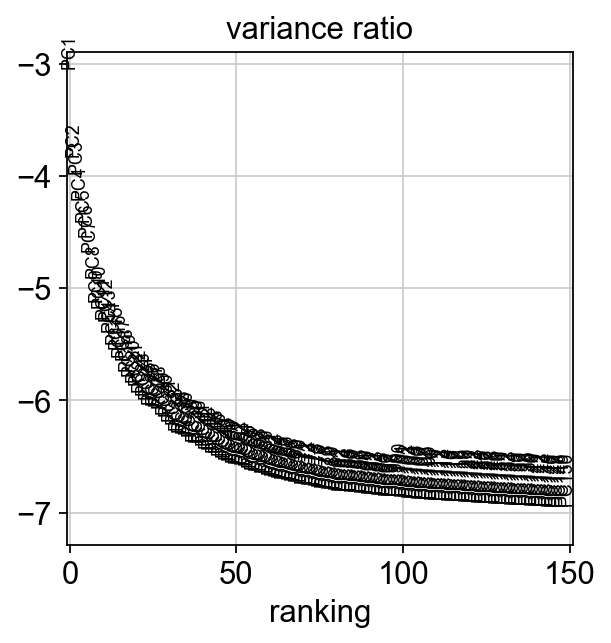

In [323]:
sc.pl.pca_variance_ratio(adata_concat, log=True, n_pcs=150)

In [324]:
sc.pp.neighbors(adata_concat, n_neighbors=15, n_pcs=50)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)


In [325]:
sc.tl.umap(adata_concat)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:09)


/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector

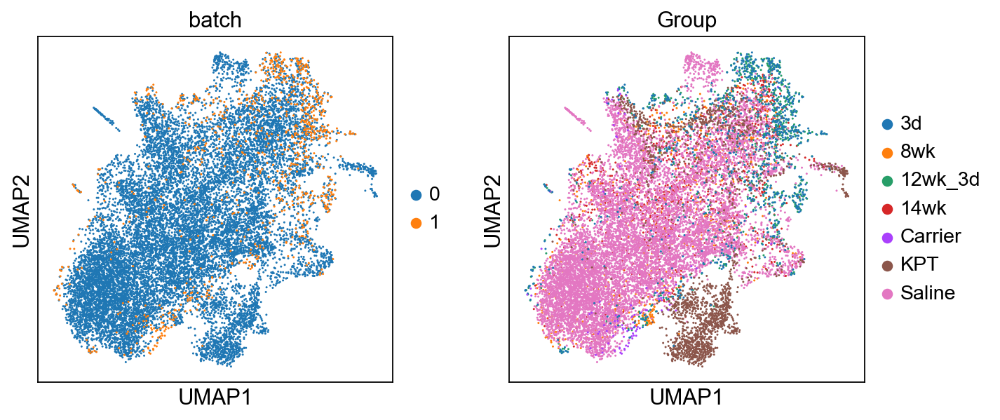

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector

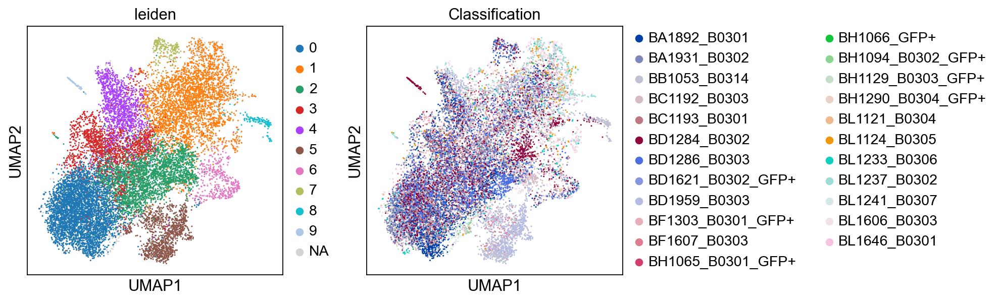

In [326]:
sc.pl.umap(adata_concat, color=['batch','Group'])
sc.pl.umap(adata_concat, color=['leiden','Classification',])

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


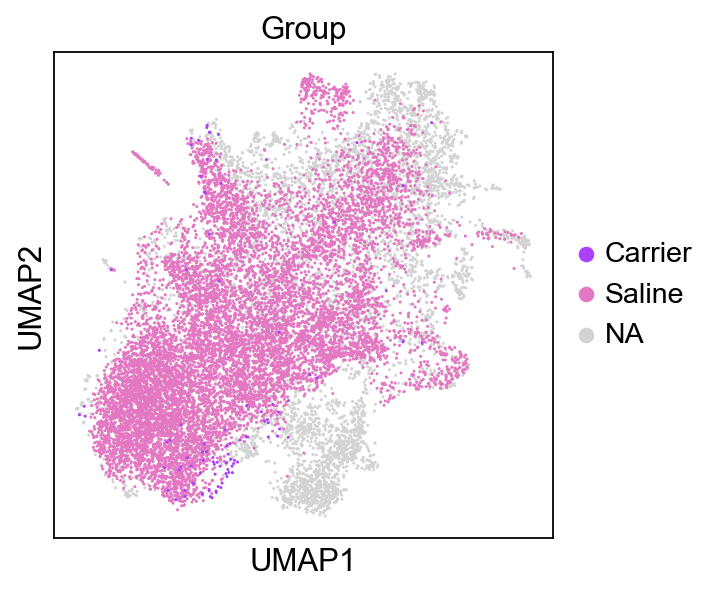

In [327]:
sc.pl.umap(adata_concat, color=['Group'], groups=['Saline', 'Carrier'])

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


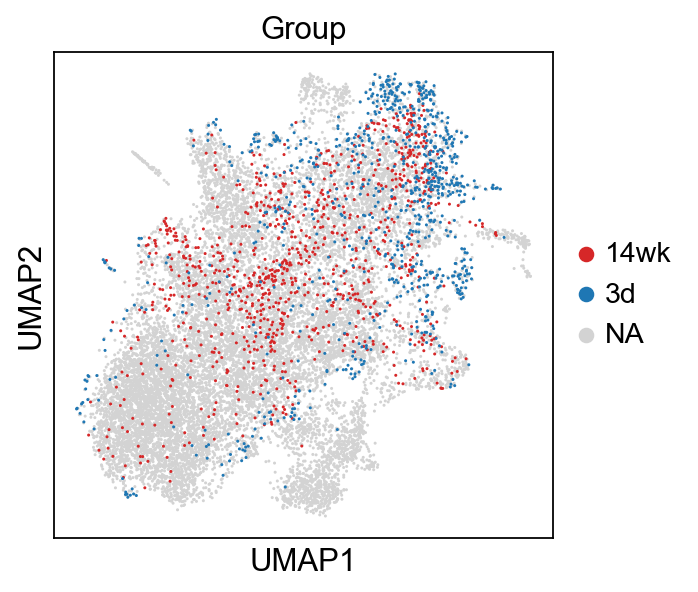

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


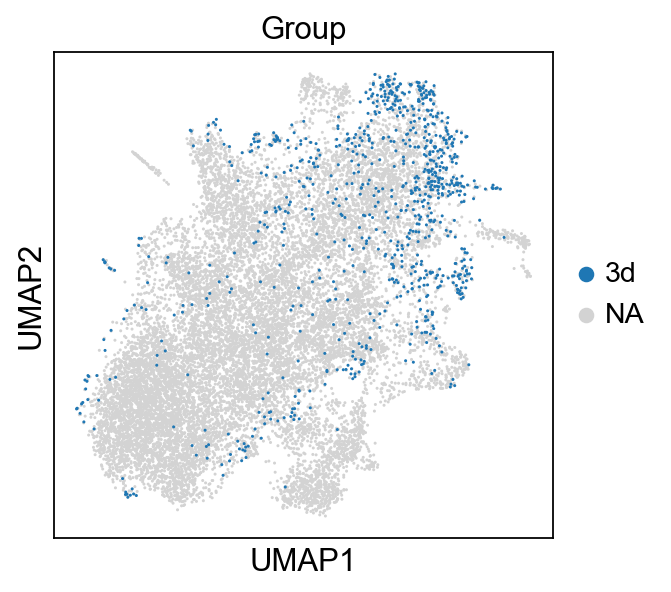

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


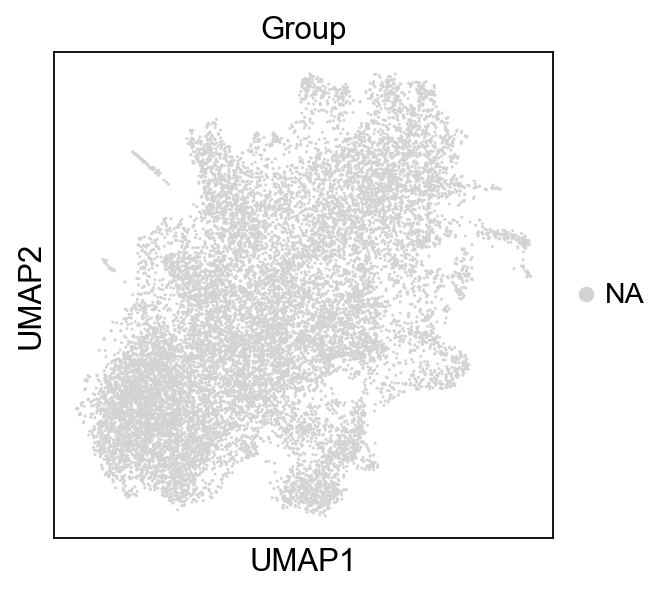

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


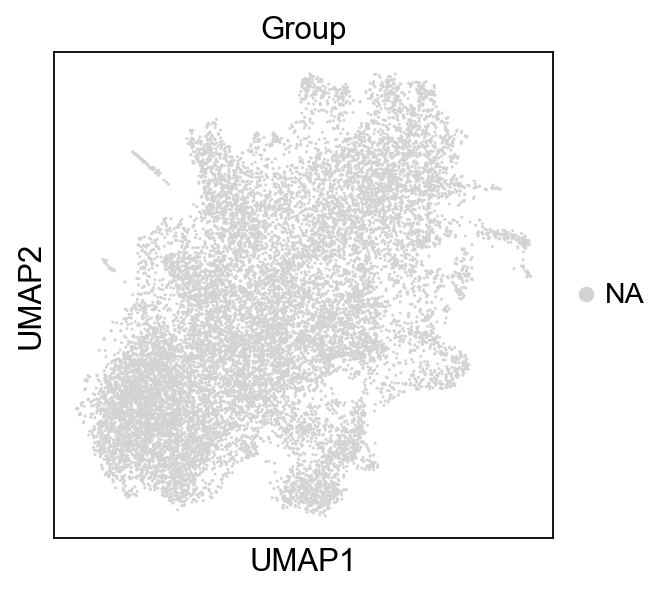

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


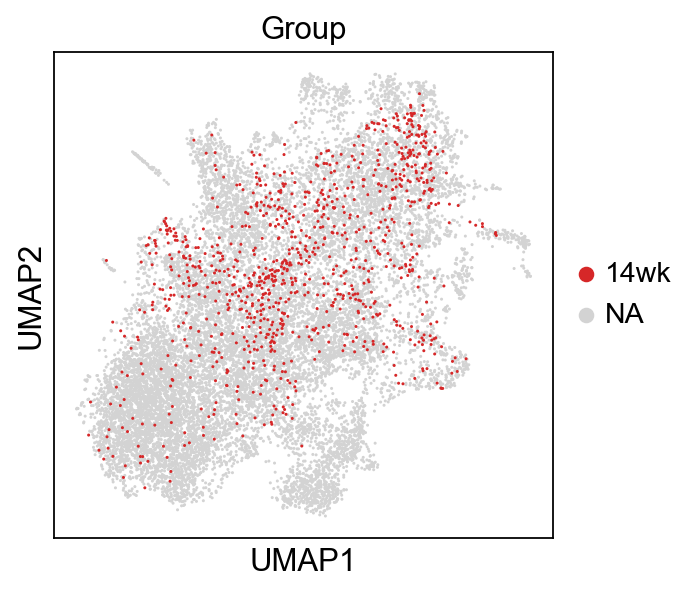

In [328]:
sc.pl.umap(adata_concat, color=['Group'], groups=['3d','5d','10d','14wk'])
sc.pl.umap(adata_concat, color=['Group'], groups=['3d'])
sc.pl.umap(adata_concat, color=['Group'], groups=['5d'])
sc.pl.umap(adata_concat, color=['Group'], groups=['10d'])
sc.pl.umap(adata_concat, color=['Group'], groups=['14wk'])

In [329]:
sc.tl.embedding_density(adata_concat,basis='umap', groupby='Group')

computing density on 'umap'
--> added
    'umap_density_Group', densities (adata.obs)
    'umap_density_Group_params', parameter (adata.uns)


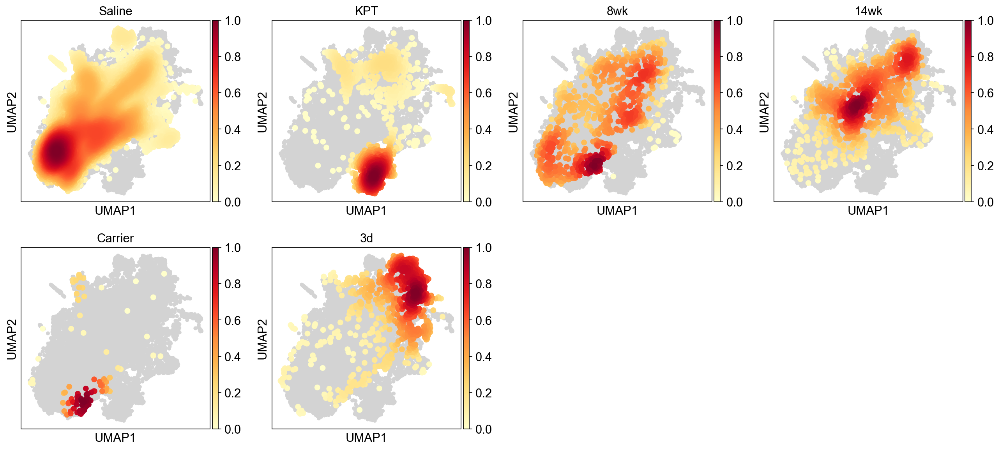

In [330]:
sc.pl.embedding_density(adata_concat,basis='umap',key='umap_density_Group', group=['Saline','KPT','8wk','14wk','Carrier','3d'])

### Logistic Regression

In [331]:
from sklearn.linear_model import LogisticRegression
from joblib import dump, load
names = load('../common_files/genes.joblib')

In [332]:
adata_log = adata_concat[:,adata_concat.var.index.isin(names)]

In [333]:
adata_names = [x for x in adata_log.var.index]

In [334]:
goi = [x for x in adata_log.var.index]

### Load SmartSeq h5ad file

In [335]:
smartseq = anndata.read('../Marjanovic_et_al_2020/write/Marjanovic_et_al_LUAD_data.h5ad')

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/anndata/__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


### Logistic Regression against Cancer Cell 2020 Clusters intersected with 10x data

In [336]:
from sklearn.model_selection import train_test_split

names_adata = smartseq[:,smartseq.var.index.isin(goi)]

X_train, X_test, y_train, y_test = train_test_split(names_adata.X, smartseq.obs['clusterK12'], test_size=0.25, random_state=250)

In [337]:
names = [x for x in names_adata.var.index]

In [338]:
# import the class
from sklearn.linear_model import LogisticRegression

# instantiate the model (using the default parameters)
logreg = LogisticRegression(random_state=250,multi_class='multinomial', solver='lbfgs')

# fit the model with data
logreg.fit(X_train, y_train)

y_pred = logreg.predict(X_test)
y_score = logreg.predict_proba(X_test)


In [339]:
# import the metrics class
from sklearn import metrics

cnf_matrix = metrics.confusion_matrix(y_test, y_pred)
cnf_matrix

array([[144,   5,   2,   0,   0,   0,   1,   0,   0,   0,   0,   0],
       [  7,  70,   0,   3,   0,   0,   0,   0,   0,   0,   0,   0],
       [  0,   0,  42,   0,   2,   0,   0,   2,   0,   1,   0,   0],
       [  0,   1,   0,  66,   0,   0,   0,   9,   1,   0,   0,   0],
       [  0,   0,   3,   0, 181,   2,   0,   2,   0,   0,   0,   1],
       [  0,   0,   0,   0,   0,  34,   0,   0,   0,   0,   0,   0],
       [  0,   0,   0,   0,   0,   0,  14,   1,   0,   0,   0,   0],
       [  0,   0,   1,   2,   1,   0,   0, 138,   1,   0,   0,   1],
       [  0,   0,   0,   1,   1,   0,   0,   1,  38,   1,   0,   0],
       [  0,   0,   1,   1,   0,   0,   0,   3,   0,  57,   0,   1],
       [  0,   0,   0,   0,   0,   0,   0,   0,   1,   0,  13,   0],
       [  0,   0,   0,   0,   1,   0,   0,   0,   1,   1,   0,  40]])

Text(0.5, 295.64444444444445, 'Predicted label')

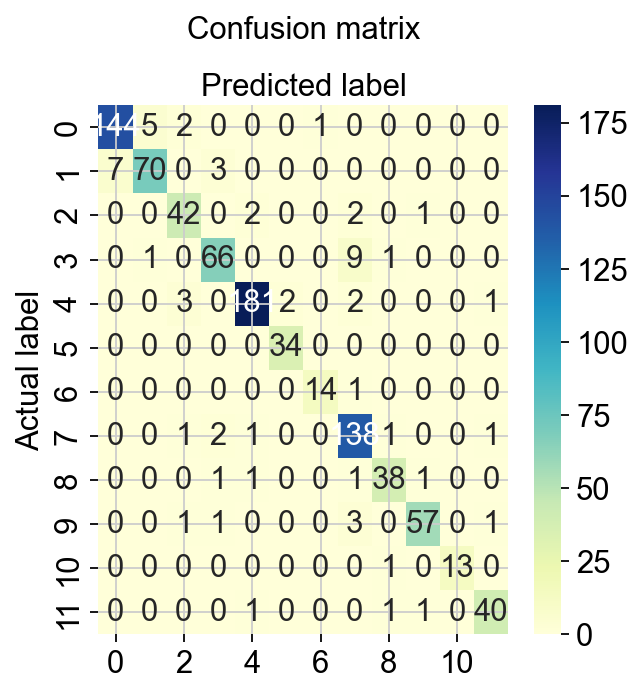

In [340]:
# import required modules
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

class_names=[0,1] # name  of classes
fig, ax = plt.subplots()
tick_marks = np.arange(len(class_names))
plt.xticks(tick_marks, class_names)
plt.yticks(tick_marks, class_names)
# create heatmap
sns.heatmap(pd.DataFrame(cnf_matrix), annot=True, cmap="YlGnBu" ,fmt='g')
ax.xaxis.set_label_position("top")
plt.tight_layout()
plt.title('Confusion matrix', y=1.1)
plt.ylabel('Actual label')
plt.xlabel('Predicted label')

#Text(0.5,257.44,'Predicted label');

In [341]:
from sklearn.metrics import classification_report
target_names = ['1', '2', '3','4','5','6','7','8','9','10','11','12']
print(classification_report(y_test, y_pred, target_names=target_names))

              precision    recall  f1-score   support

           1       0.95      0.95      0.95       152
           2       0.92      0.88      0.90        80
           3       0.86      0.89      0.88        47
           4       0.90      0.86      0.88        77
           5       0.97      0.96      0.97       189
           6       0.94      1.00      0.97        34
           7       0.93      0.93      0.93        15
           8       0.88      0.96      0.92       144
           9       0.90      0.90      0.90        42
          10       0.95      0.90      0.93        63
          11       1.00      0.93      0.96        14
          12       0.93      0.93      0.93        43

    accuracy                           0.93       900
   macro avg       0.93      0.92      0.93       900
weighted avg       0.93      0.93      0.93       900



In [342]:
from sklearn.preprocessing import LabelBinarizer

label_binarizer = LabelBinarizer().fit(y_train)
y_onehot_test = label_binarizer.transform(y_test)
y_onehot_test.shape  # (n_samples, n_classes)

(900, 12)

In [343]:
class_of_interest = '09'
class_id = np.flatnonzero(label_binarizer.classes_ == class_of_interest)[0]
class_id

8

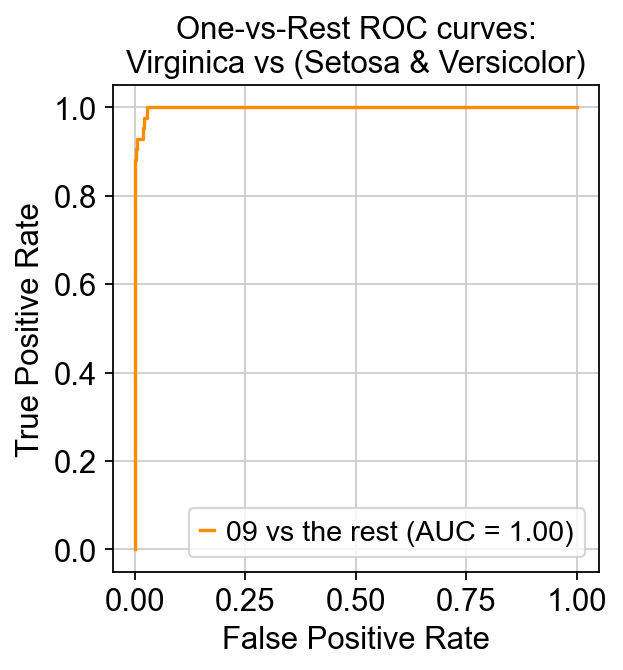

In [344]:
import matplotlib.pyplot as plt

from sklearn.metrics import RocCurveDisplay

RocCurveDisplay.from_predictions(
    y_onehot_test[:, class_id],
    y_score[:, class_id],
    name=f"{class_of_interest} vs the rest",
    color="darkorange",
    #plot_chance_level=True,
)
plt.axis("square")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("One-vs-Rest ROC curves:\nVirginica vs (Setosa & Versicolor)")
plt.legend()
plt.show()

In [345]:
y_pred = logreg.predict(smartseq[:,names].X)
y_proba = logreg.predict_proba(smartseq[:,names].X)

In [346]:
smartseq.obs['clusterK12_intersecting'] = [x for x in y_pred]
smartseq.obs['clusterK12_intersecting'] = smartseq.obs['clusterK12_intersecting'].astype('category')

In [347]:
results_binary = logreg.predict(X_test)
probs_binary = logreg.predict_proba(X_test)

results_df_binary = pd.DataFrame()
results_df_binary['predicted'] = list(results_binary)
#results_df_binary['actual'] = list(smartseq.obs['clusterK12'])
results_df_binary['actual'] = list(y_test)
for x in range(0,12):
    results_df_binary["probability_%d" % (x+1)] = [i[x] for i in list(probs_binary)]
results_df_binary['highest_prob'] =results_df_binary[["probability_%d" % (x+1) for x in range(0,12)]].max(axis=1)
results_df_binary['correct'] = (results_df_binary['predicted'] == results_df_binary['actual']).astype(int)
results_df_binary

,predicted,actual,probability_1,probability_2,probability_3,probability_4,probability_5,probability_6,probability_7,probability_8,probability_9,probability_10,probability_11,probability_12,highest_prob,correct
0,08,03,2.795251e-09,3.487006e-05,4.314893e-02,7.587486e-03,1.014023e-07,7.344014e-06,1.130252e-04,9.488974e-01,2.895437e-07,5.978838e-06,6.275333e-06,1.983399e-04,0.948897,0
1,01,01,9.999953e-01,7.195150e-08,1.047942e-09,1.302894e-08,4.356426e-08,4.152493e-07,4.082258e-06,9.683644e-12,4.801952e-11,5.079132e-10,2.569228e-08,3.835873e-10,0.999995,1
2,08,08,1.296677e-10,2.060552e-08,9.022134e-08,1.199638e-07,3.332232e-07,1.534957e-07,4.464116e-06,9.999720e-01,1.668432e-06,1.979356e-05,1.287637e-06,7.897673e-08,0.999972,1
3,10,10,8.899799e-09,2.554909e-06,8.439460e-06,1.448644e-07,3.899762e-01,8.858495e-04,5.086402e-05,1.012511e-04,1.126877e-04,6.083421e-01,5.500809e-05,4.648451e-04,0.608342,1
4,08,08,1.257642e-08,5.192675e-08,7.698490e-09,1.062249e-06,9.372517e-07,4.130366e-07,2.420641e-05,9.994282e-01,5.388583e-04,3.009691e-06,8.712223e-07,2.344632e-06,0.999428,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
895,05,05,2.866424e-04,1.898631e-07,6.714574e-06,9.914980e-05,9.602582e-01,2.390084e-02,5.524966e-04,5.830303e-03,1.338740e-03,7.455606e-03,2.435717e-04,2.750058e-05,0.960258,1
896,05,05,1.828701e-10,2.732572e-07,8.778729e-08,1.063361e-07,9.999901e-01,2.046382e-06,3.633047e-07,7.981898e-11,3.108057e-08,2.405194e-07,5.883325e-06,8.800506e-07,0.999990,1
897,08,08,6.313066e-06,3.483596e-05,9.432770e-06,2.357946e-03,2.765062e-08,3.606220e-06,7.279305e-05,9.884081e-01,8.899898e-03,1.827153e-04,1.757241e-05,6.721010e-06,0.988408,1
898,05,05,1.896865e-10,6.497475e-08,5.392073e-06,1.394162e-10,9.999930e-01,4.444819e-08,3.215762e-07,2.419797e-07,1.584102e-08,8.164715e-08,6.163086e-07,1.731879e-07,0.999993,1


In [348]:
results_df_binary['bin'] = pd.qcut(results_df_binary['highest_prob'], q=7)
idx = pd.IntervalIndex(results_df_binary['bin'])
results_df_binary['low'] = idx.left
results_df_binary['high'] = idx.right
results_df_binary['prob range'] = results_df_binary['low'].round(2).astype(str) + "-" + results_df_binary['high'].round(2).astype(str)
df_bins_grouped = results_df_binary[['low','high','correct','prob range']].groupby('prob range').mean().reset_index()
df_bins_grouped

,prob range,low,high,correct
0,0.33-0.89,0.326703,0.890747,0.682171
1,0.89-0.99,0.890747,0.986976,0.898438
2,0.99-1.0,0.986976,0.997906,0.945736
3,1.0-1.0,0.999413,0.999935,0.996109


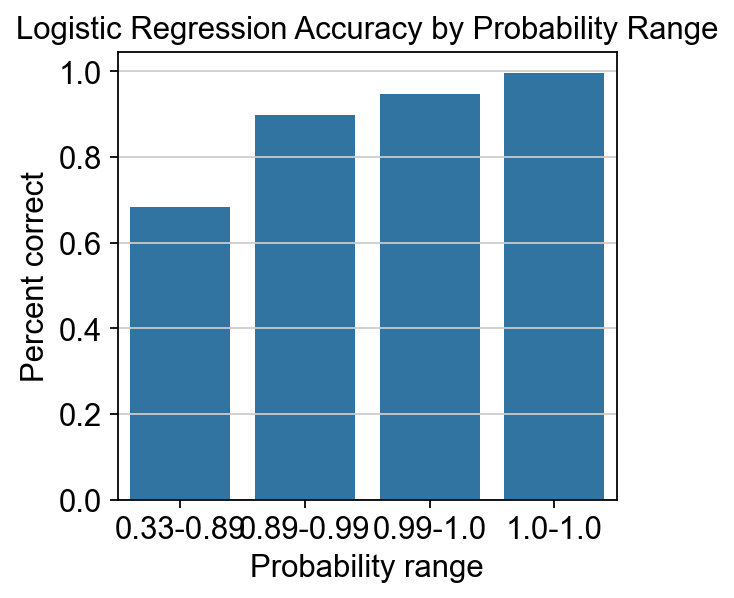

In [349]:
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
plt.figure(figsize=(4,4))
plt.subplots_adjust(top=0.85)

ax = sns.barplot(x='prob range', y='correct', data=df_bins_grouped)
plt.title("Logistic Regression Accuracy by Probability Range")
plt.ylabel('Percent correct')
plt.xlabel('Probability range')
plt.show()

In [350]:
#reset size
from matplotlib import rcParams
FIGSIZE=(4,4)
rcParams['figure.figsize']=FIGSIZE

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector

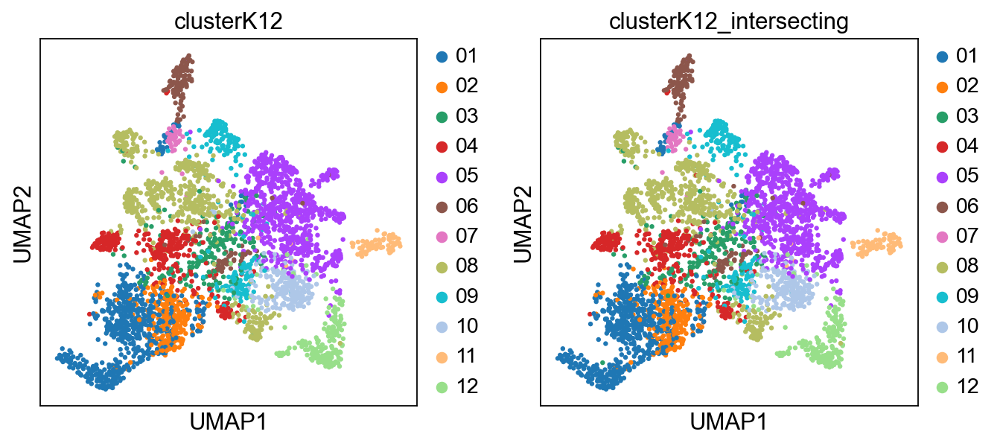

In [351]:
sc.pl.umap(smartseq, color=['clusterK12','clusterK12_intersecting'])

In [352]:
dict = {1: "01", 2: "02", 3: "03", 4: "04", 5: "05", 6: "06", 7: "07", 8: "08", 9: "09", 10: "10", 11: "11", 12: "12"}

In [353]:
from sklearn.metrics import accuracy_score
accuracy_score(smartseq.obs.replace({"clusterK12": dict})['clusterK12'], smartseq.obs['clusterK12_intersecting'])

0.9825

In [354]:
results_binary = logreg.predict(smartseq[:,names].X)
probs_binary = logreg.predict_proba(smartseq[:,names].X)

results_df_binary = pd.DataFrame()
results_df_binary['predicted'] = list(results_binary)

for x in range(0,12):
    results_df_binary[x+1] = [i[x] for i in list(probs_binary)]
results_df_binary['highest_prob'] =results_df_binary[[x+1 for x in range(0,12)]].max(axis=1)
results_df_binary

,predicted,1,2,3,4,5,6,7,8,9,10,11,12,highest_prob
0,11,8.639035e-14,2.695136e-11,3.362766e-11,3.123709e-14,1.160829e-08,8.405072e-12,2.249036e-09,7.089927e-12,2.064413e-12,8.299841e-11,1.000000e+00,3.054161e-10,1.000000
1,12,5.120562e-12,5.160031e-12,3.981152e-12,1.724457e-10,2.652191e-11,1.727185e-07,1.445050e-09,3.143479e-09,3.410908e-08,5.956335e-08,6.189276e-10,9.999997e-01,1.000000
2,05,1.269995e-03,1.951812e-07,5.776303e-04,5.351342e-08,9.981455e-01,2.499306e-06,8.501580e-07,1.246115e-10,8.872896e-08,5.688704e-07,7.301583e-07,1.892025e-06,0.998145
3,10,1.422523e-07,4.238521e-07,3.054211e-07,2.049052e-03,1.046230e-07,5.934999e-06,3.246726e-06,3.278798e-03,1.121930e-06,9.946483e-01,1.315323e-06,1.126766e-05,0.994648
4,01,9.999958e-01,2.229958e-09,1.053207e-06,2.913222e-06,3.235270e-09,2.726586e-08,2.867945e-08,2.443159e-11,9.244076e-13,2.188019e-09,1.478393e-07,2.678693e-09,0.999996
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3595,08,7.556884e-11,1.099870e-07,8.037859e-09,4.769679e-08,2.089339e-09,4.645509e-09,3.017343e-07,9.999894e-01,1.000726e-05,1.113825e-07,2.579624e-08,2.549609e-09,0.999989
3596,09,4.522604e-08,7.955264e-07,1.089831e-07,1.023016e-07,6.721841e-07,6.709353e-08,1.611508e-06,7.141072e-04,9.992804e-01,3.901756e-07,1.487472e-06,2.282353e-07,0.999280
3597,08,8.887289e-09,4.318363e-07,2.174546e-08,7.533873e-06,1.198712e-09,2.349081e-08,2.129338e-06,9.998193e-01,1.690781e-04,9.560469e-07,3.896293e-07,1.034634e-07,0.999819
3598,08,8.773985e-09,4.402702e-06,3.235211e-06,2.285541e-06,6.224946e-04,8.969573e-07,1.520757e-05,9.992629e-01,4.807032e-05,3.291855e-05,4.680994e-06,2.886574e-06,0.999263


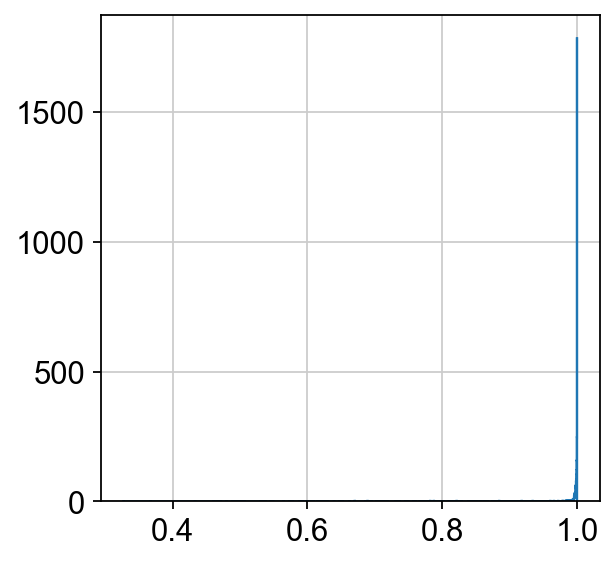

In [355]:
_ = plt.hist(results_df_binary['highest_prob'], bins='auto', histtype='step')

### End LogisticRegression

In [356]:
adata_ordered_genes = [adata_names.index(x) for x in names]

In [357]:
adata_log_ordered = adata_log[:,adata_ordered_genes]

In [358]:
y_pred = logreg.predict(adata_log_ordered.X)

In [359]:
adata_log_ordered.obs['clusterK12'] = [x for x in y_pred]
adata_log_ordered.obs['clusterK12'] = adata_log_ordered.obs['clusterK12'].astype('category')

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_50885/3908199522.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_log_ordered.obs['clusterK12'] = [x for x in y_pred]


In [360]:
#reset size
from matplotlib import rcParams
FIGSIZE=(4,4)
rcParams['figure.figsize']=FIGSIZE

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector

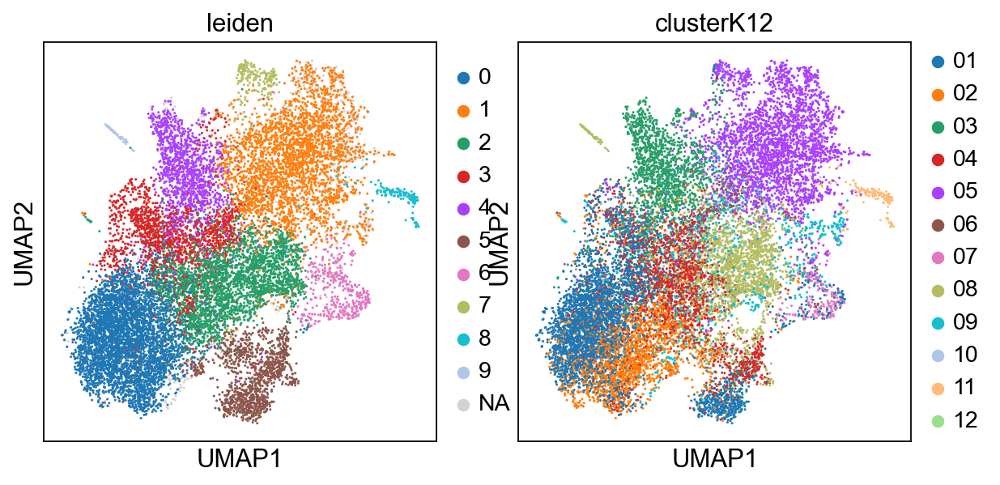

In [361]:
sc.pl.umap(adata_log_ordered,color=['leiden','clusterK12'], wspace=0.1)

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


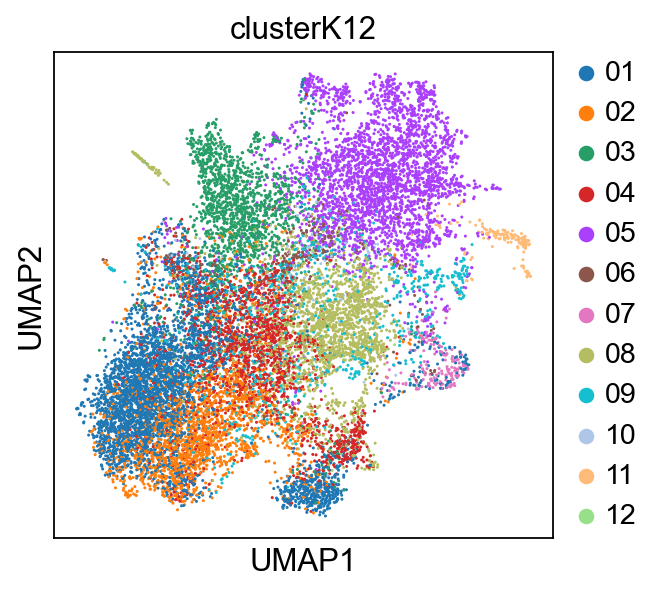

In [362]:
sc.pl.umap(adata_log_ordered,color=['clusterK12'])

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


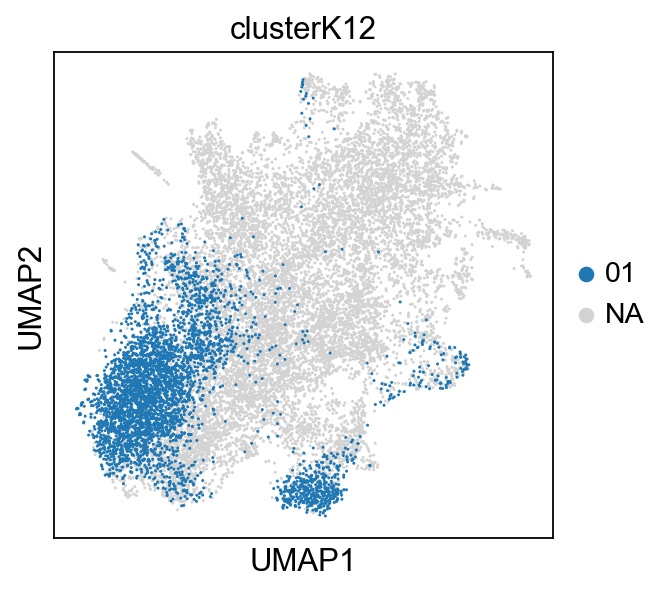

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


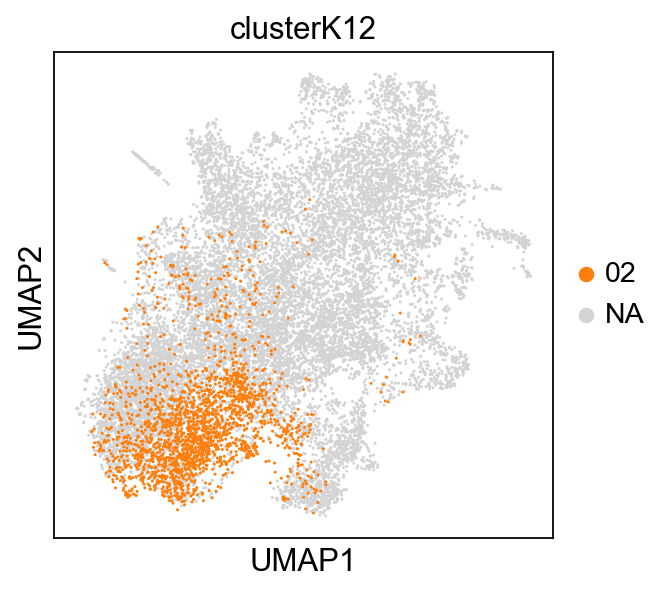

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


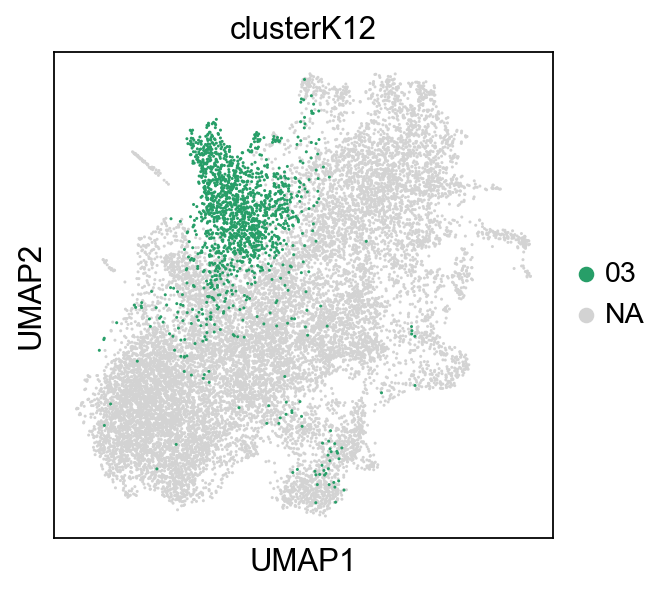

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


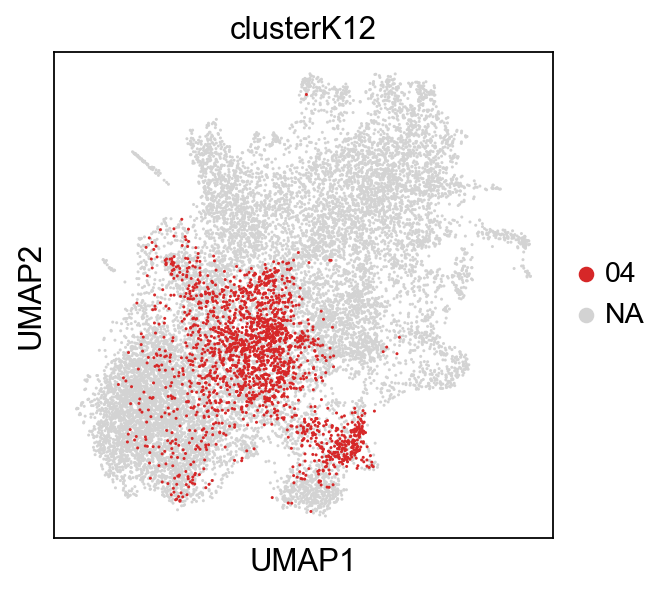

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


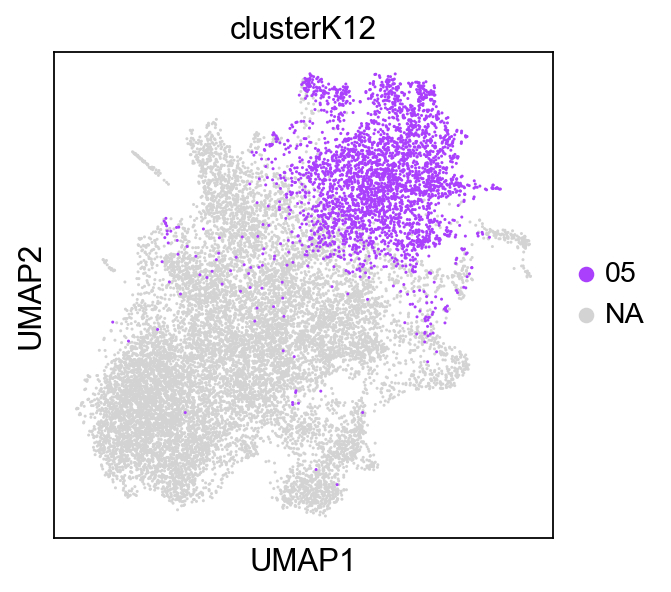

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


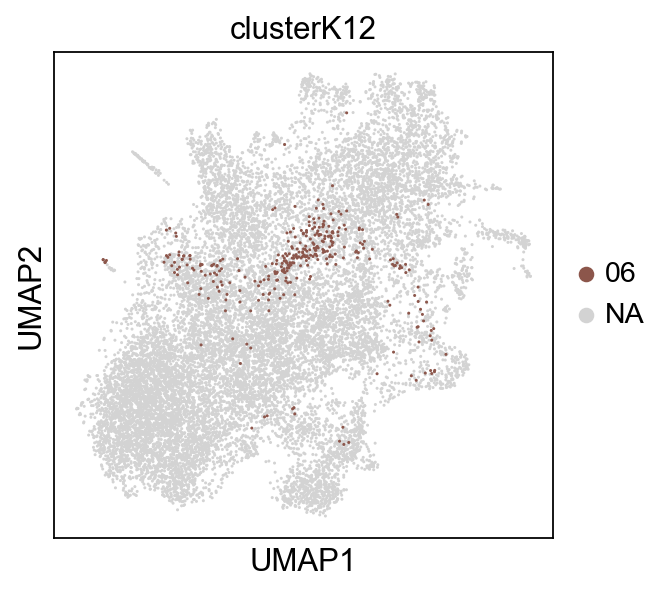

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


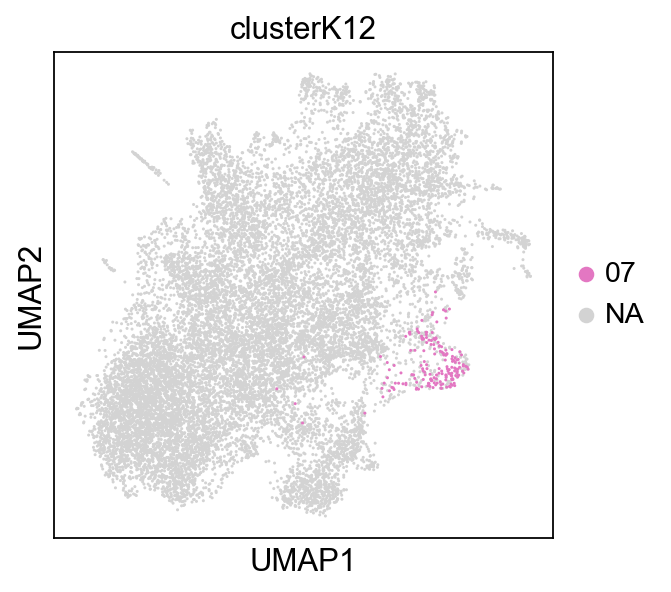

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


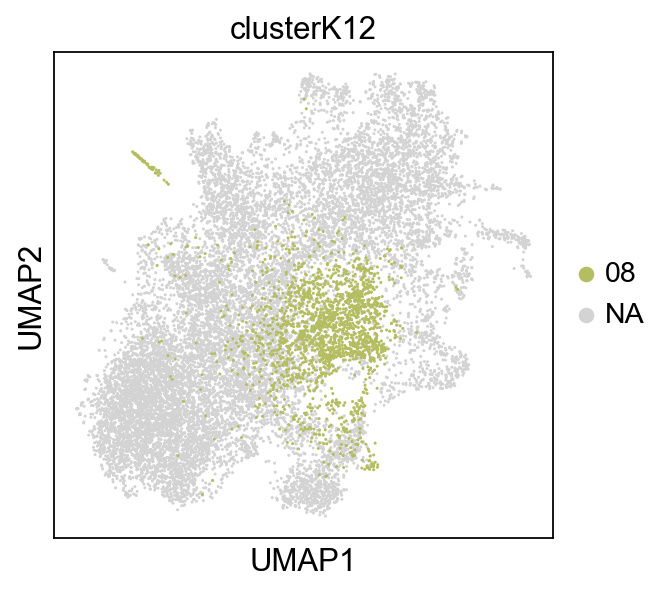

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


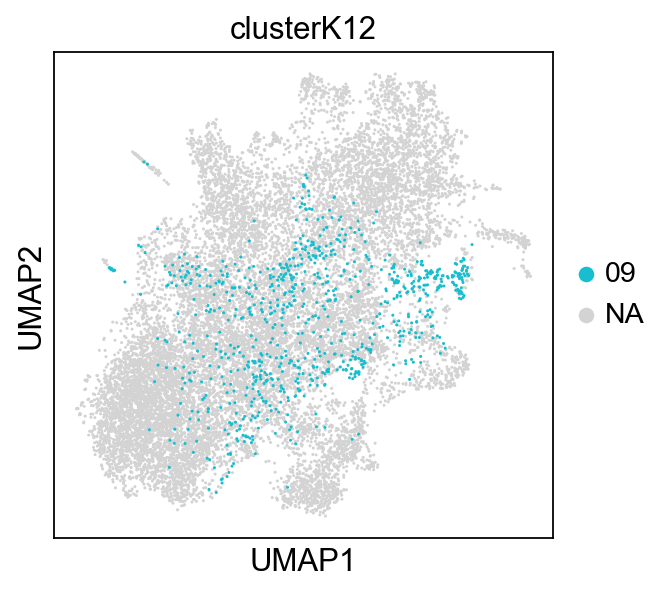

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


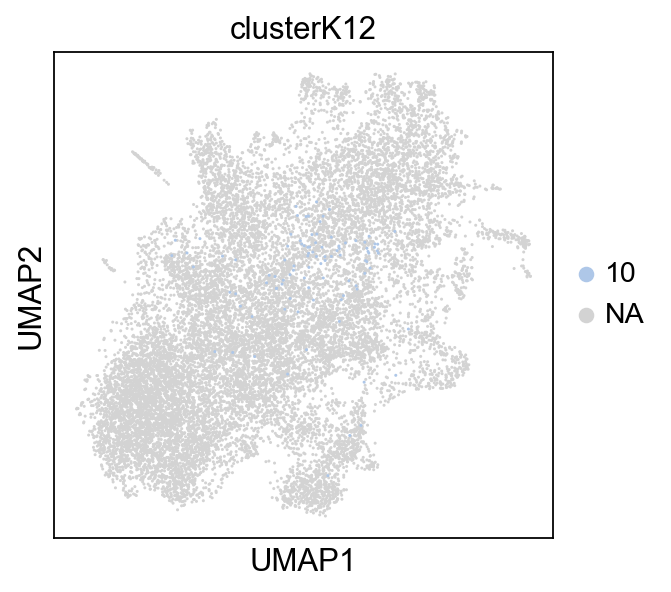

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


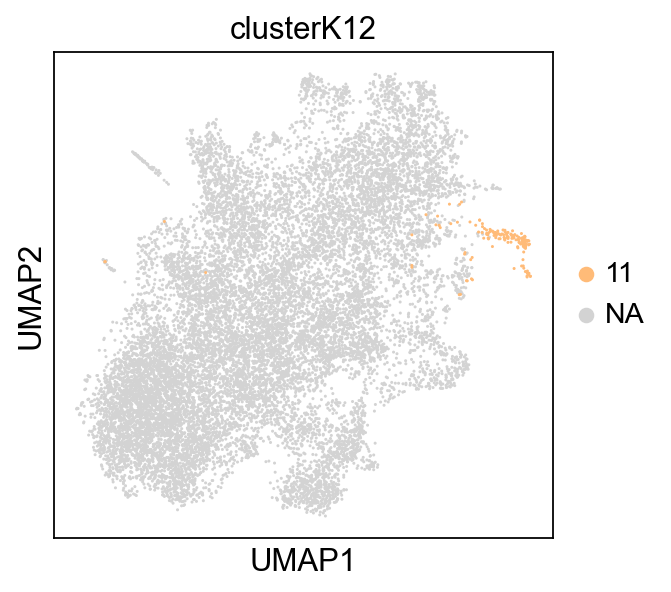

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


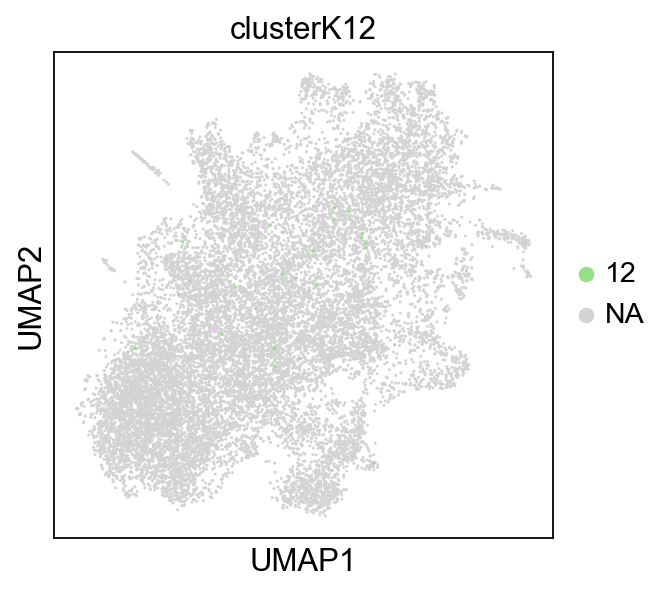

In [363]:
for x in adata_log_ordered.obs.clusterK12.cat.categories:
    sc.pl.umap(adata_log_ordered,color=['clusterK12'], groups=[x])

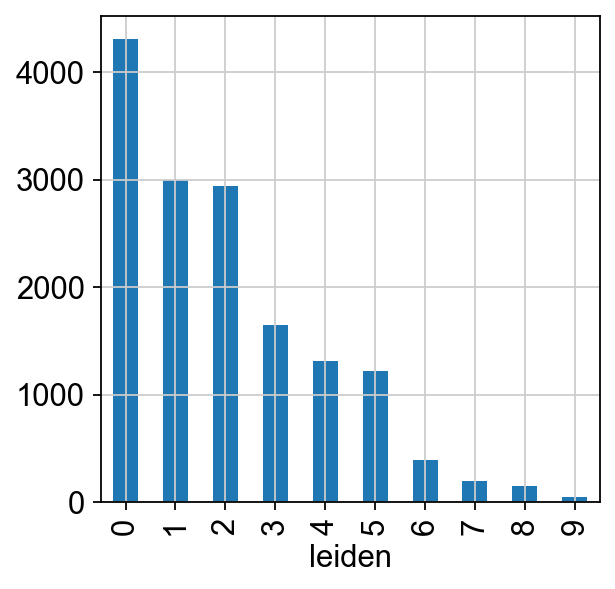

In [364]:
 cell_proportion_df = adata_log_ordered.obs.leiden.value_counts().T.plot(kind='bar', stacked=True, legend=False)

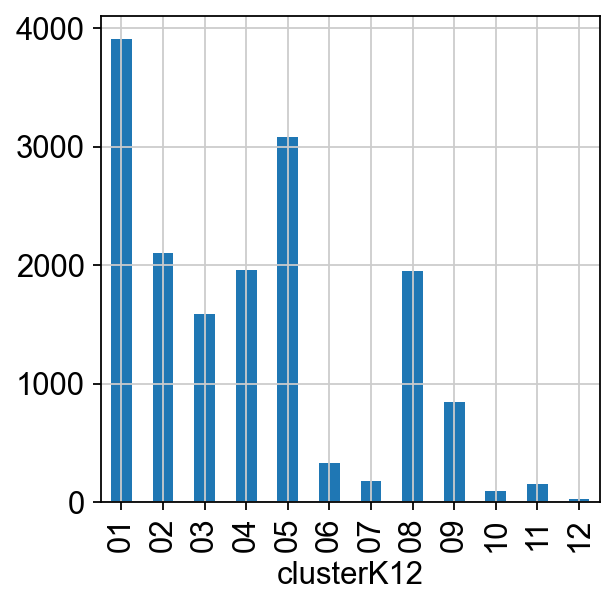

In [365]:
 cell_proportion_df = adata_log_ordered.obs.clusterK12.value_counts(sort=False).T.plot(kind='bar', stacked=True, legend=False)

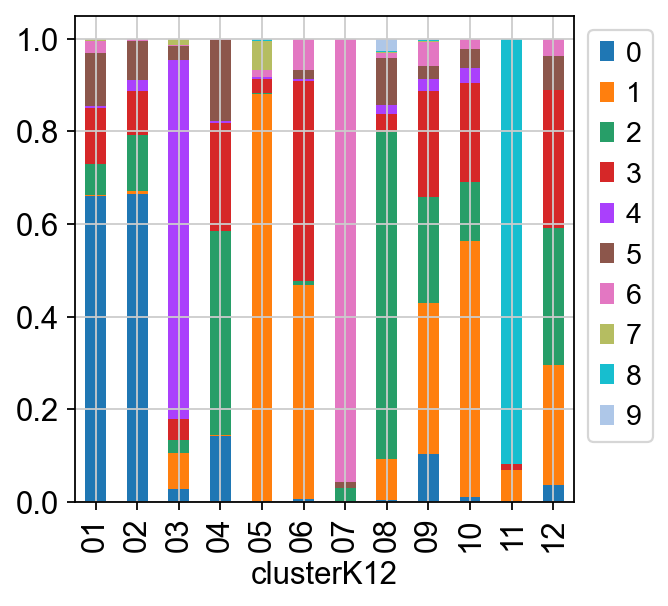

In [366]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['leiden'],adata_log_ordered.obs['clusterK12'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

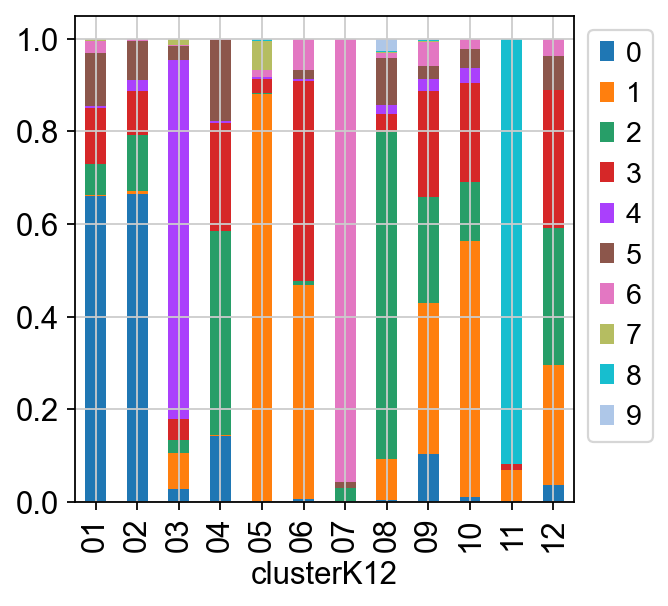

In [367]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['leiden'],adata_log_ordered.obs['clusterK12'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

In [368]:
results_binary = logreg.predict(adata_log_ordered.X)
probs_binary = logreg.predict_proba(adata_log_ordered.X)

results_df_binary = pd.DataFrame()
results_df_binary['predicted'] = list(results_binary)
#results_df_binary['actual'] = list(smartseq.obs['clusterK12'])
for x in range(0,12):
    results_df_binary[x+1] = [i[x] for i in list(probs_binary)]
results_df_binary['highest_prob'] =results_df_binary[[x+1 for x in range(0,12)]].max(axis=1)
results_df_binary

,predicted,1,2,3,4,5,6,7,8,9,10,11,12,highest_prob
0,03,6.914580e-06,1.192858e-02,8.783811e-01,7.420437e-04,0.003710,7.682226e-02,4.187899e-04,4.026147e-04,1.630799e-03,2.187695e-02,2.531148e-03,1.548968e-03,0.878381
1,04,4.648220e-01,1.664051e-03,1.391472e-03,4.787311e-01,0.000058,3.077092e-03,8.276078e-03,1.418167e-02,4.097292e-03,1.592984e-02,4.834463e-03,2.937187e-03,0.478731
2,06,1.487685e-01,5.940546e-03,1.464502e-02,9.160947e-02,0.000807,4.616354e-01,8.998505e-03,5.228379e-02,6.281685e-02,7.248935e-02,1.196174e-02,6.804407e-02,0.461635
3,03,2.191465e-04,5.520111e-04,7.298066e-01,2.395017e-04,0.172654,9.431499e-03,3.008991e-03,1.710676e-02,2.701800e-02,3.113194e-02,2.448515e-03,6.382731e-03,0.729807
4,08,1.083760e-05,1.369378e-05,1.679379e-03,2.444693e-04,0.000091,6.867253e-04,7.908666e-04,9.808201e-01,8.135427e-06,1.180377e-02,2.944020e-04,3.556793e-03,0.980820
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16209,05,8.496606e-11,2.462946e-08,1.833973e-08,1.074939e-09,0.999999,4.350182e-09,7.452405e-08,6.236220e-10,1.311673e-07,5.046440e-08,4.120019e-07,2.107629e-08,0.999999
16210,05,3.956091e-11,9.911256e-09,2.864059e-07,1.782010e-10,0.999998,2.348223e-08,2.792097e-08,1.655811e-10,3.230603e-12,4.760775e-08,8.524479e-08,1.265334e-06,0.999998
16211,05,8.127949e-13,8.964996e-11,3.083464e-10,2.062000e-13,1.000000,3.620621e-10,6.745237e-10,4.408300e-13,2.880449e-12,1.309169e-10,1.201303e-08,4.937496e-09,1.000000
16212,09,1.528349e-06,2.120617e-03,4.916086e-06,1.900692e-04,0.000252,9.451955e-04,1.036872e-04,1.099484e-04,9.950610e-01,6.555753e-04,9.250374e-05,4.630502e-04,0.995061


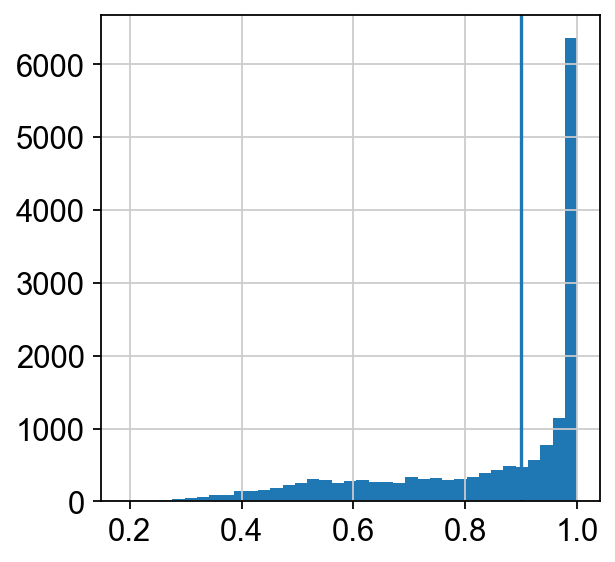

In [369]:
_ = plt.hist(results_df_binary['highest_prob'], bins='auto')
plt.axvline(x=0.9)

In [370]:
results_df_binary['bin'] = pd.qcut(results_df_binary['highest_prob'], q=7)
idx = pd.IntervalIndex(results_df_binary['bin'])
results_df_binary['low'] = idx.left
results_df_binary['high'] = idx.right
results_df_binary['prob range'] = results_df_binary['low'].round(2).astype(str) + "-" + results_df_binary['high'].round(2).astype(str)
df_bins_grouped = results_df_binary[['low','high','prob range']].groupby('prob range').mean().reset_index()
df_bins_grouped

,prob range,low,high
0,0.19-0.58,0.1884,0.5837
1,0.58-0.76,0.5837,0.7585
2,0.76-0.89,0.7585,0.8933
3,0.89-0.97,0.8933,0.9678
4,0.97-0.99,0.9678,0.9944
5,0.99-1.0,0.9944,0.9998
6,1.0-1.0,0.9998,1.0000


In [371]:
cutoff = 0.8
adata_log_ordered.obs['clusterK12_stringent'] = 'other'
adata_log_ordered.obs['clusterK12_stringent'][np.array(results_df_binary['highest_prob'] >= cutoff)] = ["%02d" % y for y in results_df_binary[[x+1 for x in range(0,12)]].idxmax(axis=1)[np.array(results_df_binary['highest_prob'] >= cutoff)].to_numpy()]

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_50885/4020989001.py:3: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata_log_ordered.obs['clusterK12_stringent'][np.array(results_df_binary['highest_prob'] >= cutoff)] = ["%02d" % 

In [372]:
adata_log_ordered.obs['clusterK12_stringent']

AAACCCAGTAGCGTAG-1-14wk-traced-0       03
AAACGAATCAAGTCGT-1-14wk-traced-0    other
AAAGAACAGATGACAT-1-14wk-traced-0    other
AAAGGGCTCACTTGTT-1-14wk-traced-0    other
AAAGGTATCCATAGGT-1-14wk-traced-0       08
                                    ...  
TGTGATTAGCTACTCT-1-1                   05
TGTGCCTCAAGCTTCC-1-1                   05
TGTGCCTCACCAACGA-1-1                   05
TGTGCGCGTTGCATAC-1-1                   09
TGTGCTGGTCTAGAGA-1-1                   05
Name: clusterK12_stringent, Length: 16214, dtype: object

In [373]:
adata_log_ordered.obs['clusterK12_stringent'] = adata_log_ordered.obs['clusterK12_stringent'].astype('category')

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector

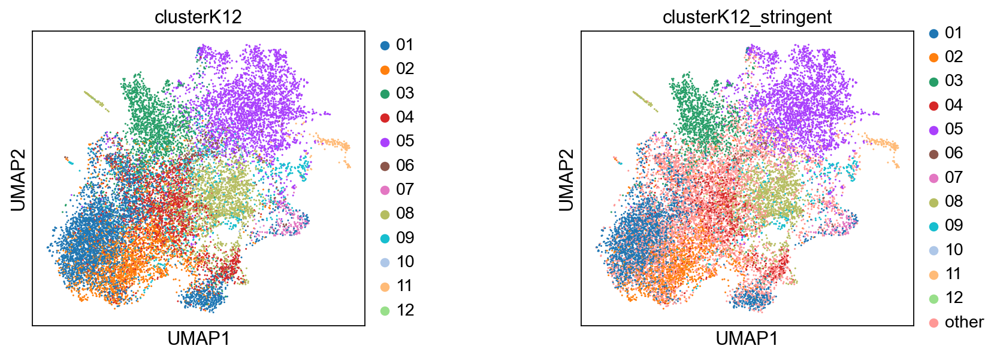

In [374]:
sc.pl.umap(adata_log_ordered, color=['clusterK12', 'clusterK12_stringent'], wspace=0.5)

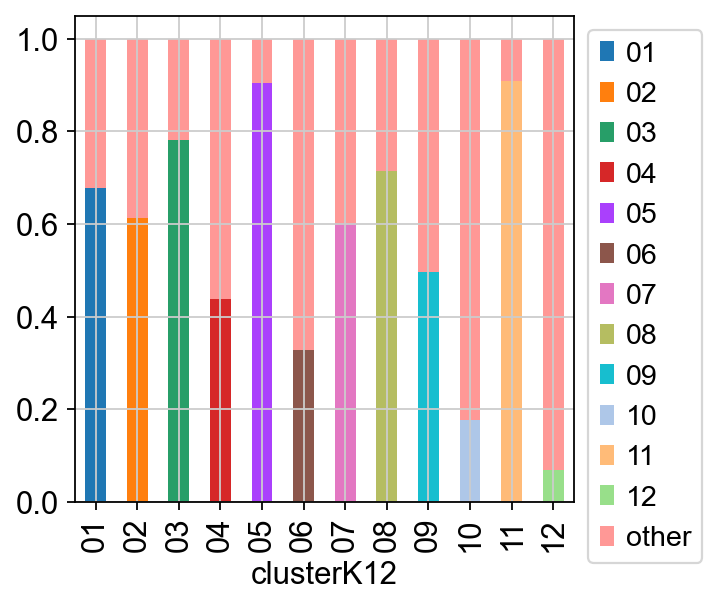

In [375]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['clusterK12_stringent'],adata_log_ordered.obs['clusterK12'],normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

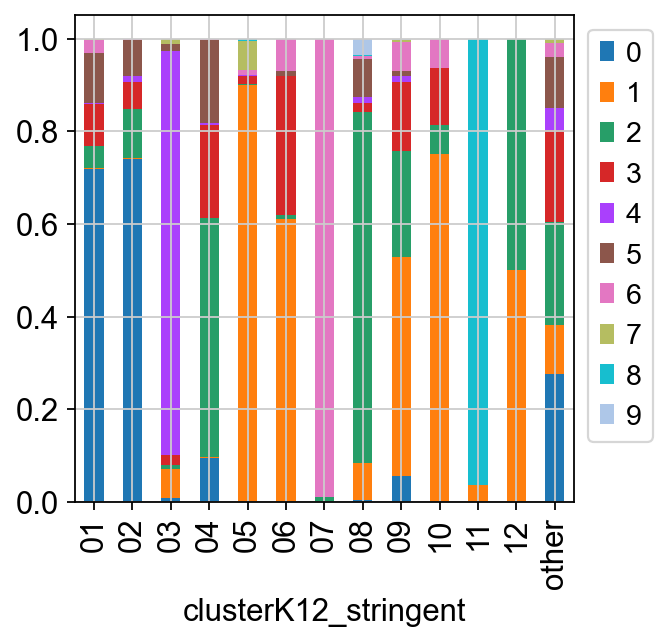

In [376]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['leiden'],adata_log_ordered.obs['clusterK12_stringent'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

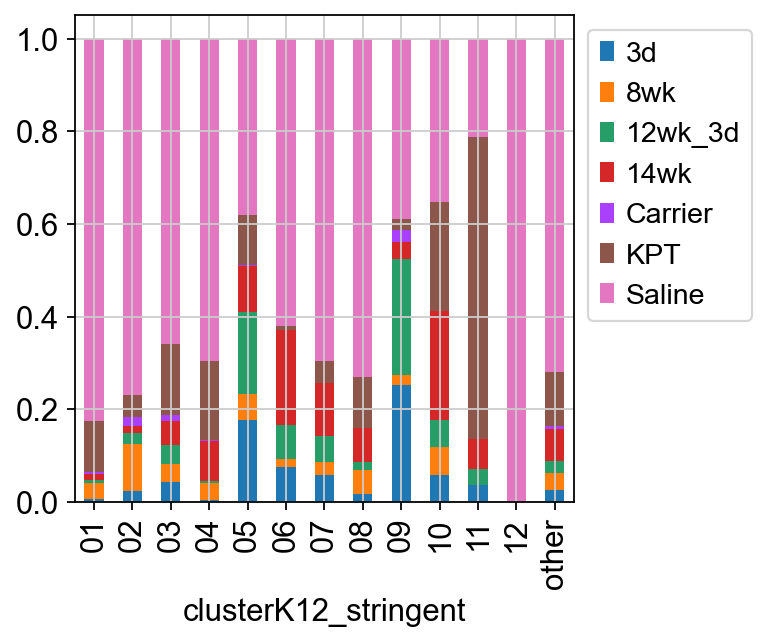

In [377]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['Group'],adata_log_ordered.obs['clusterK12_stringent'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_matrixplot.py:143: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  values_df = self.obs_tidy.groupby(level=0).mean()


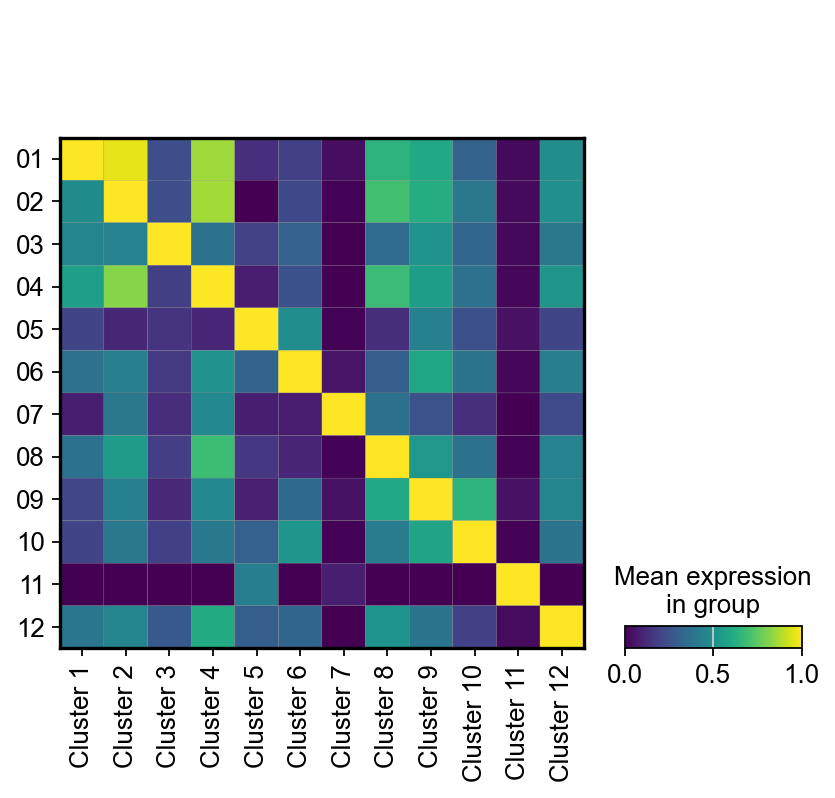

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_matrixplot.py:143: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  values_df = self.obs_tidy.groupby(level=0).mean()


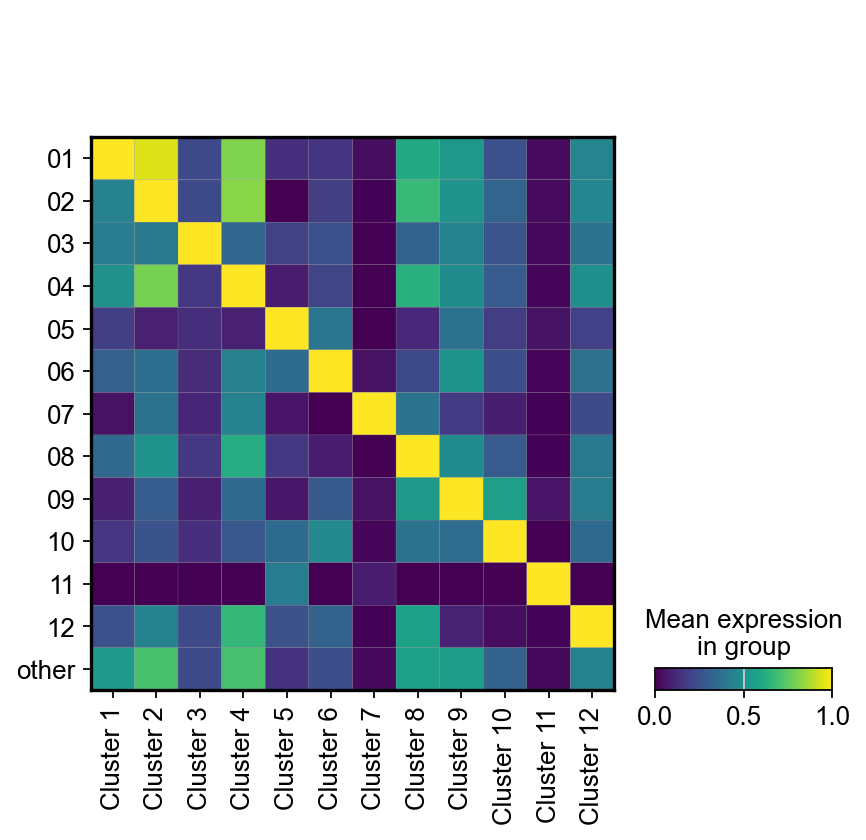

In [378]:
cancerCell = ['Cluster 1', 'Cluster 2','Cluster 3','Cluster 4','Cluster 5','Cluster 6', 'Cluster 7', 
              'Cluster 8', 'Cluster 9', 'Cluster 10', 'Cluster 11', 'Cluster 12']
#cell_proportion_df = pd.crosstab(adata_log_ordered.obs['Cluster 1'],adata_log_ordered.obs['clusterK12']).T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))
sc.pl.matrixplot(adata_log_ordered, cancerCell, 'clusterK12', standard_scale='var')
sc.pl.matrixplot(adata_log_ordered, cancerCell, 'clusterK12_stringent', standard_scale='var')

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


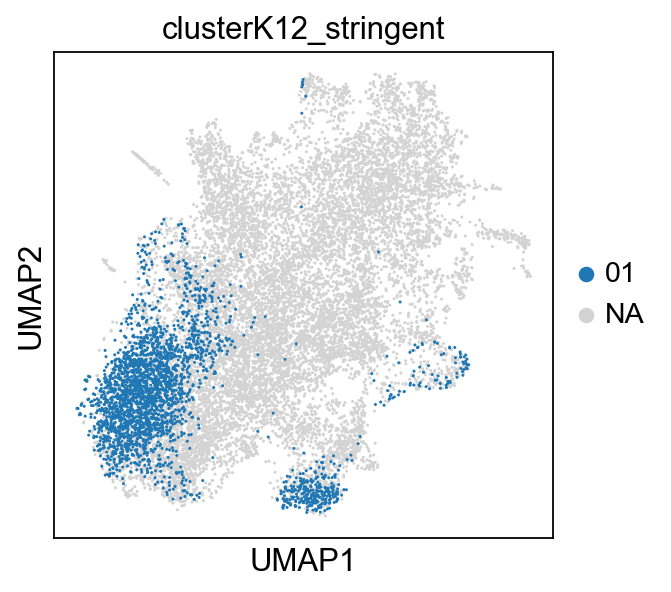

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


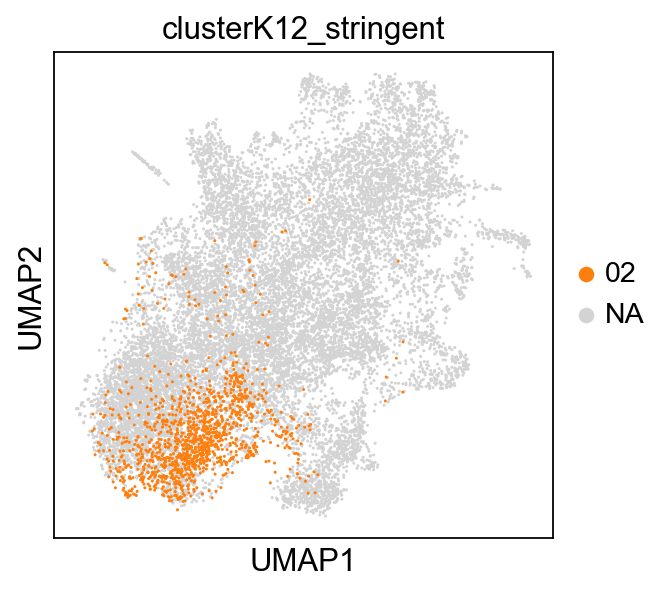

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


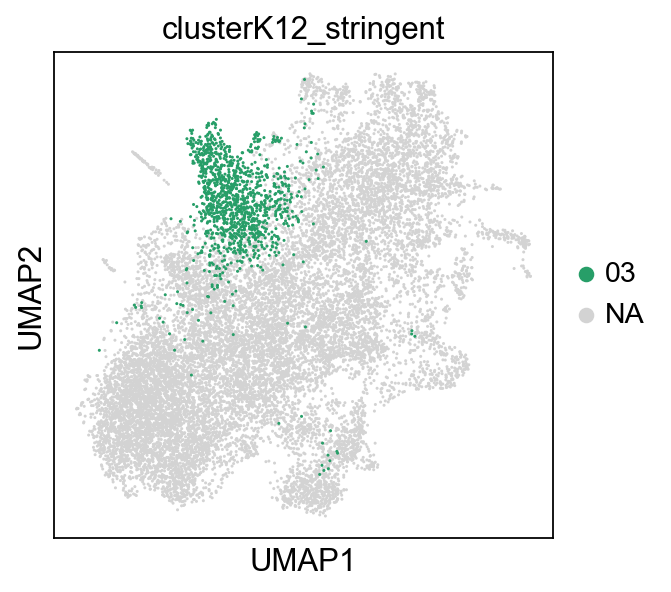

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


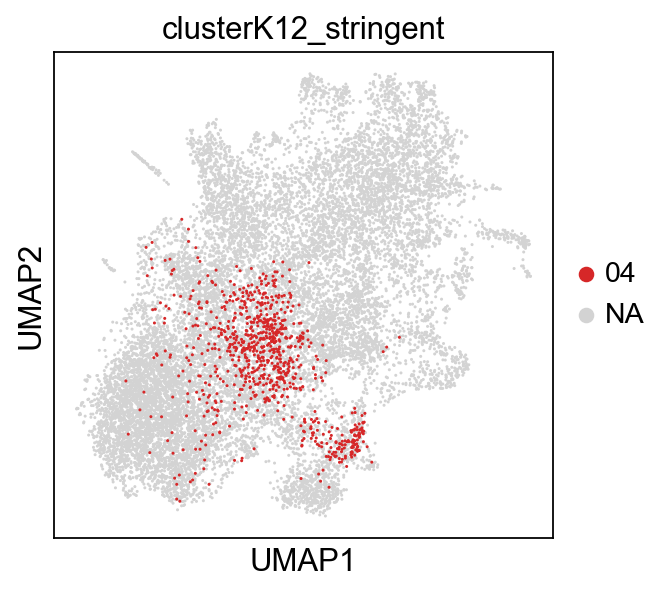

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


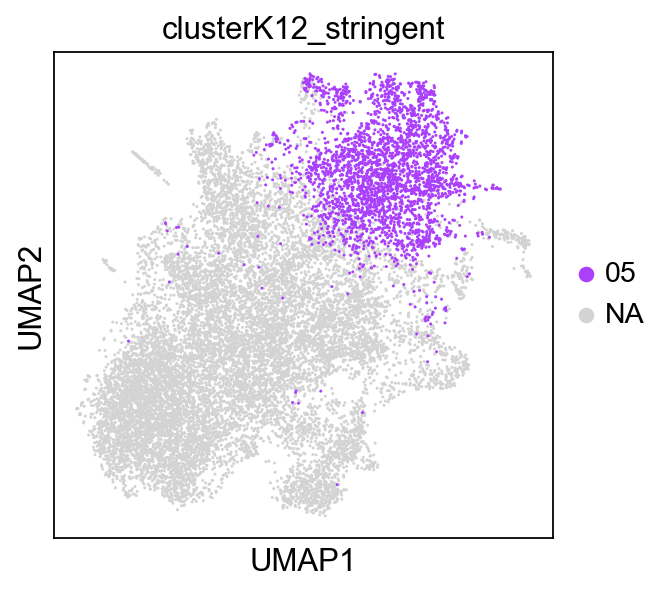

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


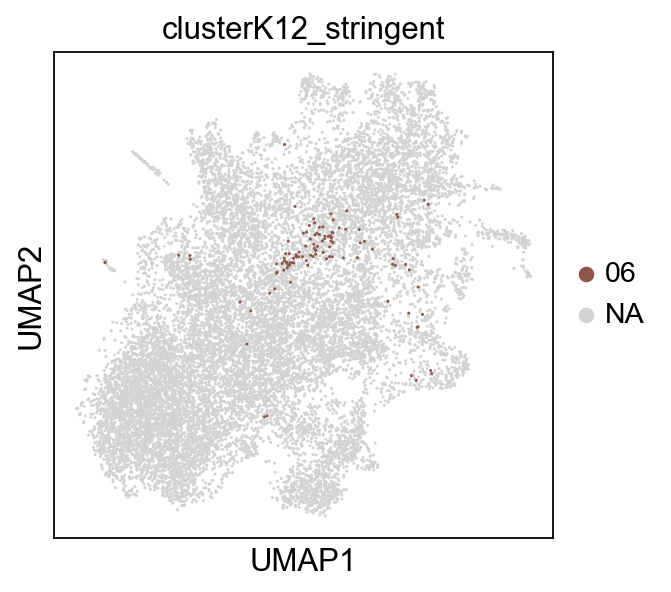

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


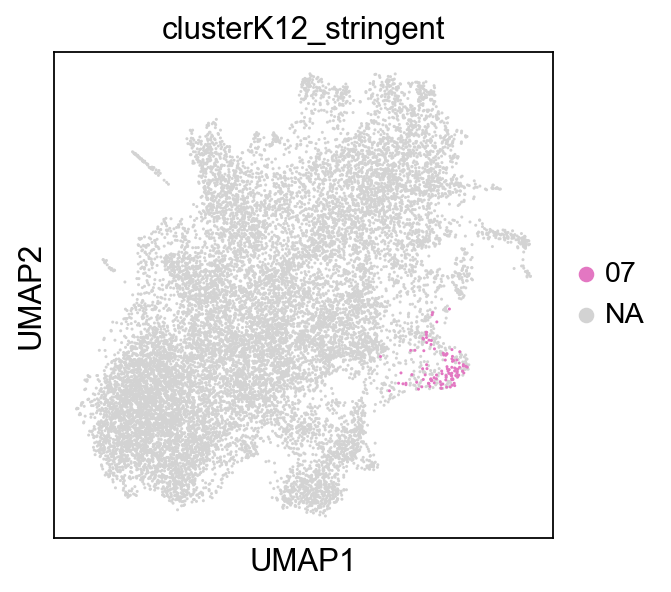

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


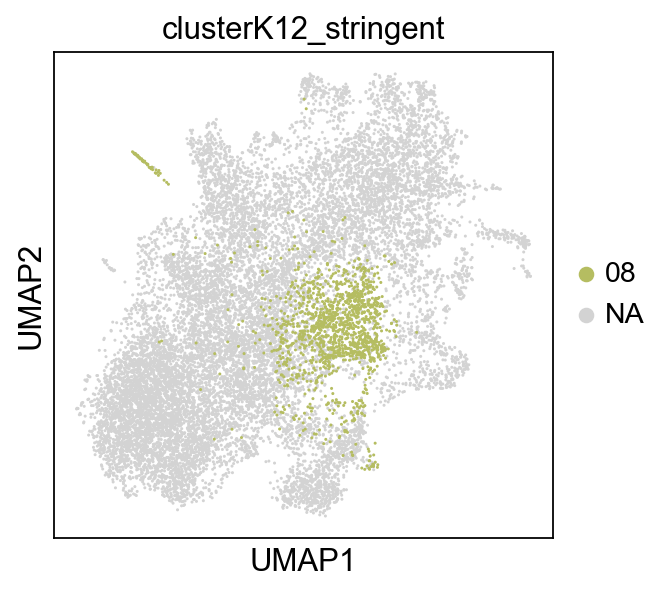

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


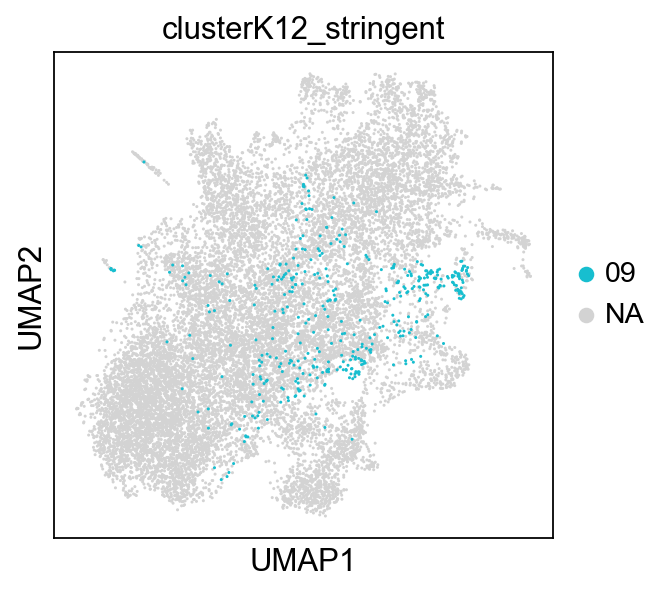

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


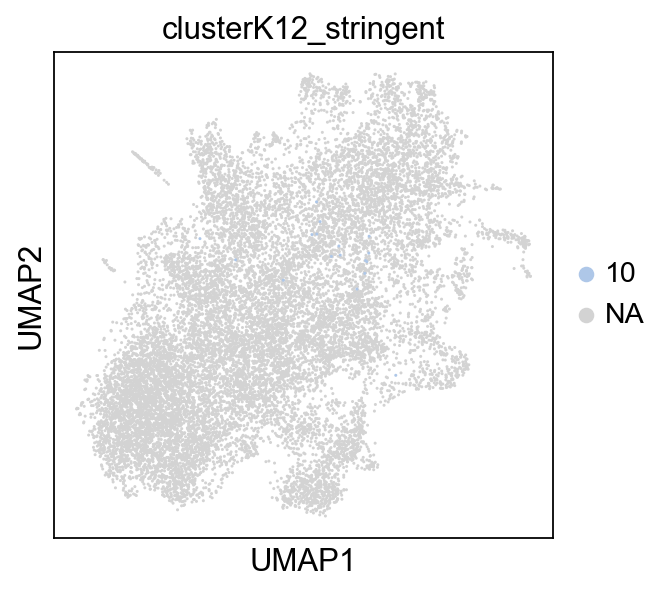

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


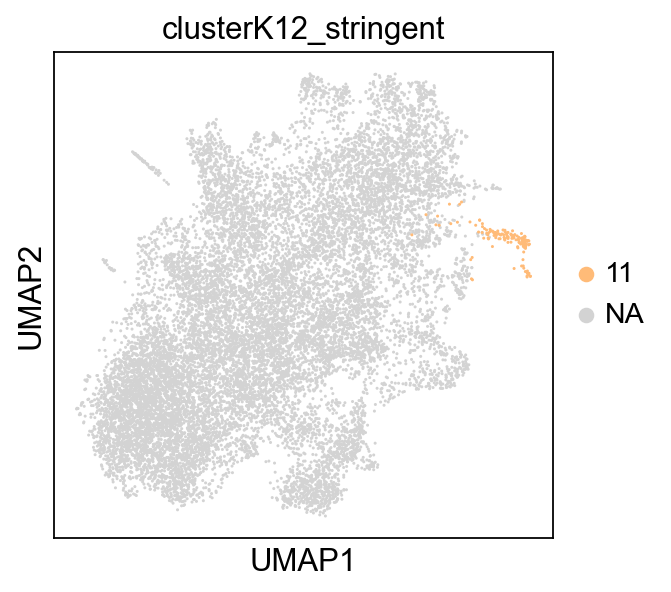

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


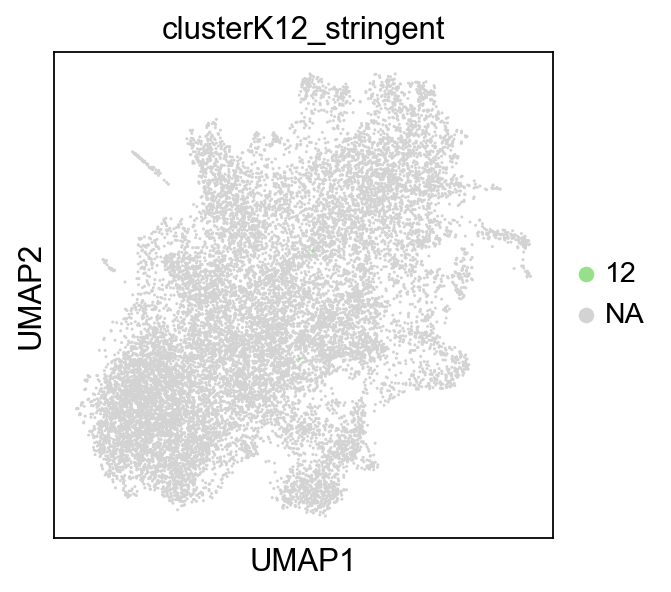

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


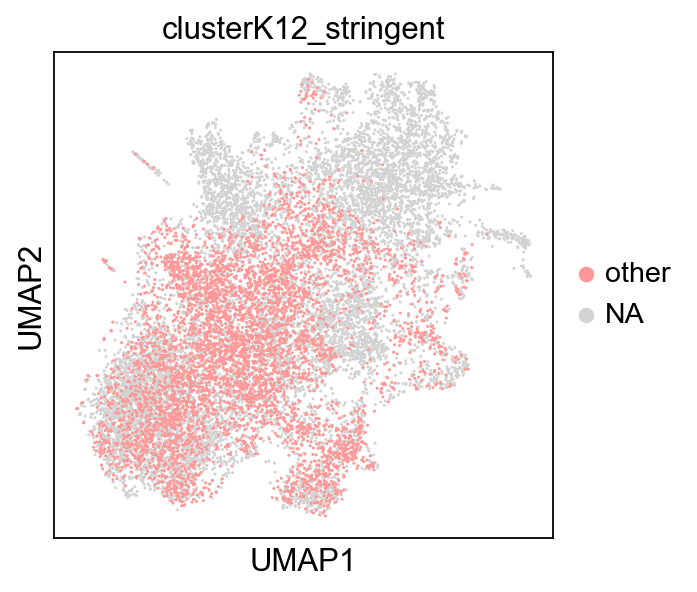

In [379]:
for x in adata_log_ordered.obs.clusterK12_stringent.cat.categories:
    # skip if NA
    sc.pl.umap(adata_log_ordered, color='clusterK12_stringent', groups=[x])

In [380]:
cancerCell = ['Cluster 1', 'Cluster 2','Cluster 3','Cluster 4','Cluster 5','Cluster 6', 'Cluster 7', 
              'Cluster 8', 'Cluster 9', 'Cluster 10', 'Cluster 11', 'Cluster 12']

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_stacked_violin.py:324: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  _color_df = _matrix.groupby(level=0).median()
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_stacked_violin.py:405: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the What's New notes for pandas 2.1.0 for details. Specify future_stack=True to adopt the new implementation and silence this warning.
  pd.DataFrame(_matrix.stack(dropna=False))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_stacked_violin.py:461: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and wil

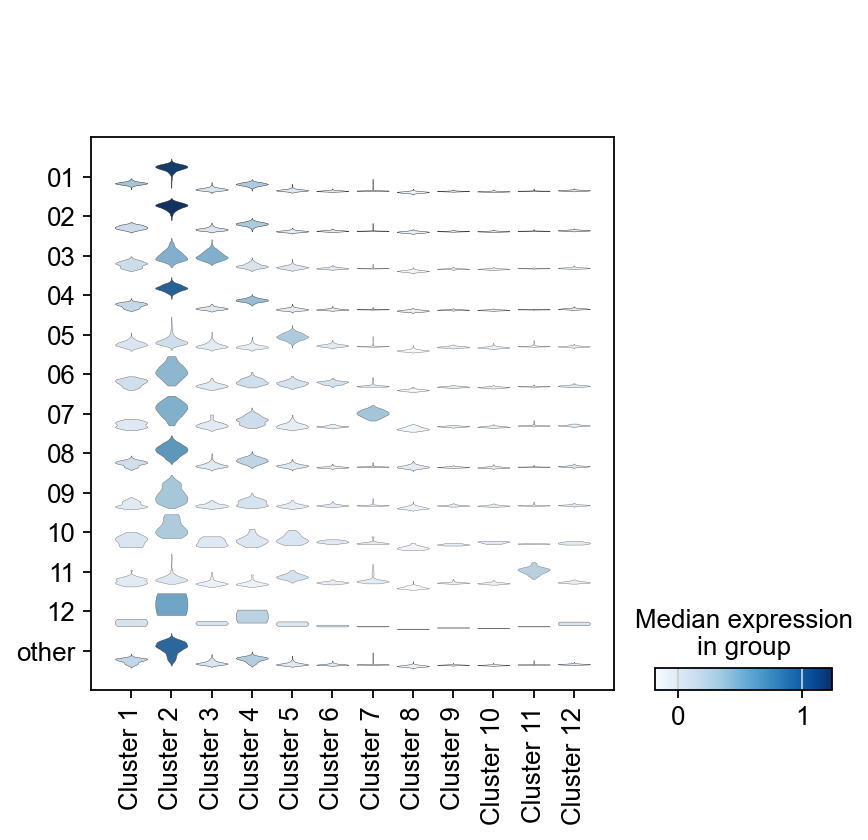

In [381]:
sc.pl.stacked_violin(adata_log_ordered, cancerCell, groupby='clusterK12_stringent')

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will b

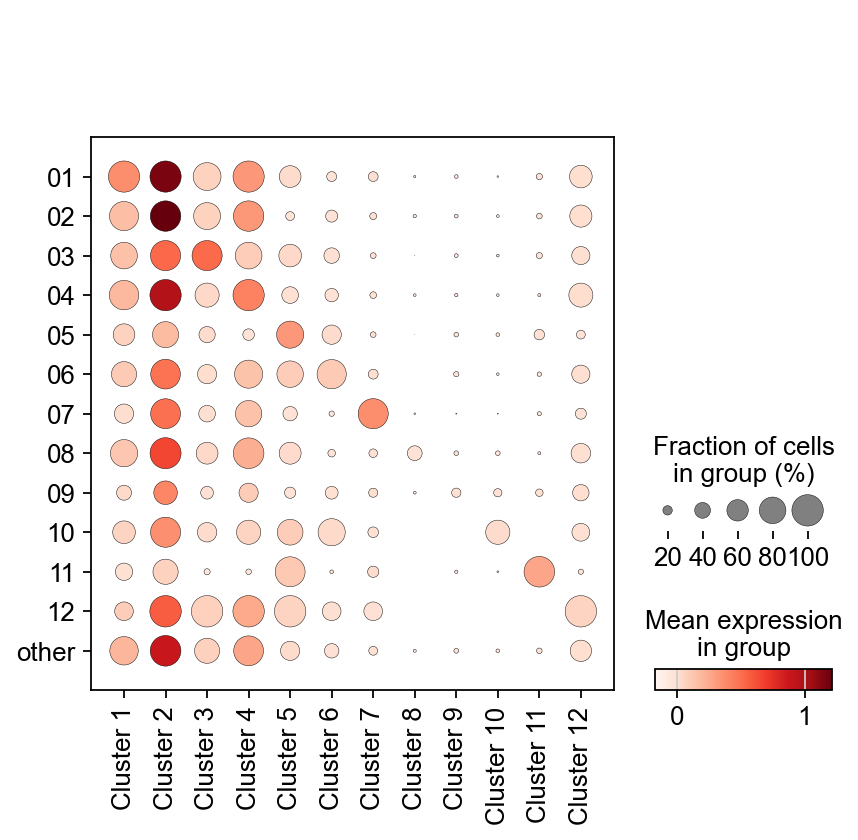

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will b

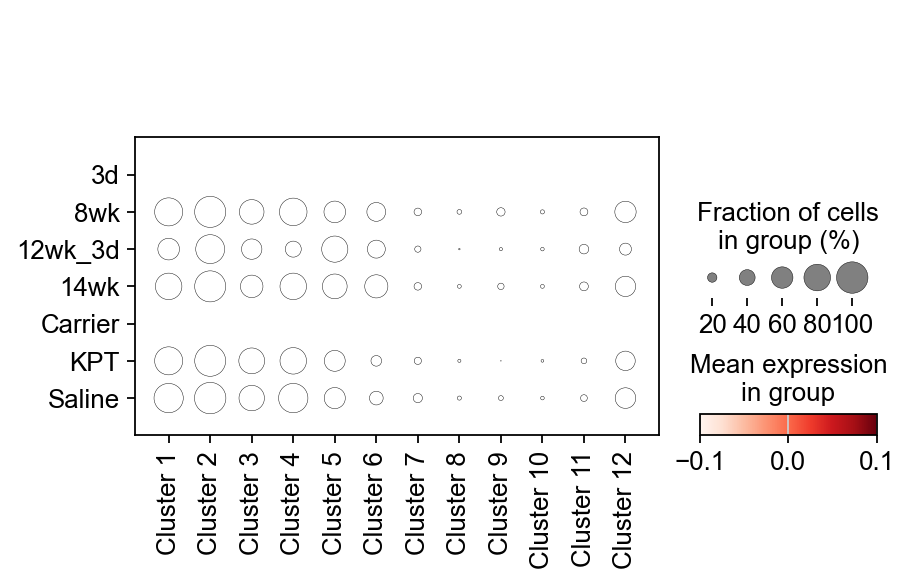

In [382]:
sc.pl.dotplot(adata_log_ordered, [*cancerCell], groupby='clusterK12_stringent')
sc.pl.dotplot(adata_log_ordered, [*cancerCell], groupby='Group')

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_matrixplot.py:143: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  values_df = self.obs_tidy.groupby(level=0).mean()


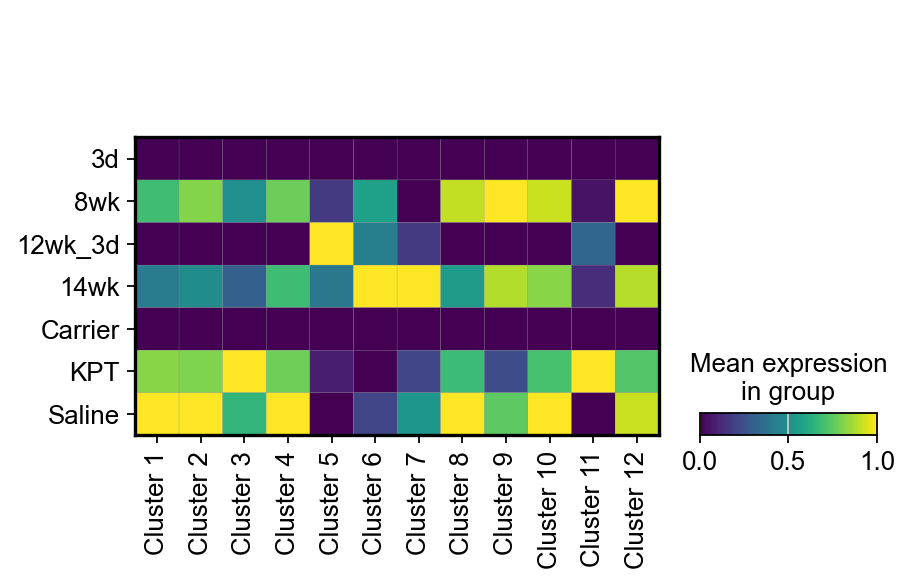

In [383]:
sc.pl.matrixplot(adata_log_ordered, [*cancerCell], groupby='Group',standard_scale='var')
#sc.pl.matrixplot(adata_log_ordered, cancerCell, groupby='Group',standard_scale='var')

In [384]:
adata_concat.obs['clusterK12'] = adata_log_ordered.obs['clusterK12'].astype('category')
adata_concat.obs['clusterK12_stringent'] = adata_log_ordered.obs['clusterK12_stringent'].astype('category')

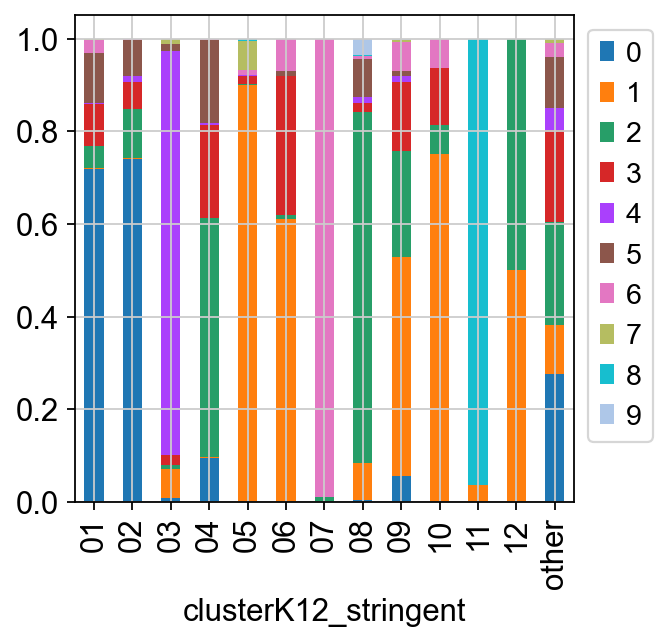

In [385]:
 cell_proportion_df = pd.crosstab(adata_concat.obs['leiden'],adata_log_ordered.obs['clusterK12_stringent'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

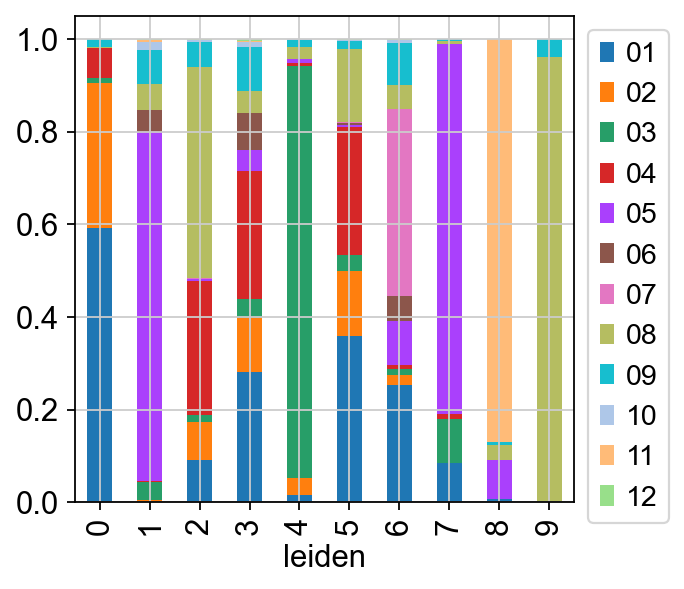

In [386]:
 cell_proportion_df = pd.crosstab(adata_concat.obs['clusterK12'],adata_log_ordered.obs['leiden'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

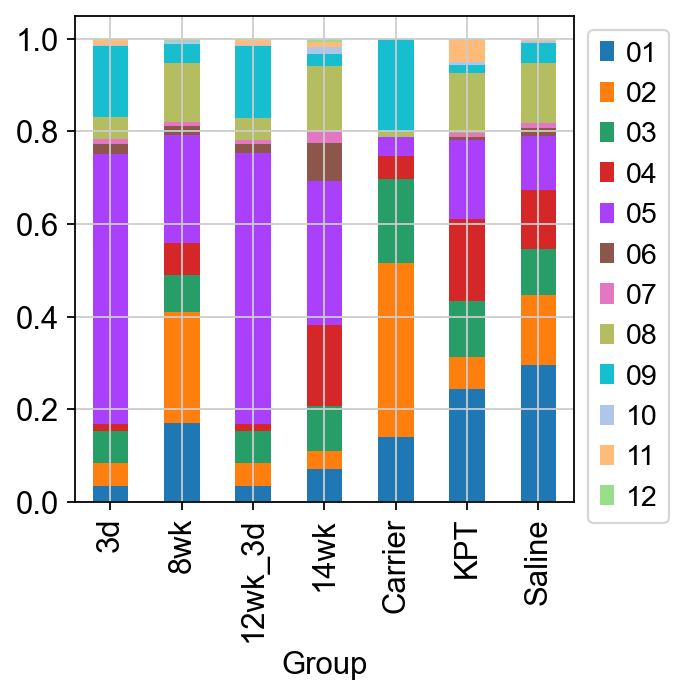

In [387]:
 cell_proportion_df = pd.crosstab(adata_concat.obs['clusterK12'],adata_log_ordered.obs['Group'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector

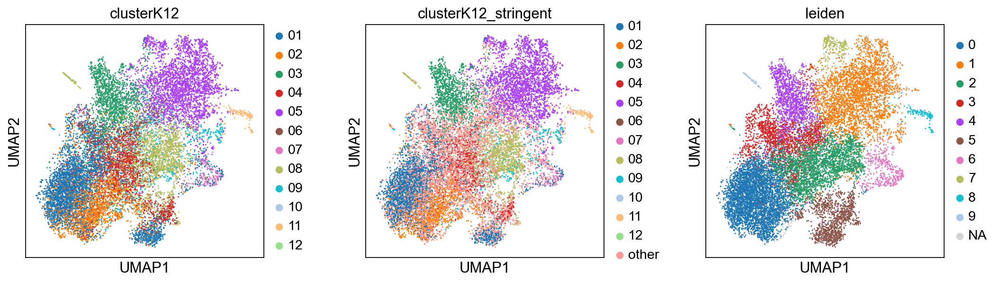

In [388]:
sc.pl.umap(adata_concat, color=['clusterK12', 'clusterK12_stringent','leiden'], wspace=0.3)

### Review Clusters

In [389]:
sc.tl.embedding_density(adata_concat,basis='umap', groupby='clusterK12')

computing density on 'umap'
--> added
    'umap_density_clusterK12', densities (adata.obs)
    'umap_density_clusterK12_params', parameter (adata.uns)


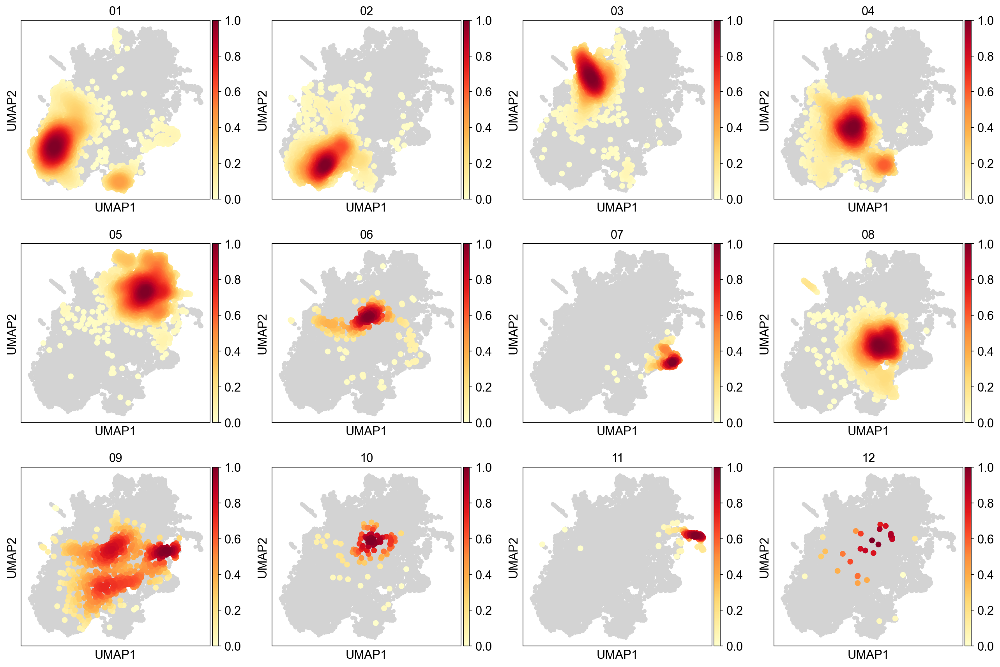

In [390]:
sc.pl.embedding_density(adata_concat,basis='umap',key='umap_density_clusterK12')

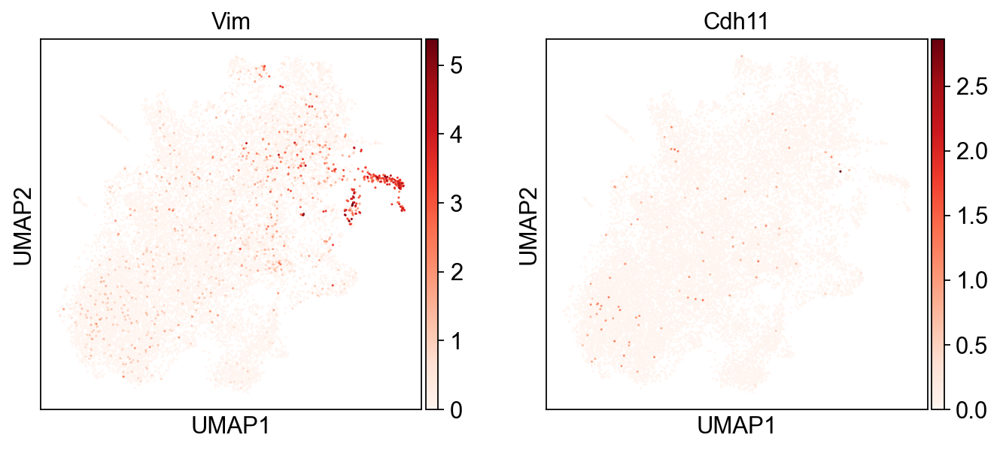

In [392]:
sc.pl.umap(adata_concat, color=['Vim','Cdh11'],cmap='Reds')

### Setup Leiden clustering